In [1]:
import time
import numpy as np
import torch
import torch.nn as nn
import torchvision
from torchvision.models import resnet
import torch.nn.functional as F
import cv2
import torchvision.transforms.functional as TF
from torchvision import transforms as T
import torchvision
from PIL import Image

In [2]:
# Deep network models

from functools import partial

import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import models

nonlinearity = partial(F.relu, inplace=True)


class SPPblock(nn.Module):
    def __init__(self, in_channels):
        super(SPPblock, self).__init__()
        self.pool1 = nn.MaxPool2d(kernel_size=[2, 2], stride=2)
        self.pool2 = nn.MaxPool2d(kernel_size=[3, 3], stride=3)
        self.pool3 = nn.MaxPool2d(kernel_size=[5, 5], stride=5)
        # self.pool4 = nn.MaxPool2d(kernel_size=[6, 6], stride=6)

        self.conv = nn.Conv2d(in_channels=in_channels, out_channels=1, kernel_size=1, padding=0)

    def forward(self, x):
        self.in_channels, h, w = x.size(1), x.size(2), x.size(3)

        self.layer1 = F.upsample(self.conv(self.pool1(x)), size=(h, w), mode="bilinear")
        self.layer2 = F.upsample(self.conv(self.pool2(x)), size=(h, w), mode="bilinear")
        self.layer3 = F.upsample(self.conv(self.pool3(x)), size=(h, w), mode="bilinear")
        # self.layer4 = F.upsample(self.conv(self.pool4(x)), size=(h, w), mode="bilinear")

        out = torch.cat([self.layer1, self.layer2, self.layer3,
                         # self.layer4,
                         x], 1)

        return out


class HDCblock(nn.Module):
    def __init__(self, channel):
        super(HDCblock, self).__init__()
        self.dilate1 = nn.Conv2d(channel, channel, kernel_size=3, dilation=1, padding=1)
        self.dilate2 = nn.Conv2d(channel, channel, kernel_size=3, dilation=2, padding=2)
        self.dilate3 = nn.Conv2d(channel, channel, kernel_size=3, dilation=4, padding=4)
        # self.dilate4 = nn.Conv2d(channel, channel, kernel_size=3, dilation=8, padding=8)
        # self.dilate5 = nn.Conv2d(channel, channel, kernel_size=3, dilation=16, padding=16)
        for m in self.modules():
            if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
                if m.bias is not None:
                    m.bias.data.zero_()

    def forward(self, x):
        dilate1_out = nonlinearity(self.dilate1(x))
        dilate2_out = nonlinearity(self.dilate2(dilate1_out))
        dilate3_out = nonlinearity(self.dilate3(dilate2_out))
        # dilate4_out = nonlinearity(self.dilate4(dilate3_out))
        # dilate5_out = nonlinearity(self.dilate5(dilate4_out))
        out = x + dilate1_out + dilate2_out + dilate3_out  # + dilate4_out + dilate5_out

        return out


class DecoderBlock(nn.Module):
    def __init__(self, in_channels, n_filters):
        super(DecoderBlock, self).__init__()

        self.conv1 = nn.Conv2d(in_channels, in_channels // 4, 1)
        self.norm1 = nn.BatchNorm2d(in_channels // 4)
        self.relu1 = nonlinearity

        self.deconv2 = nn.ConvTranspose2d(in_channels // 4, in_channels // 4, 3, stride=2, padding=1, output_padding=1)
        self.norm2 = nn.BatchNorm2d(in_channels // 4)
        self.relu2 = nonlinearity

        self.conv3 = nn.Conv2d(in_channels // 4, n_filters, 1)
        self.norm3 = nn.BatchNorm2d(n_filters)
        self.relu3 = nonlinearity

    def forward(self, x):
        x = self.conv1(x)
        x = self.norm1(x)
        x = self.relu1(x)
        x = self.deconv2(x)
        x = self.norm2(x)
        x = self.relu2(x)
        x = self.conv3(x)
        x = self.norm3(x)
        x = self.relu3(x)

        return x


class DPLinkNet34(nn.Module):
    def __init__(self, num_classes=1):
        super(DPLinkNet34, self).__init__()

        filters = [64, 128, 256, 512]
        resnet = models.resnet34(pretrained=True)
        self.firstconv = resnet.conv1
        self.firstbn = resnet.bn1
        self.firstrelu = resnet.relu
        self.firstmaxpool = resnet.maxpool
        self.encoder1 = resnet.layer1
        self.encoder2 = resnet.layer2
        self.encoder3 = resnet.layer3
        self.encoder4 = resnet.layer4

        self.dblock = HDCblock(filters[3])
        self.spp = SPPblock(filters[3])

        self.decoder4 = DecoderBlock(filters[3] + 3, filters[2])
        self.decoder3 = DecoderBlock(filters[2], filters[1])
        self.decoder2 = DecoderBlock(filters[1], filters[0])
        self.decoder1 = DecoderBlock(filters[0], filters[0])

        self.finaldeconv1 = nn.ConvTranspose2d(filters[0], 32, 4, 2, 1)
        self.finalrelu1 = nonlinearity
        self.finalconv2 = nn.Conv2d(32, 32, 3, padding=1)
        self.finalrelu2 = nonlinearity
        self.finalconv3 = nn.Conv2d(32, num_classes, 3, padding=1)

    def forward(self, x_inp):
        # Encoder
        x = self.firstconv(x_inp)
        x = self.firstbn(x)
        x = self.firstrelu(x)
        x = self.firstmaxpool(x)
        e1 = self.encoder1(x)
        e2 = self.encoder2(e1)
        e3 = self.encoder3(e2)
        e4 = self.encoder4(e3)

        # Center
        e4 = self.dblock(e4)
        e4 = self.spp(e4)

        # Decoder
        temp =self.decoder4(e4)
        if temp.shape != e3.shape:
            temp=TF.resize(temp,size=e3.shape[2:])
        d4 = temp + e3
        temp= self.decoder3(d4)
        if temp.shape != e2.shape:
            temp=TF.resize(temp,size=e2.shape[2:])

        d3 = temp + e2
        temp=self.decoder2(d3)
        if temp.shape != e1.shape:
            temp=TF.resize(temp,e1.shape[2:])
        
            
        d2 = temp + e1
        d1 = self.decoder1(d2)

        out = self.finaldeconv1(d1)
        out = self.finalrelu1(out)
        out = self.finalconv2(out)

        out = self.finalrelu2(out)
        
        out = self.finalconv3(out)

        if out.shape != x_inp.shape:
            out=TF.resize(out,x_inp.shape[2:])

        return out


In [3]:
model_dplinknet=DPLinkNet34(num_classes=1)
inp=torch.rand(1,3,450,448)
out=model_dplinknet(inp)

C:\Users\Rehan\anaconda3\envs\pytorch\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\Rehan\anaconda3\envs\pytorch\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
C:\Users\Rehan\anaconda3\envs\pytorch\lib\site-packages\torch\nn\functional.py:3737: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
C:\Users\Rehan\anaconda3\envs\pytorch\lib\site-packages\torchvision\transf

In [7]:

def get_device():
    return "cpu" if torch.cuda.is_available() else "cpu"
class ImgToTensor(object):
    def __call__(self, img):
        tf = T.Compose([T.ToTensor(),                                                                                    
])
        return tf(img)


class MaskToTensor(object):
    def __call__(self, img):
        return torch.from_numpy(img).long()

 
# def patch_pred_total(model,device,img1):   
#         patches,patch_locs=get_img_patches(img1)
#         patch_totensor=ImgToTensor()
#         preds=[]
#         for i in patches:
#             i=patch_totensor(Image.fromarray(i))
#             i=(i.unsqueeze(0)).to(device, dtype=torch.float32)
#         #     msk_pred=model(i)
#             msk_pred = torch.sigmoid(model(i)) 
#             msk_pred=(msk_pred>0.6).float()# torch.Size([1, 1, 256, 256])
#             mask = msk_pred.cpu().detach().numpy()[0, 0] 
#         #     plt.imshow(mask,cmap='gray')
#         #     plt.show()
#             preds.append(mask)
        
#         mskp= merge_pred_patches(img1, preds, patch_locs)
#         kernel = np.array(
#                 [
#                     [0, 0, 1, 0, 0],
#                     [0, 1, 1, 1, 0],
#                     [1, 1, 1, 1, 1],
#                     [0, 1, 1, 1, 0],
#                     [0, 0, 1, 0, 0],
#                 ], dtype=np.uint8)
#         # plt.imshow(mskp,cmap='gray')
#         # plt.show()
#         mskp = cv2.morphologyEx(mskp, cv2.MORPH_CLOSE, kernel,iterations=1).astype(float)
#         return mskp
# def crack_pred(file_path,model_path,model):
#     img1=cv2.imread(file_path)
#     img1=cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)
#     #model_path='model_scripted.pt'
#     model_path=model_path
#     device=get_device()
#     #print(device)
#     # model = LinkNet()
#     model.to(device)
#     model.load_state_dict(torch.load(model_path, map_location=device))
#     #model=torch.jit.load(model_path,map_location=device)
#     model.eval()
#     out=patch_pred_total(model,device,img1)
#     img_copy=img1.copy()
#     img_copy[out>0] = [0,0,255]
#     cv2.imwrite("output.jpg",img_copy)
#     return 1

    #print("Elapsed Time for the model Running is : ",elapsed_time)
    #print(os.getcwd())
    
    

In [8]:
device=get_device()
model_dplinknet=DPLinkNet34(num_classes=1)
model_path="best_dp_bam.pth"
model_dplinknet.load_state_dict(torch.load(model_path,map_location='cpu'))
model_dplinknet.eval()
model_dplinknet.to(device)

DPLinkNet34(
  (firstconv): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (firstbn): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (firstrelu): ReLU(inplace=True)
  (firstmaxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (encoder1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (rel

In [17]:
import matplotlib.pyplot as plt
def without_patches(path,model):

    target_size=[700,896]
    img1=cv2.imread(path)
    img1=cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)
    img_copy=img1.copy()
    print(img1.shape)
    aspect_ratio = img1.shape[1] / img1.shape[0]
    new_height = int(target_size[1])
    new_width = int(target_size[0] * aspect_ratio)
    # if img1.shape[0]>900 or img1.shape[1]>900:
    #     
    img1 = cv2.resize(img1, (new_width, new_height))
    print(img1.shape)
    #model_path='model_scripted.pt'
    # model_path='best_dp_bam.pth'
    device=get_device()
    #print(device)
    model = model
    model.to(device)
    
    # model.load_state_dict(torch.load(model_path, map_location=device))
    model.eval()
    to_tensor=ImgToTensor()
    img2=to_tensor(Image.fromarray(img1))
    img2=(img2.unsqueeze(0)).to(device, dtype=torch.float32)

    msk_pred = torch.sigmoid(model(img2)) 
    msk_pred=(msk_pred>0.6).float()# torch.Size([1, 1, 256, 256])
    mask = msk_pred.cpu().detach().numpy()[0, 0]

    if img2.shape != mask.shape:
            mask = np.resize(mask, (img1.shape[0],mask.shape[1]))

    mask = cv2.resize(mask, (img_copy.shape[1], img_copy.shape[0]))
 

    img_copy[mask>0] = [255,0,0]
    

    return img_copy

(1600, 1200, 3)
(896, 525, 3)


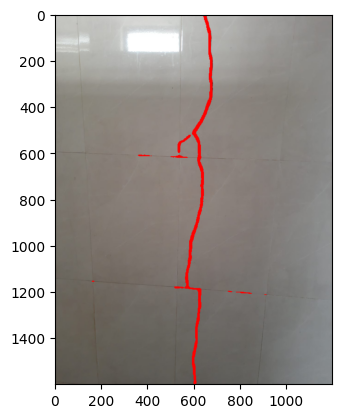

In [19]:
path='big_image3.jpg'
out=without_patches(path,model_dplinknet)
plt.imshow(out)

Frames Executing:
torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


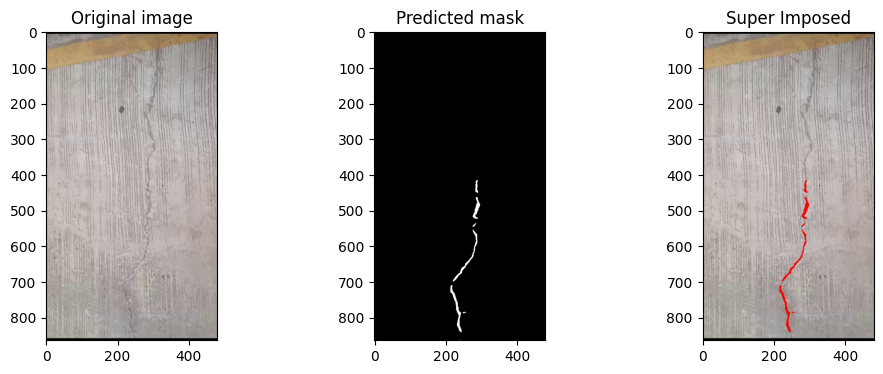

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


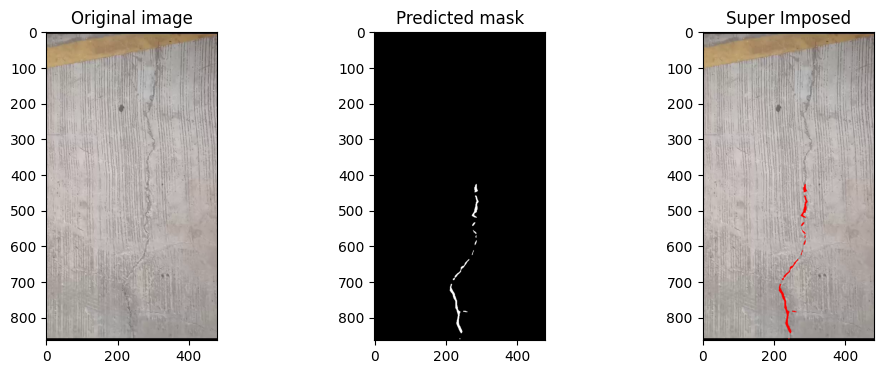

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


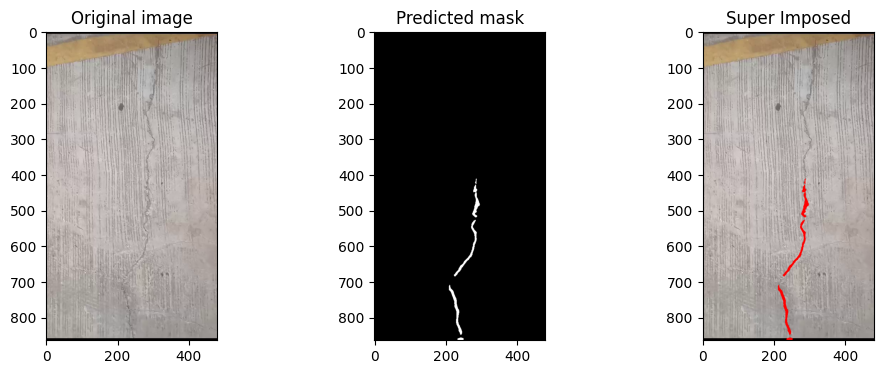

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


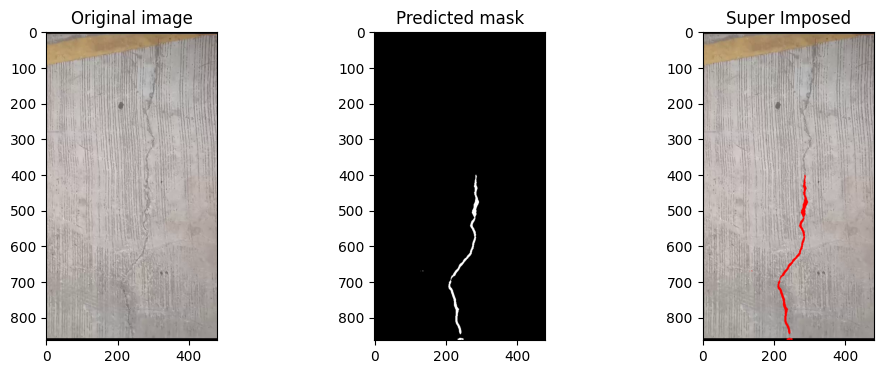

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


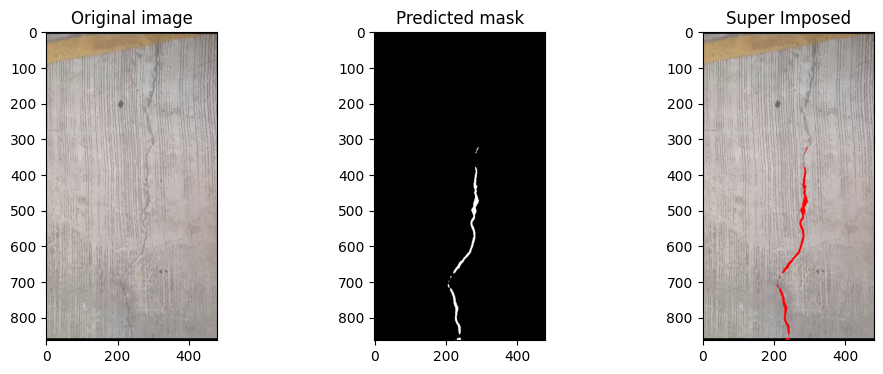

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


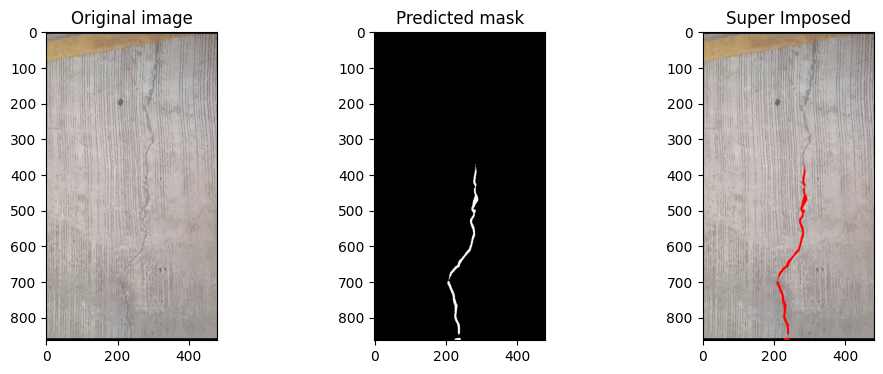

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


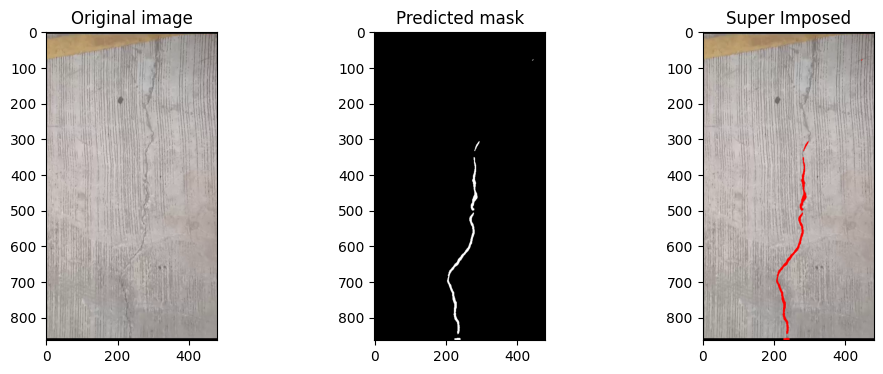

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


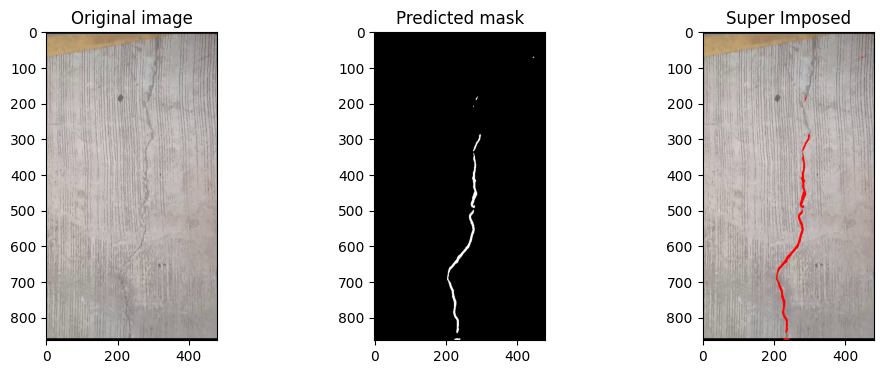

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


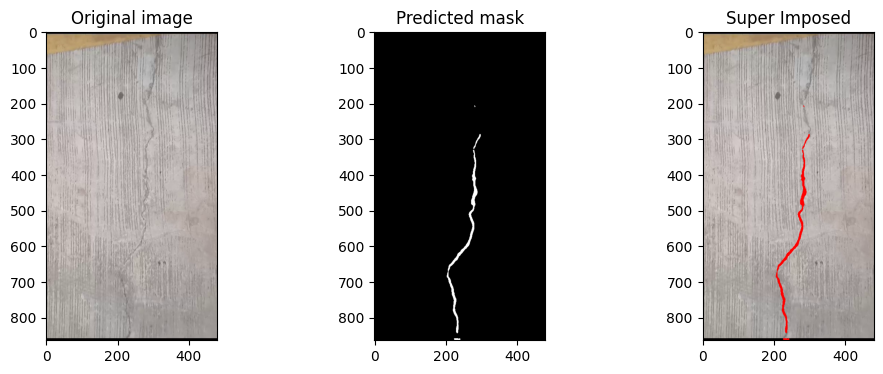

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


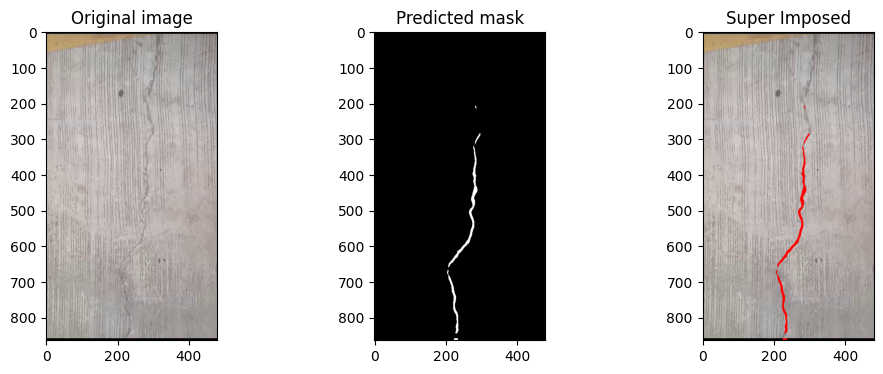

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


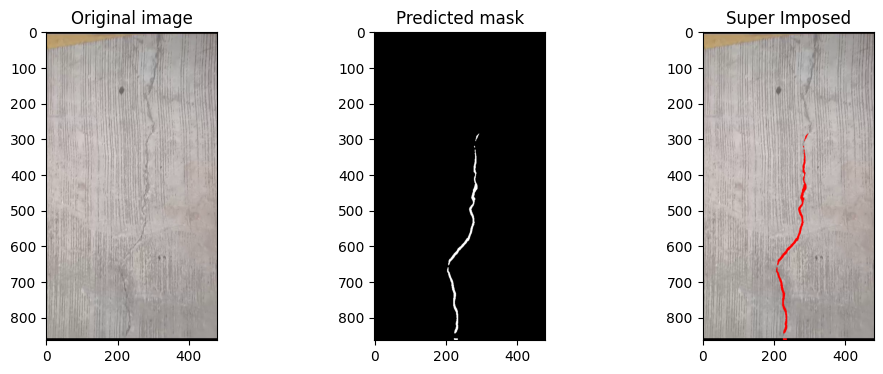

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


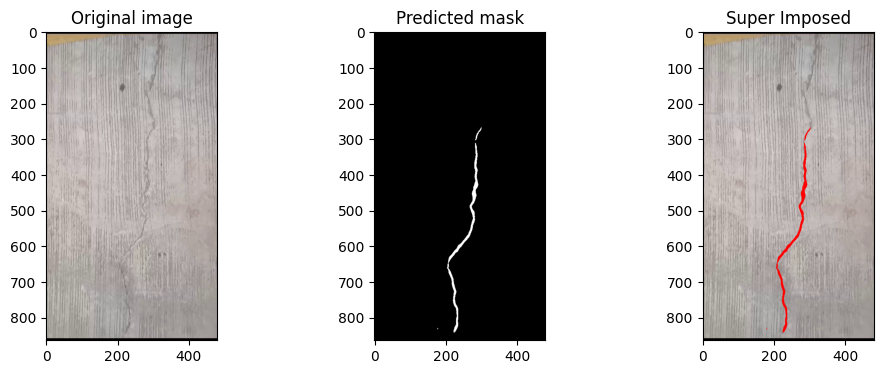

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


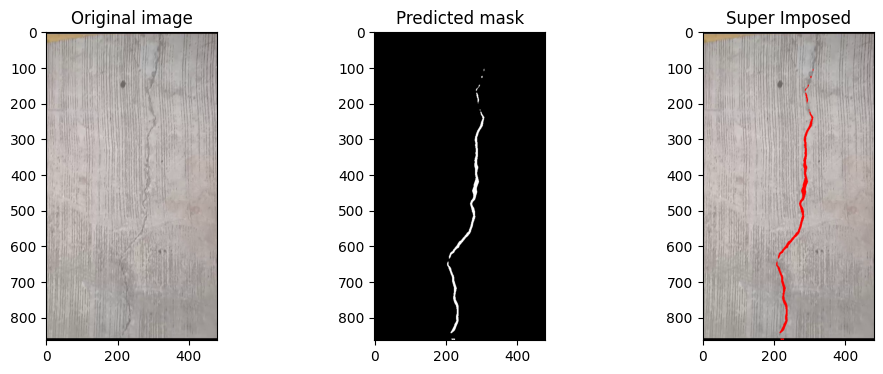

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


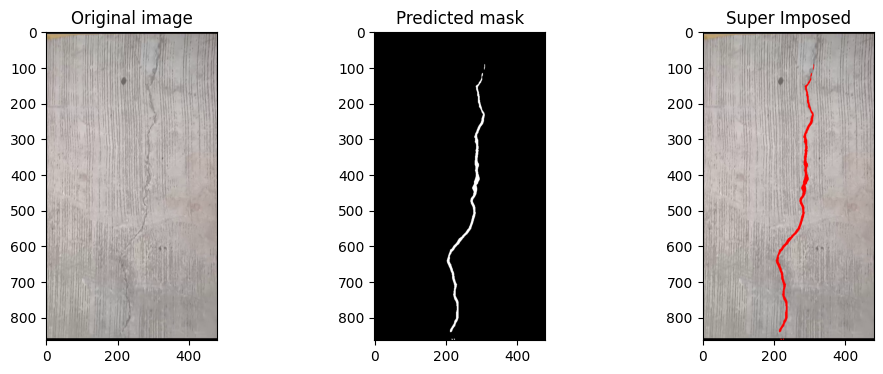

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


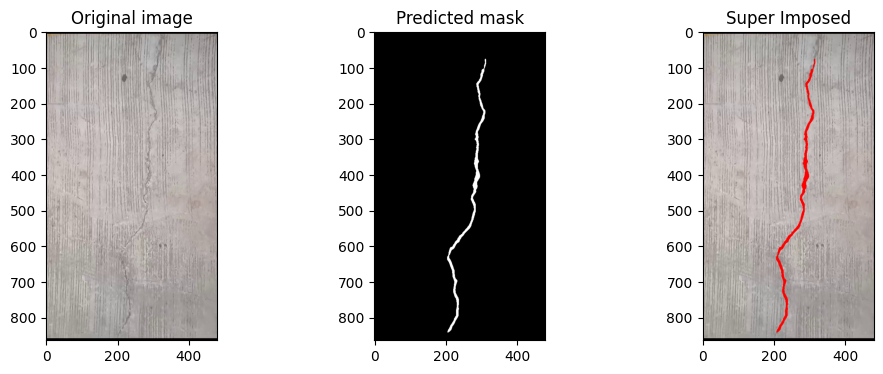

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


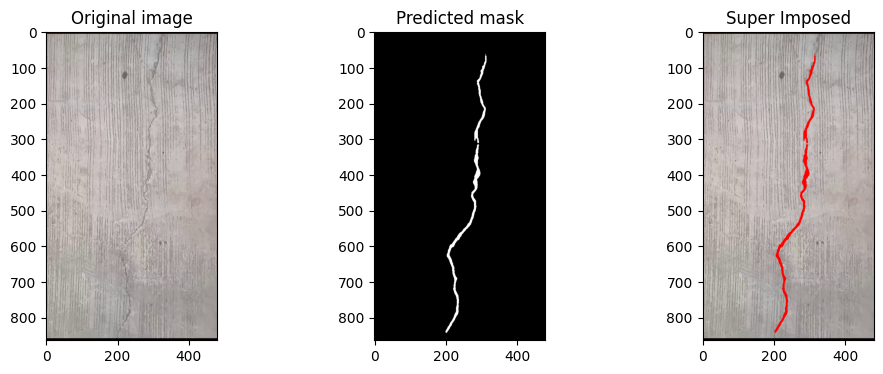

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


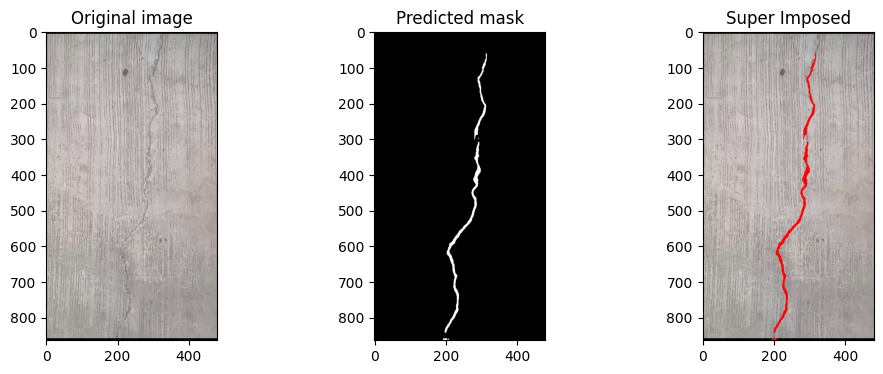

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


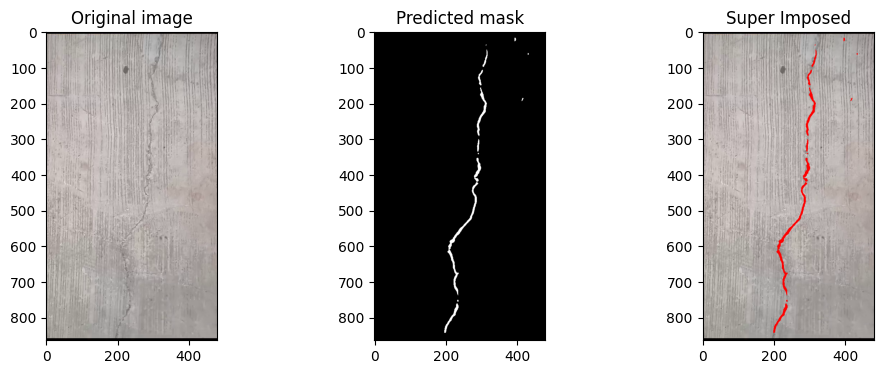

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


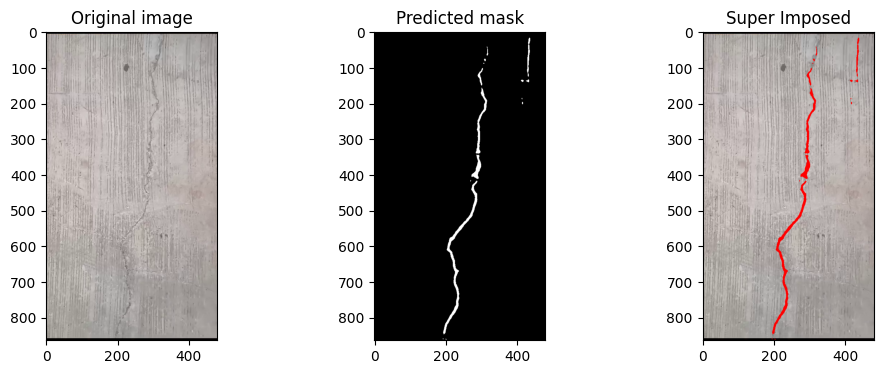

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


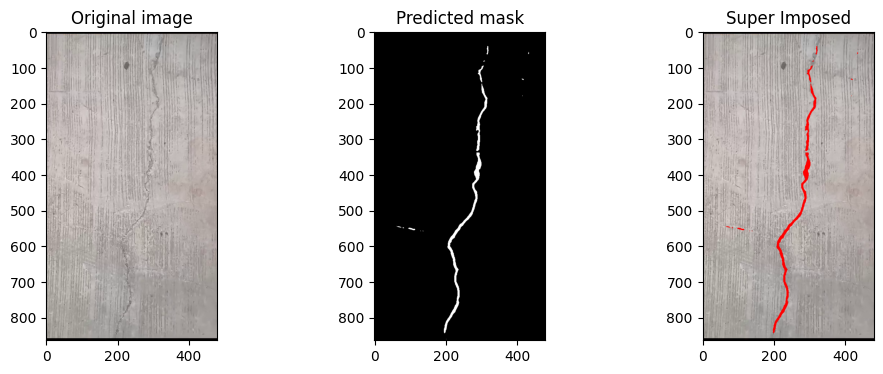

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


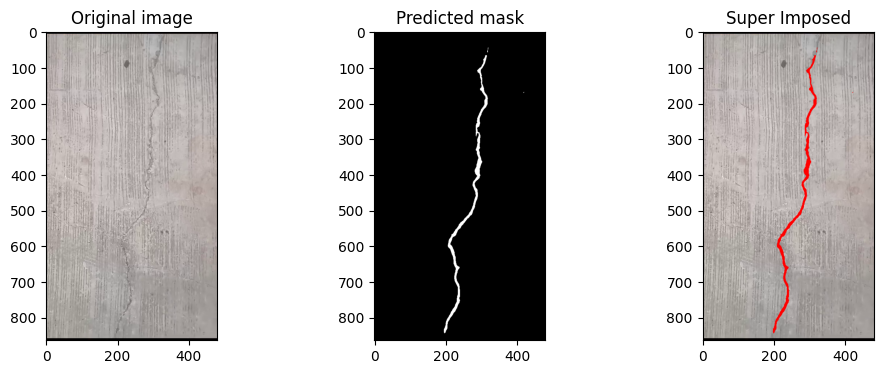

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


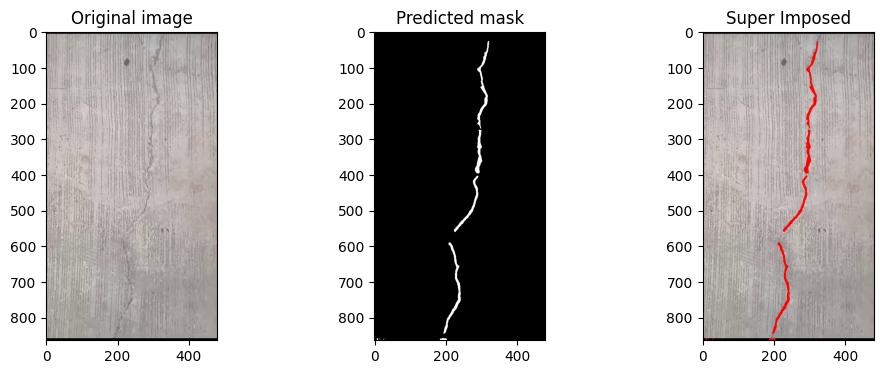

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


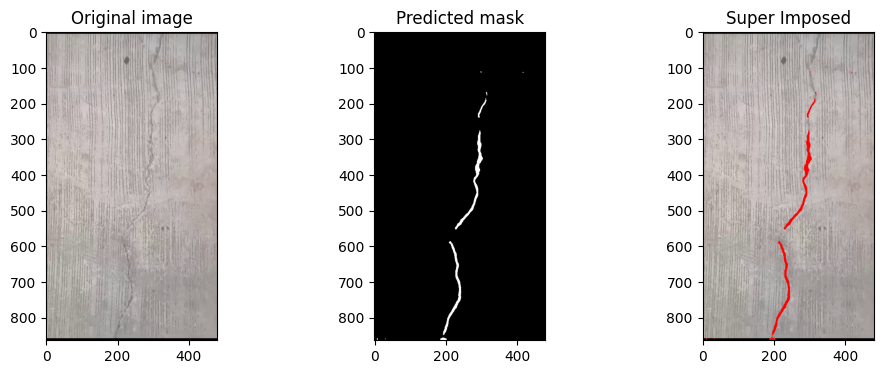

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


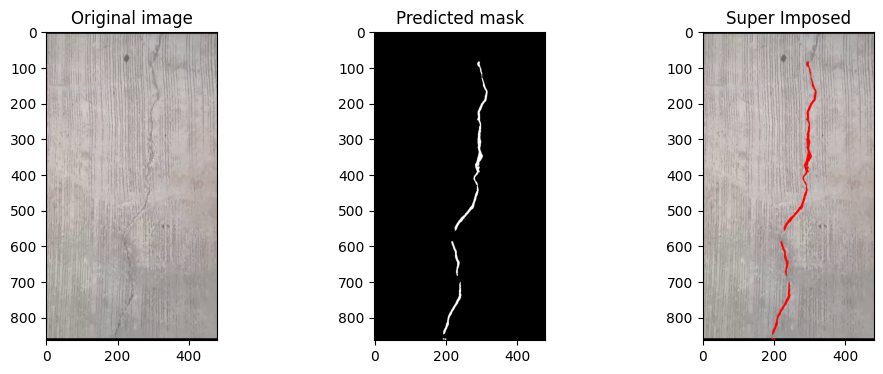

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


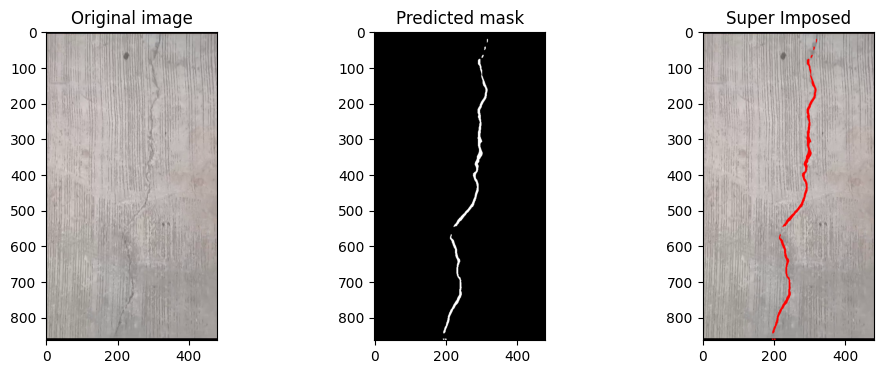

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


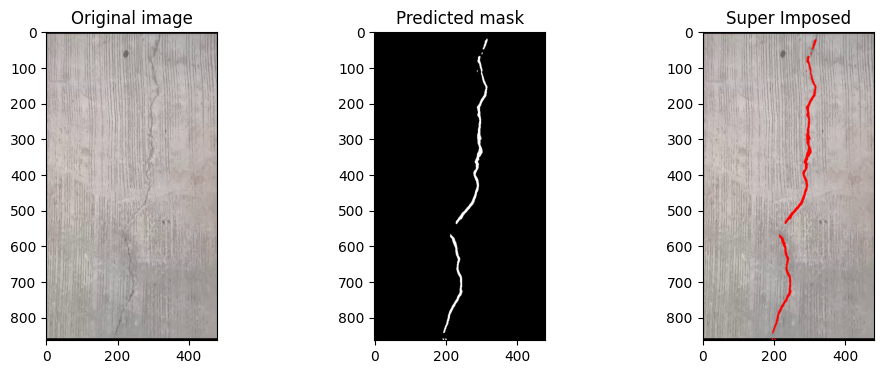

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


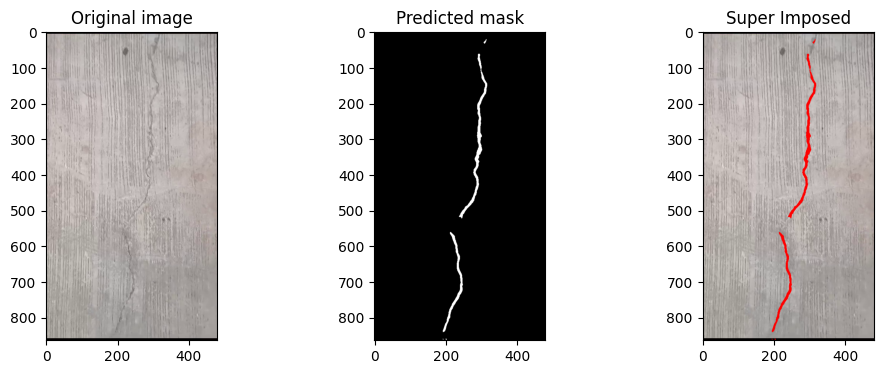

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


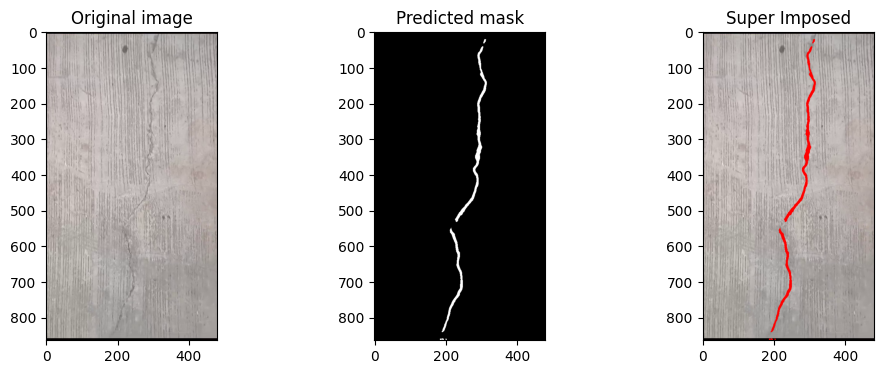

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


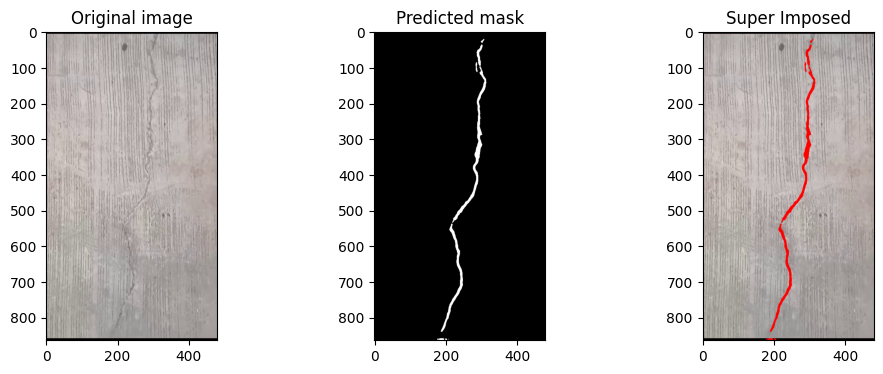

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


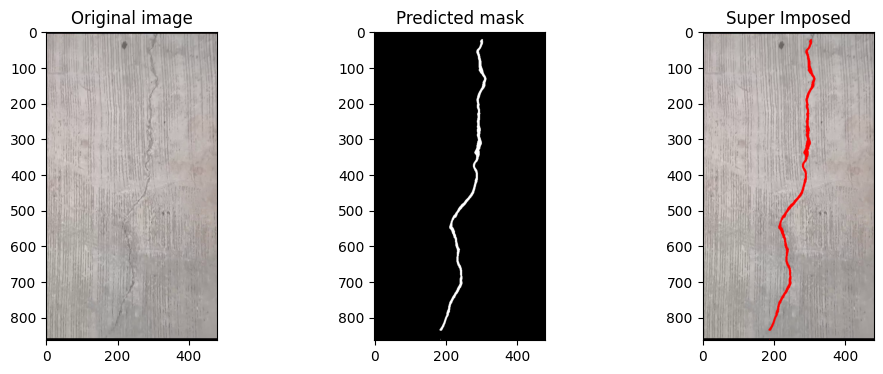

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


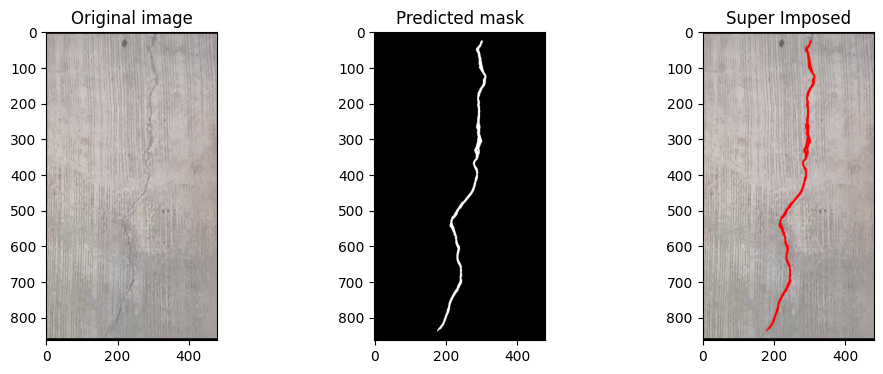

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


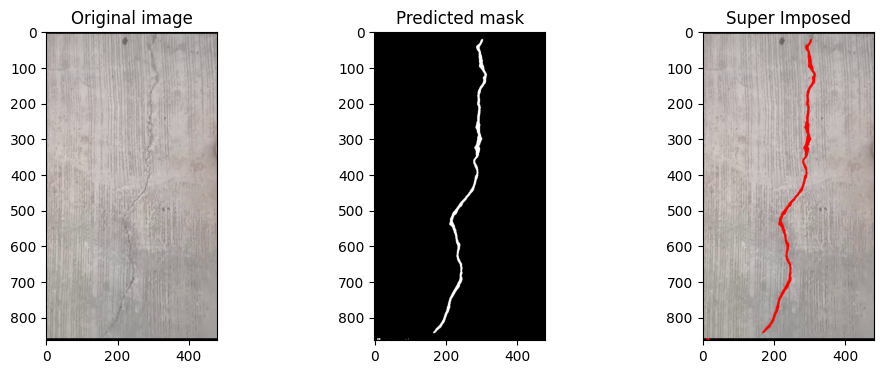

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


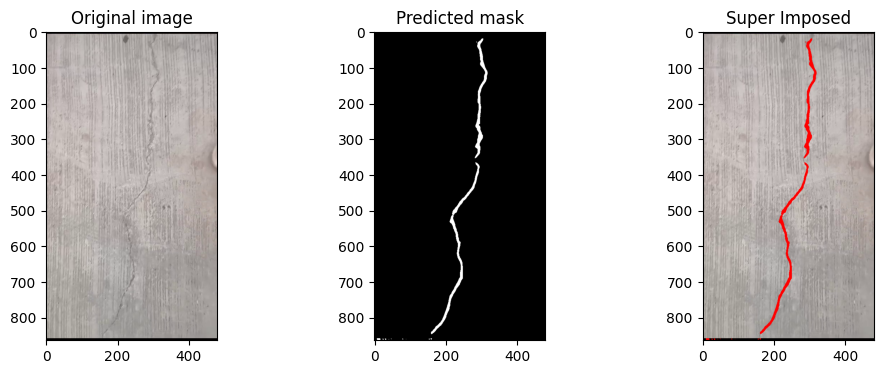

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


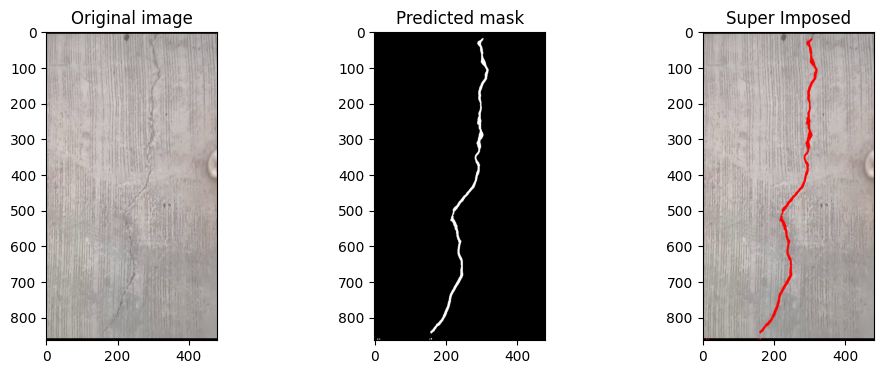

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


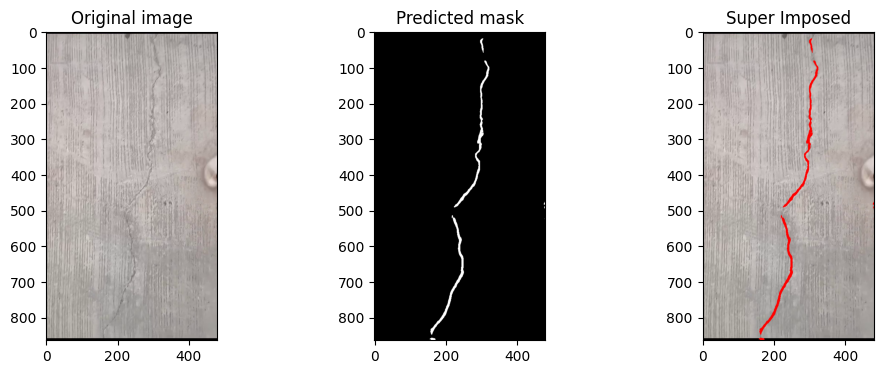

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


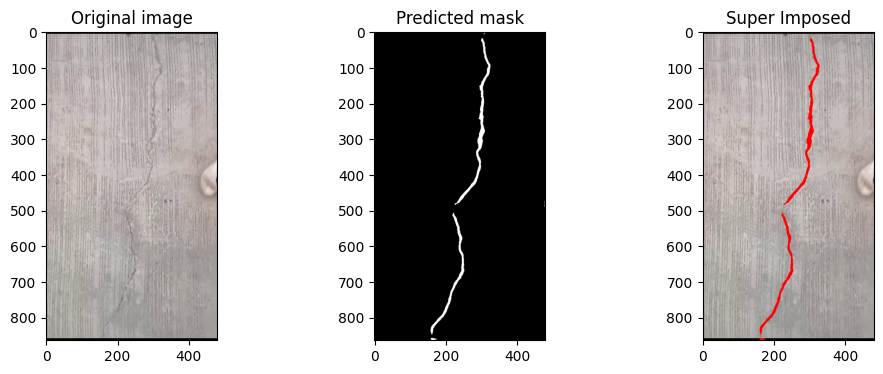

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


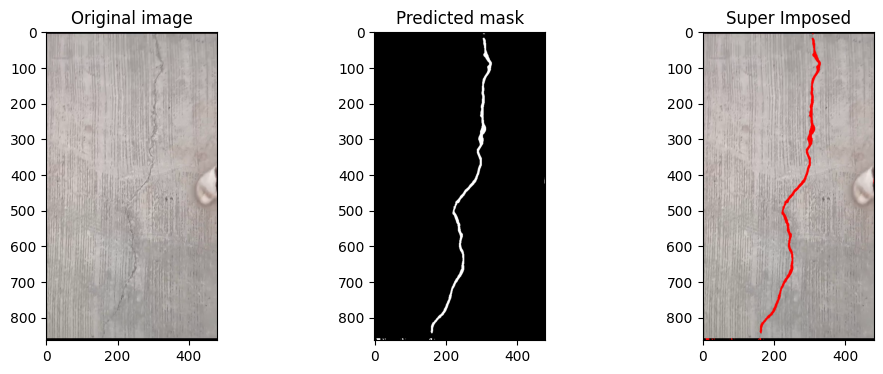

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


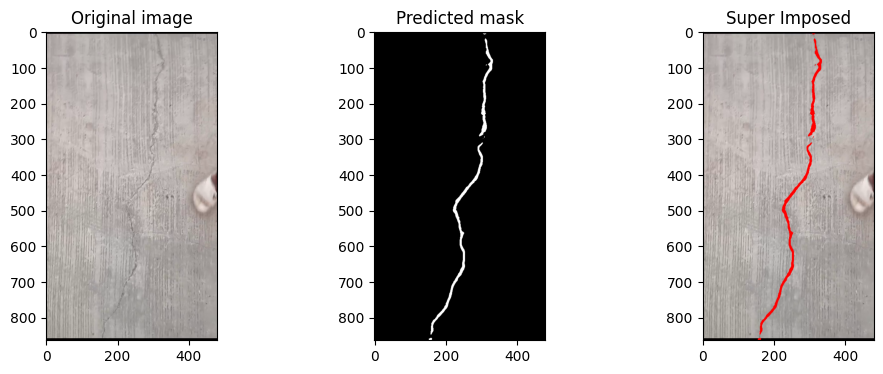

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


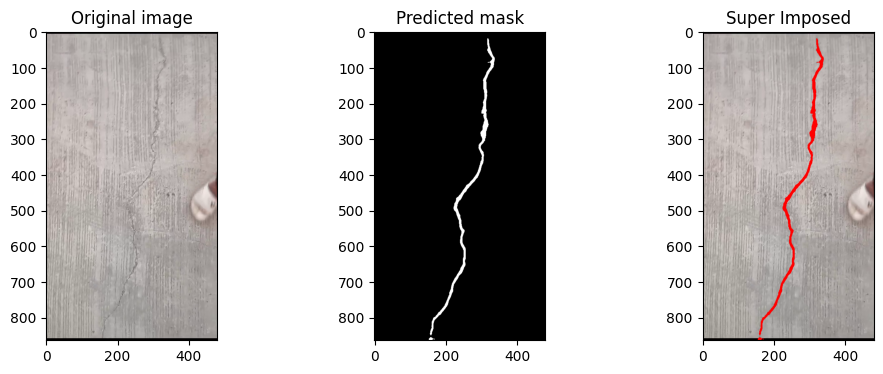

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


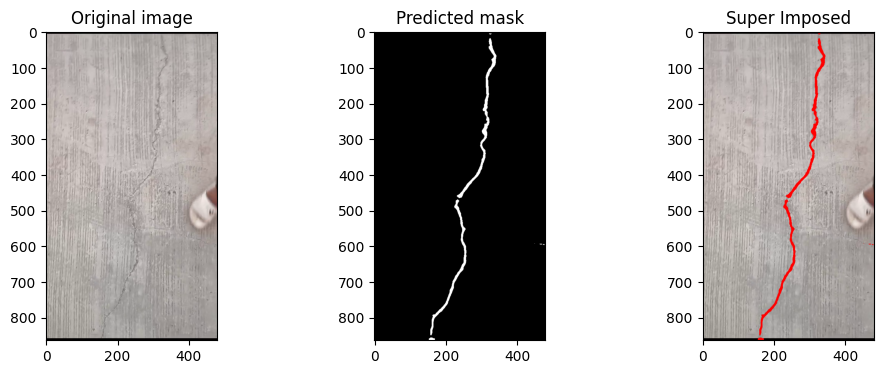

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


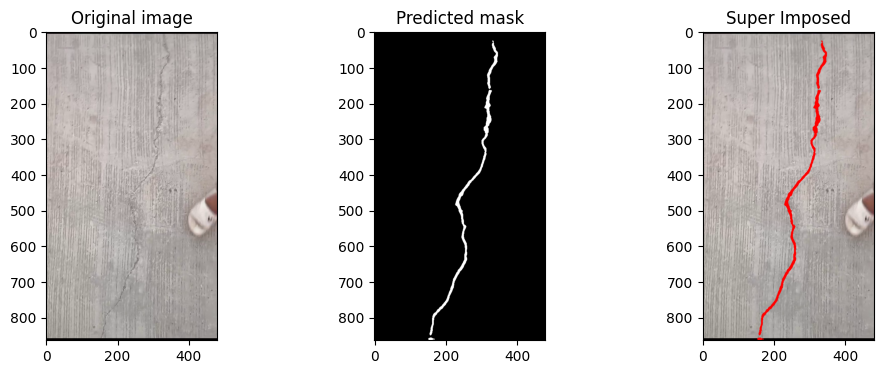

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


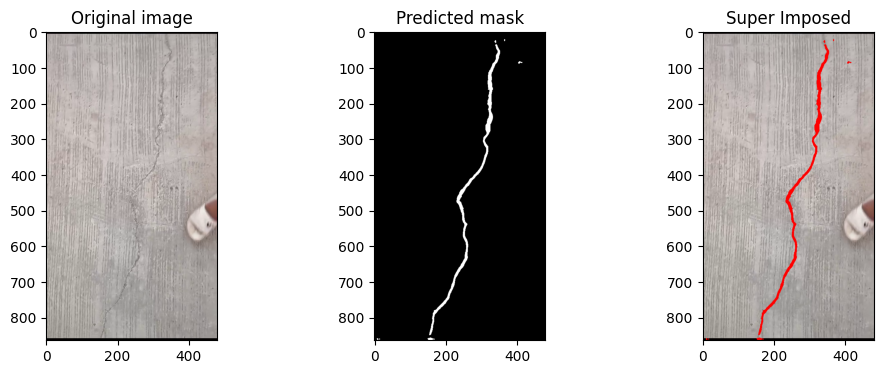

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


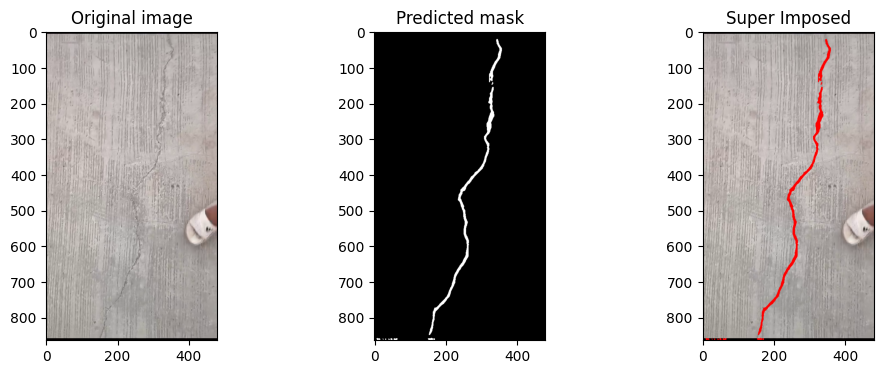

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


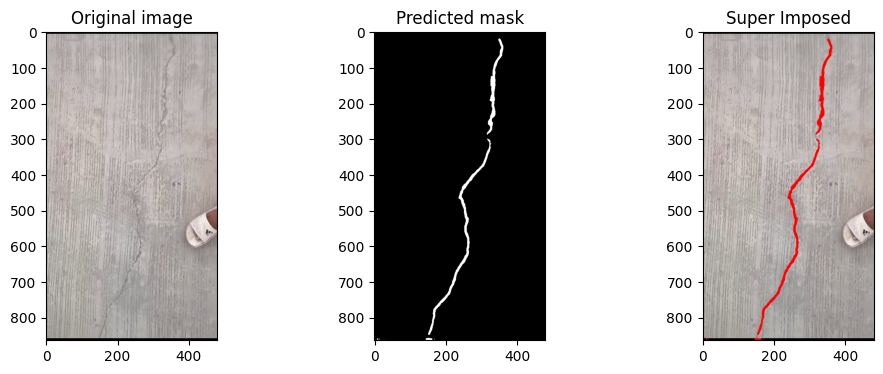

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


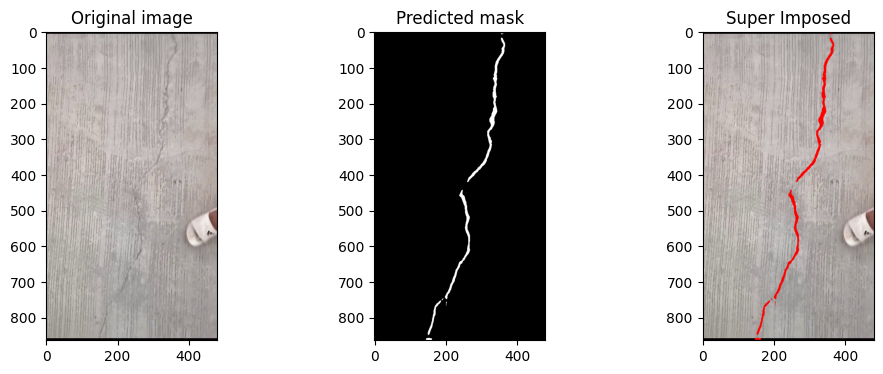

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


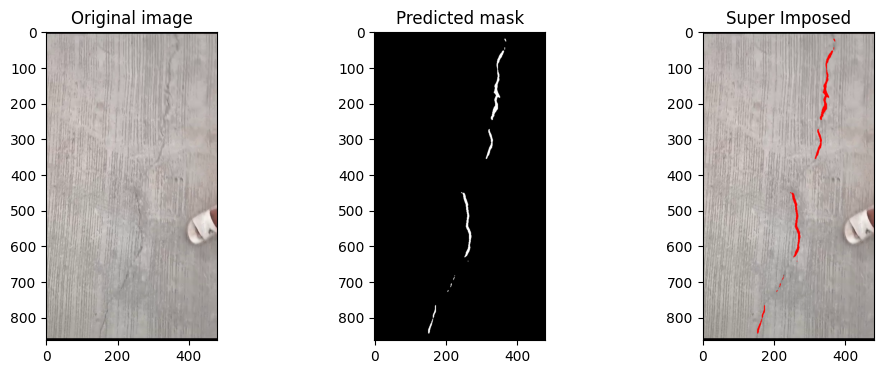

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


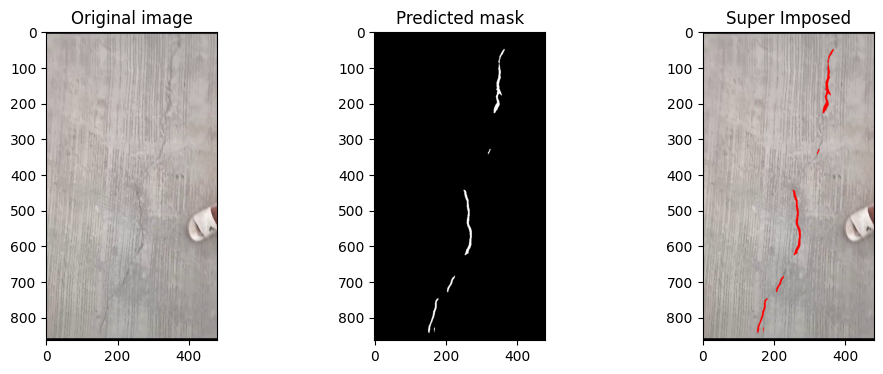

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


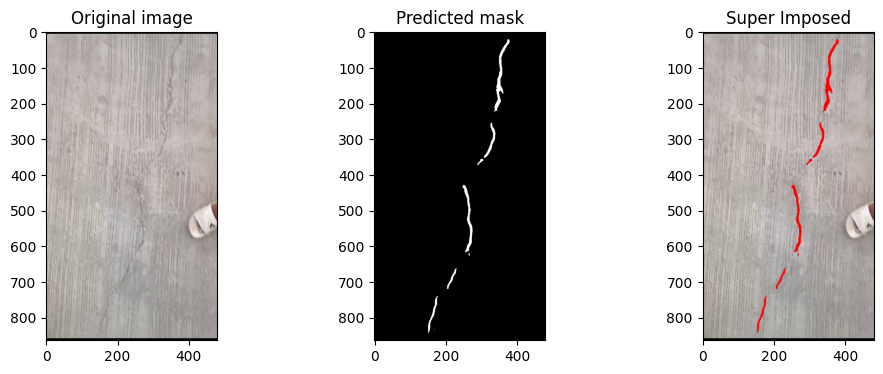

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


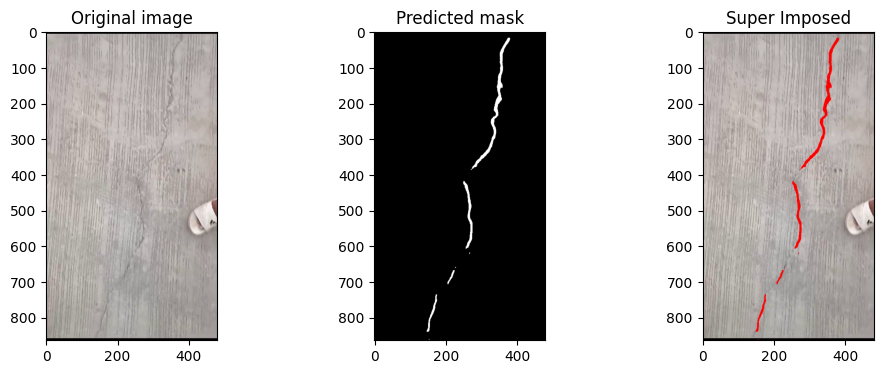

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


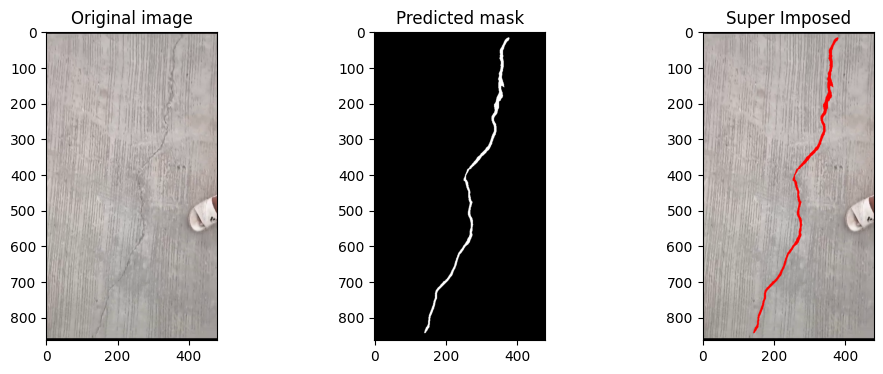

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


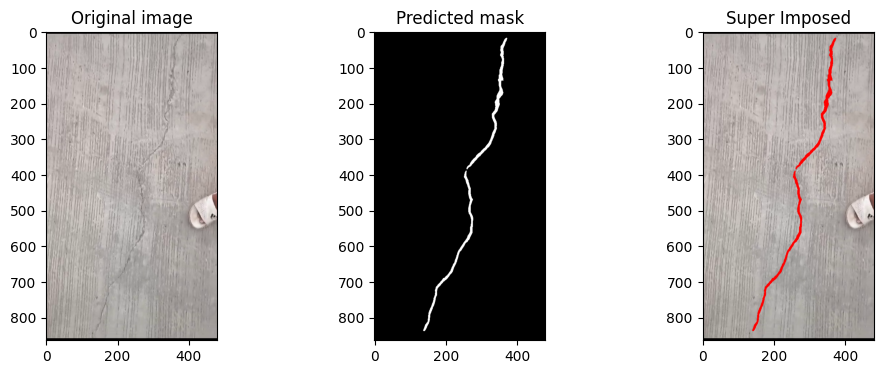

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


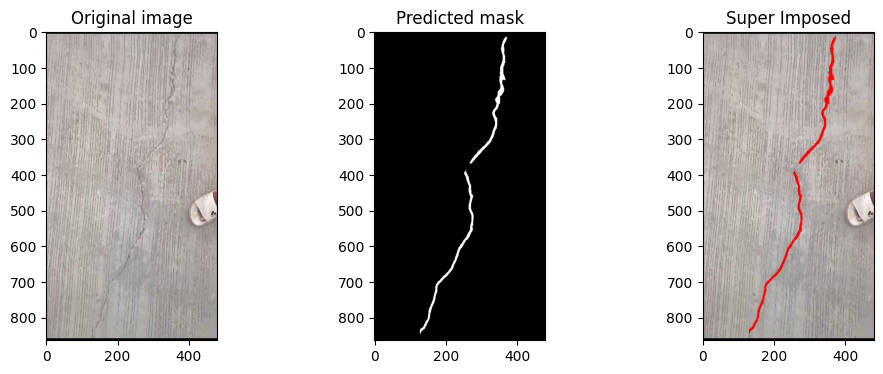

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


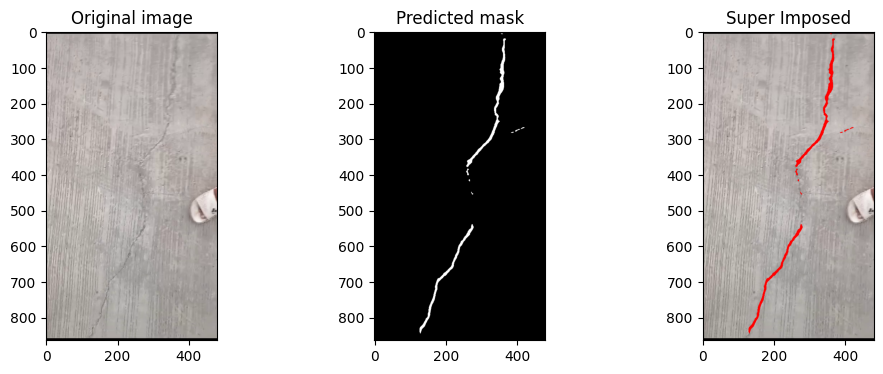

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


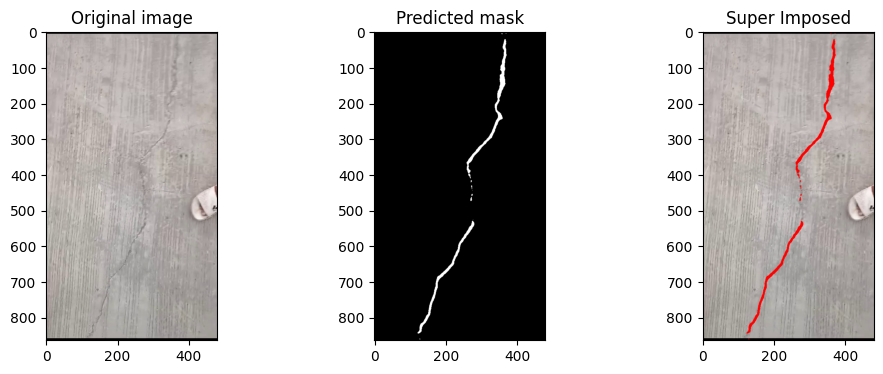

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


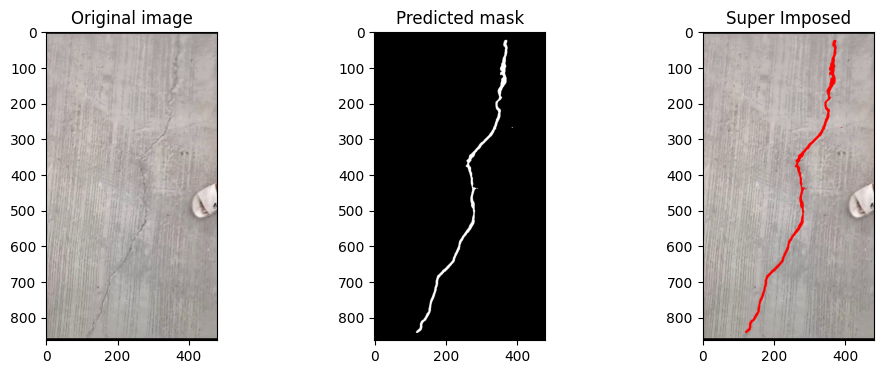

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


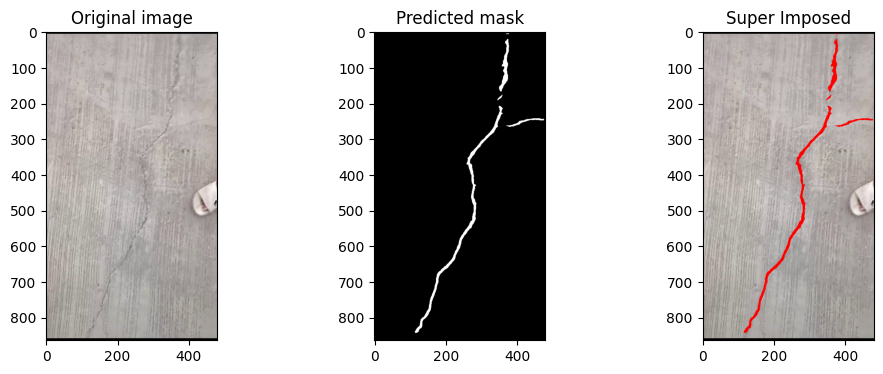

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


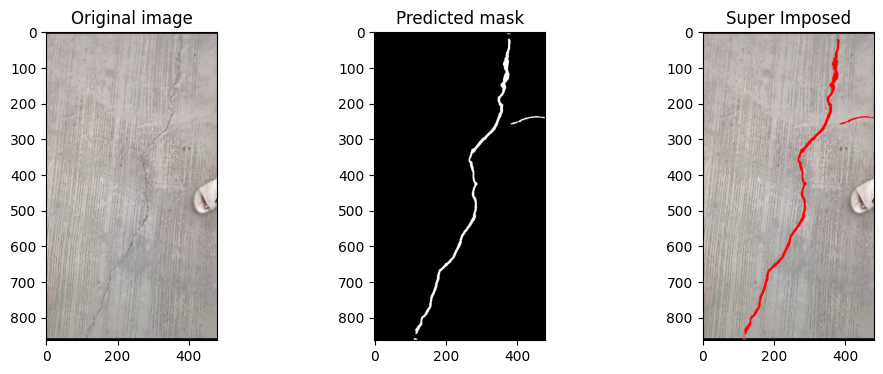

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


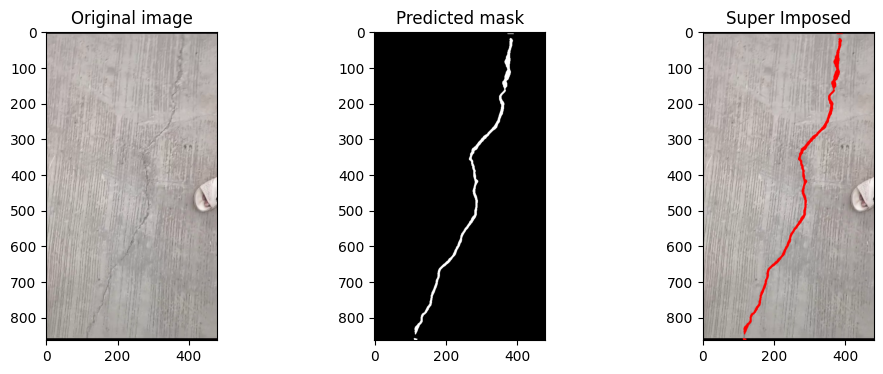

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


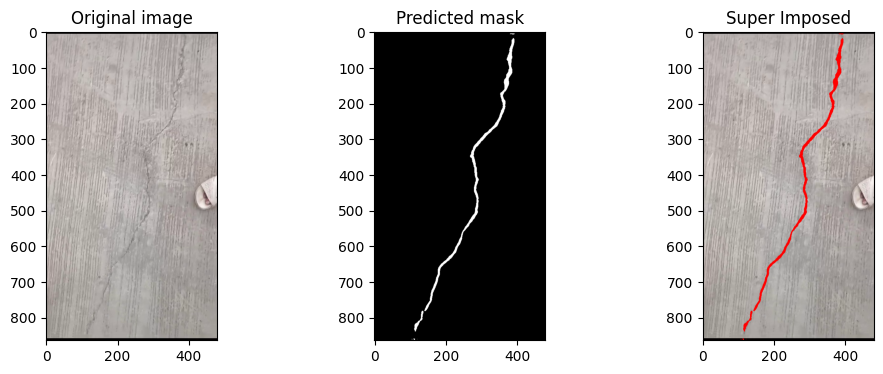

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


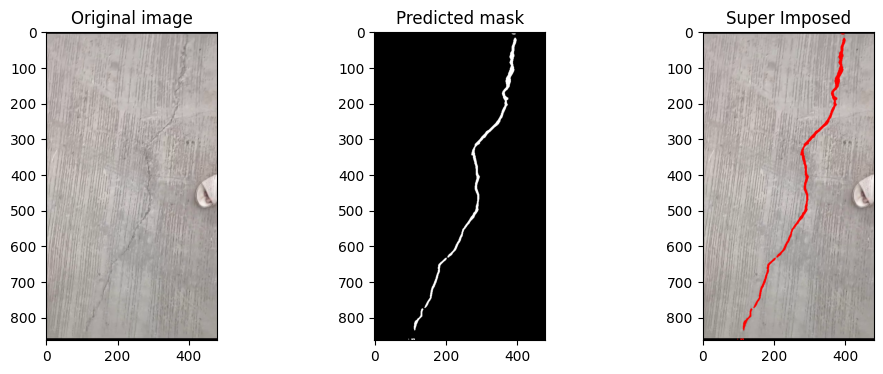

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


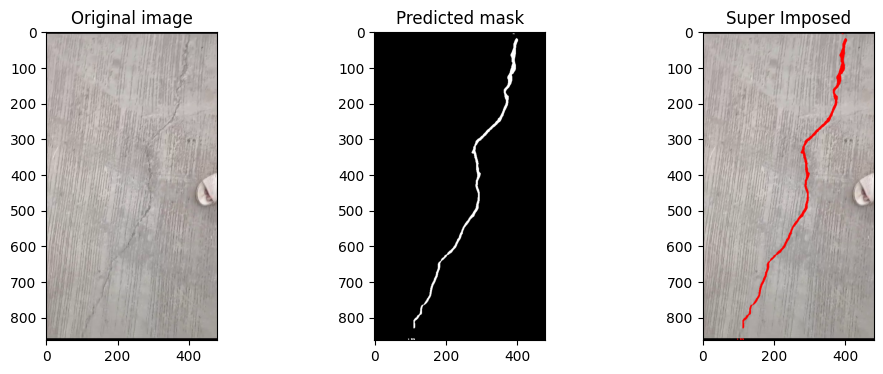

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


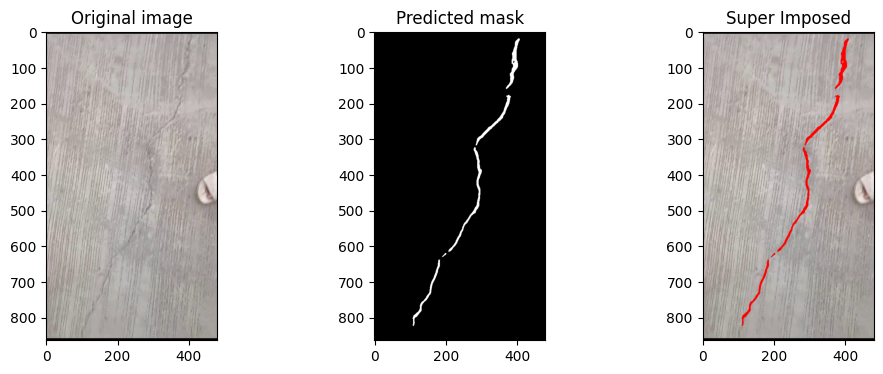

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


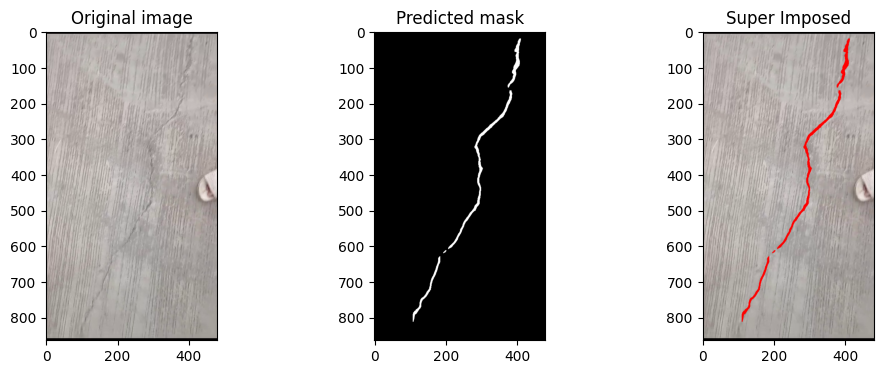

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


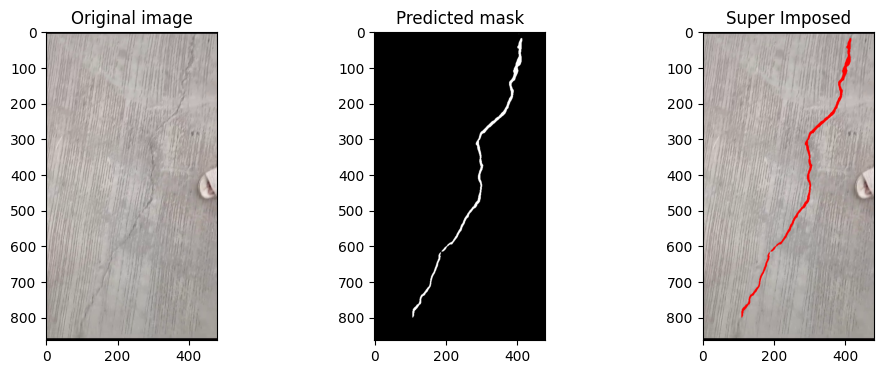

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


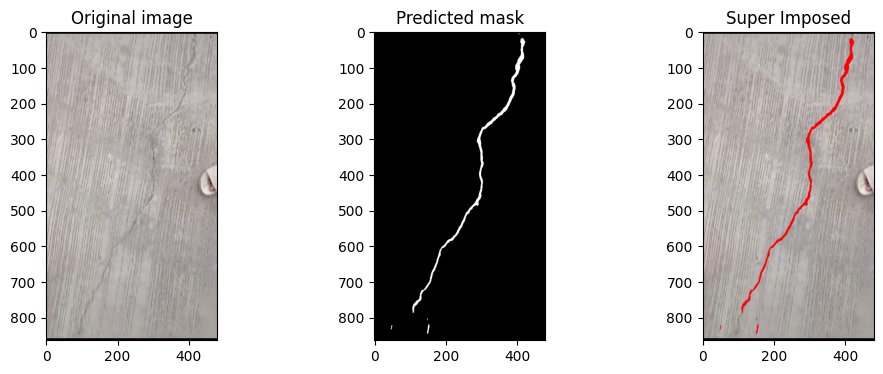

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


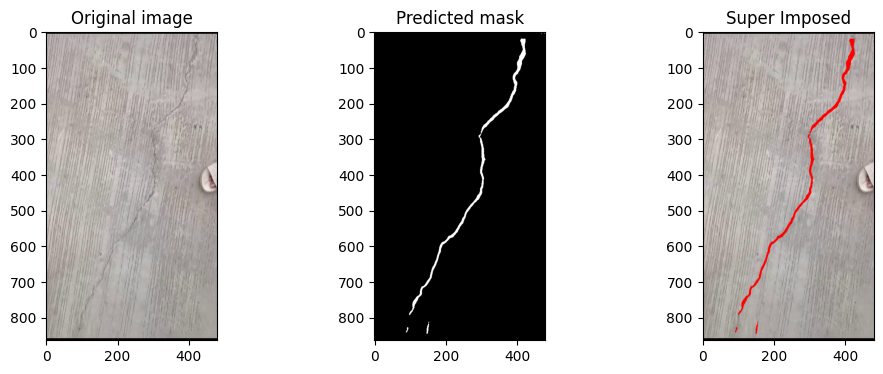

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


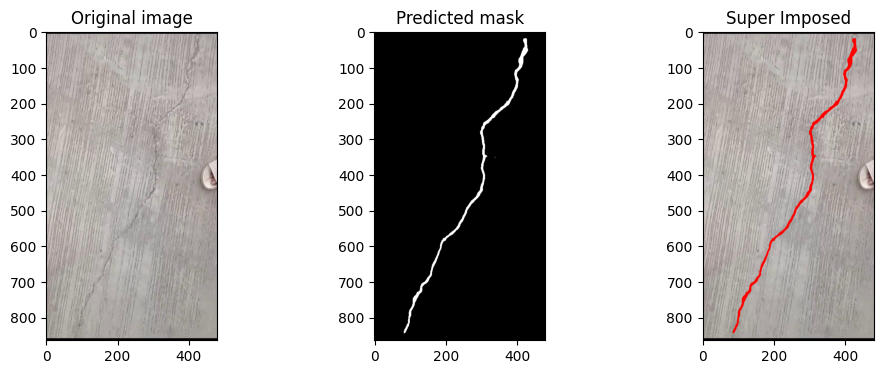

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


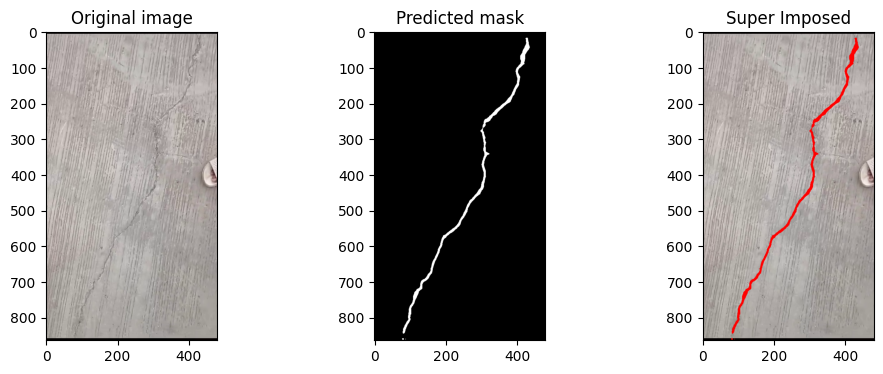

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


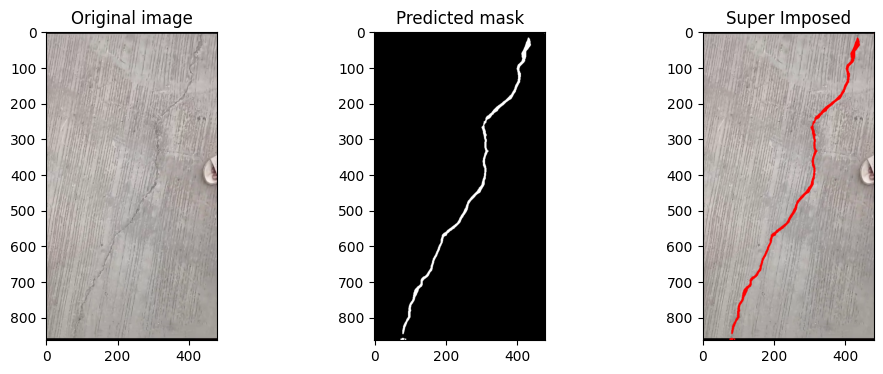

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


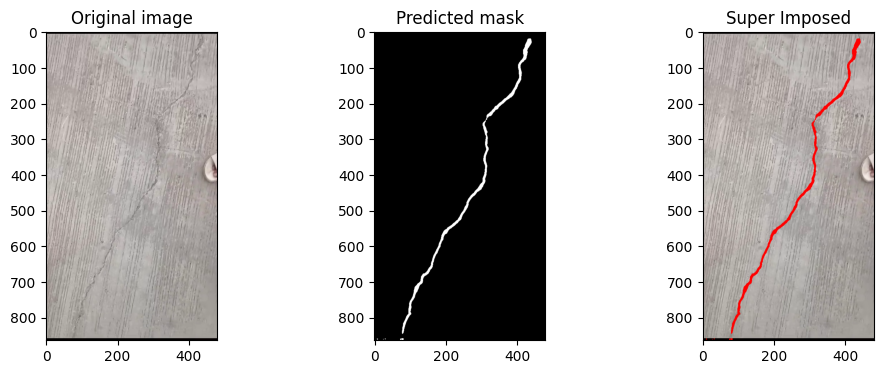

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


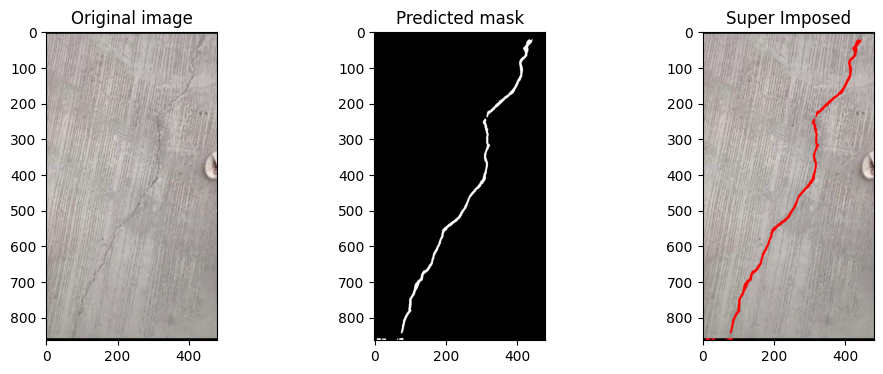

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


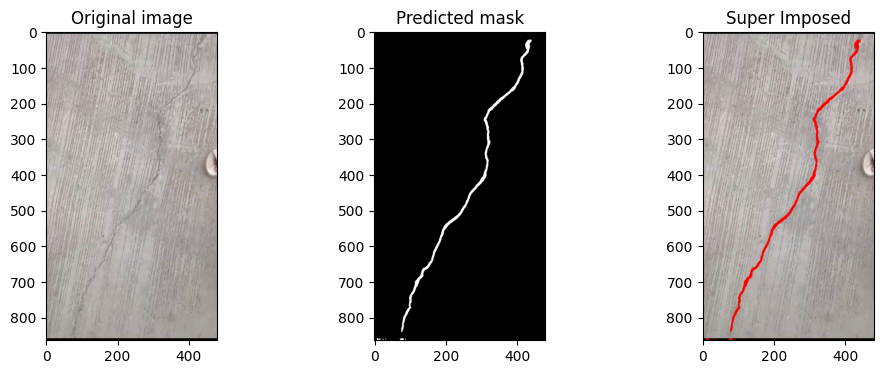

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


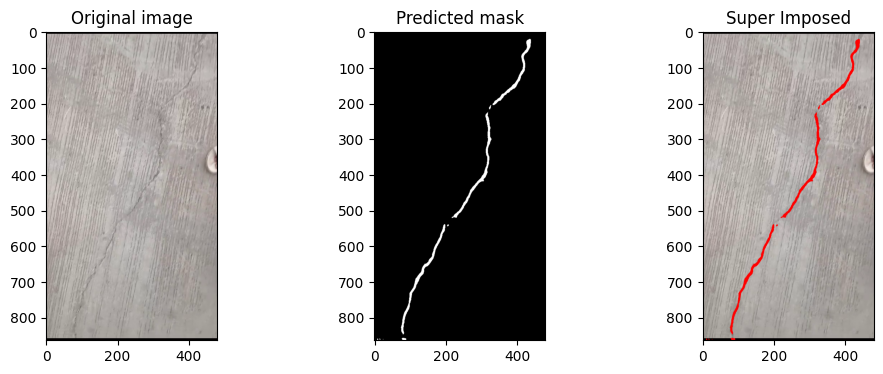

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


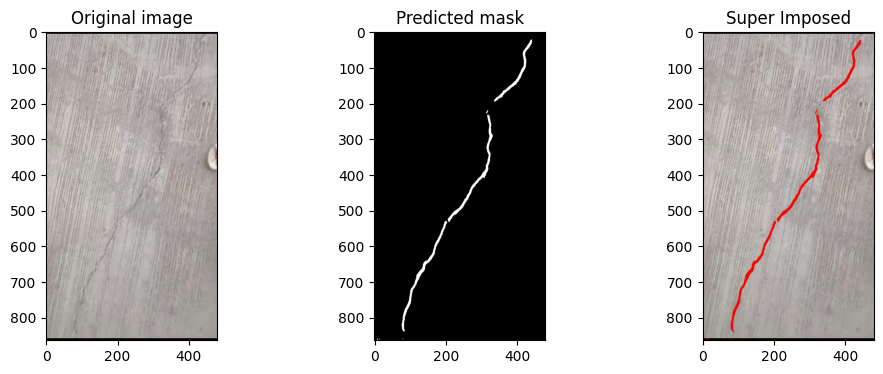

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


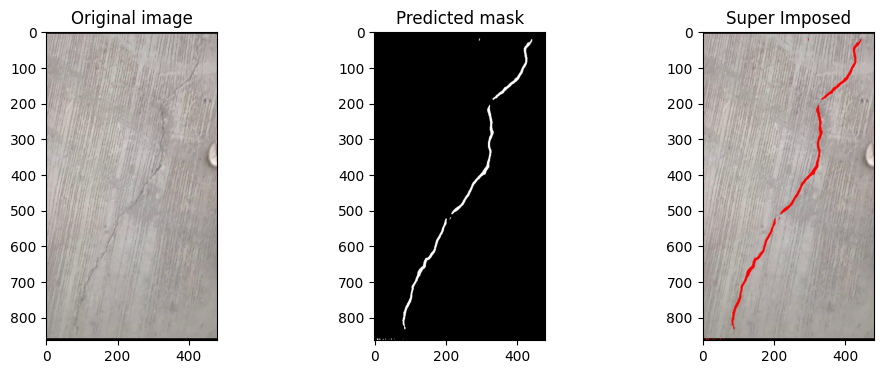

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


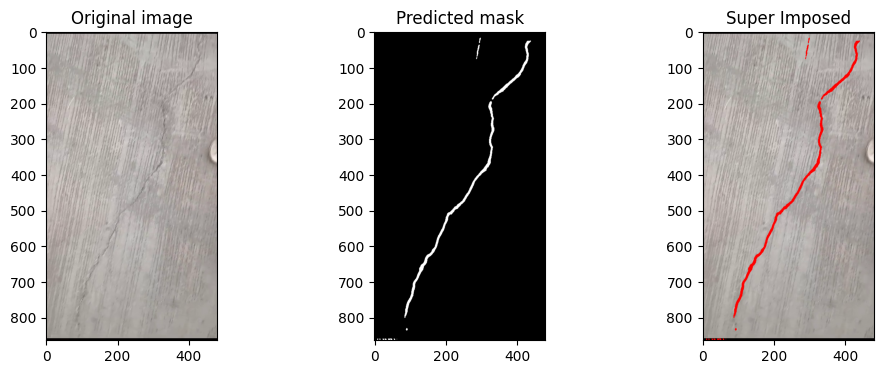

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


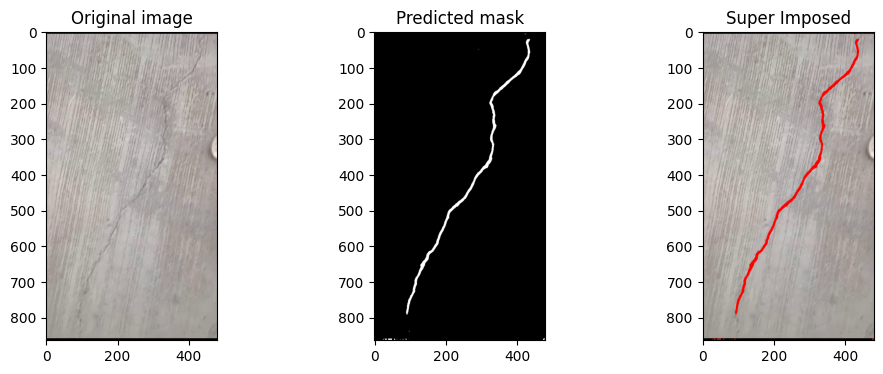

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


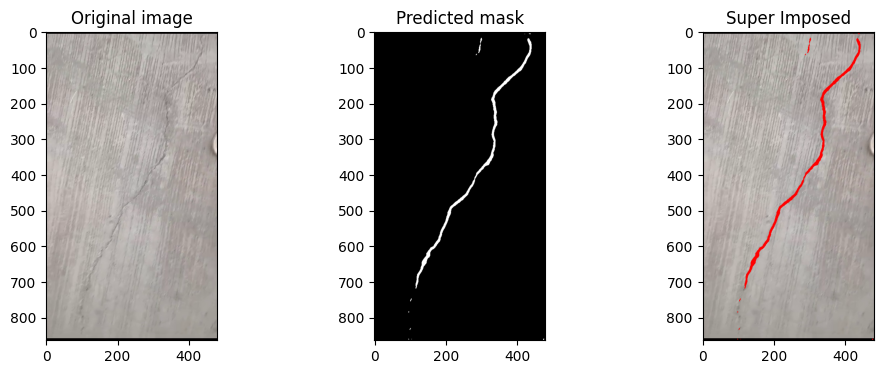

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


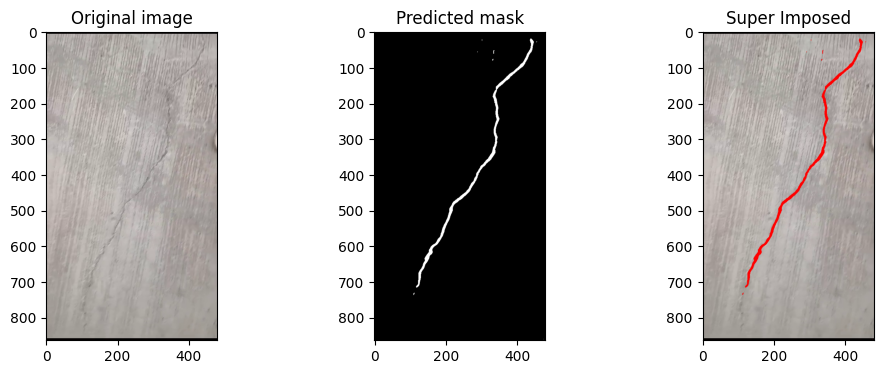

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


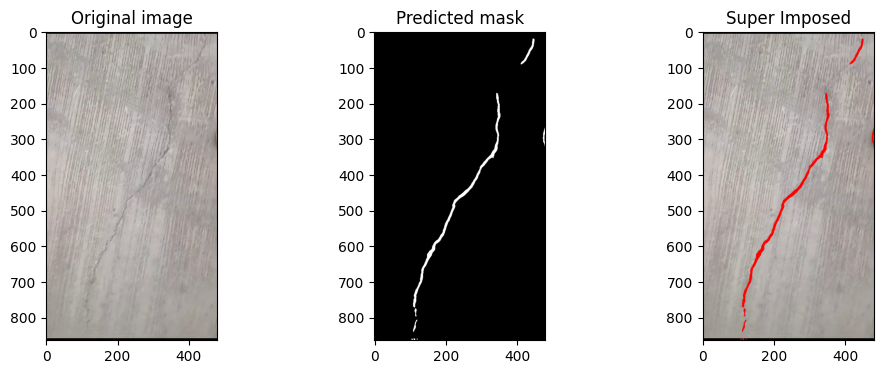

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


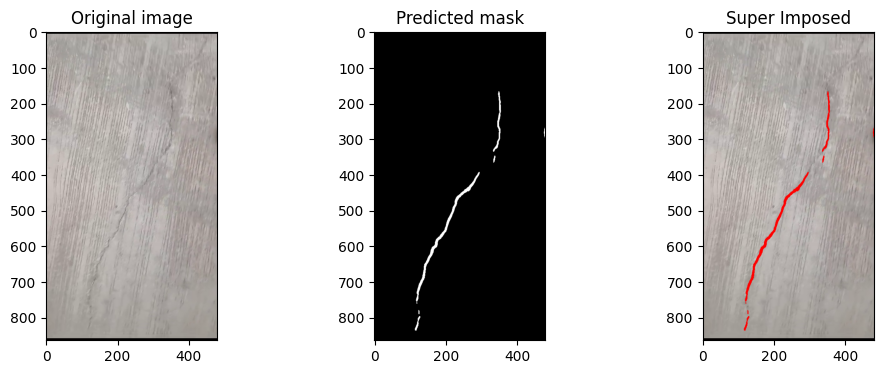

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


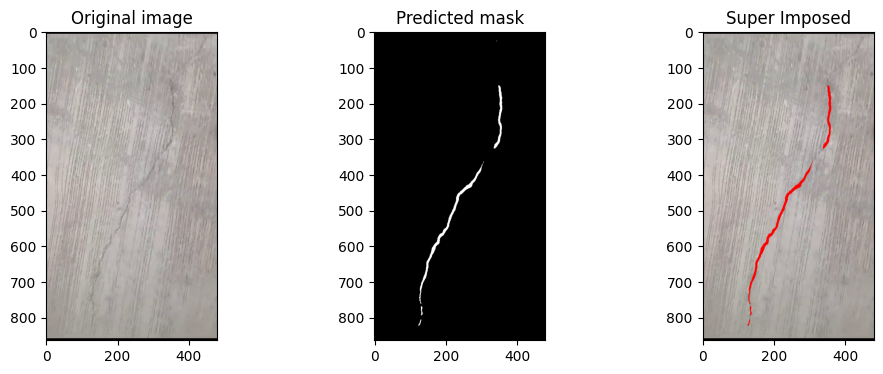

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


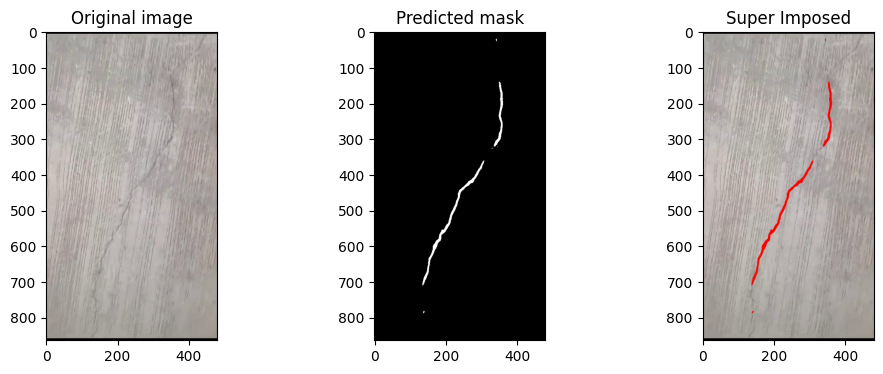

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


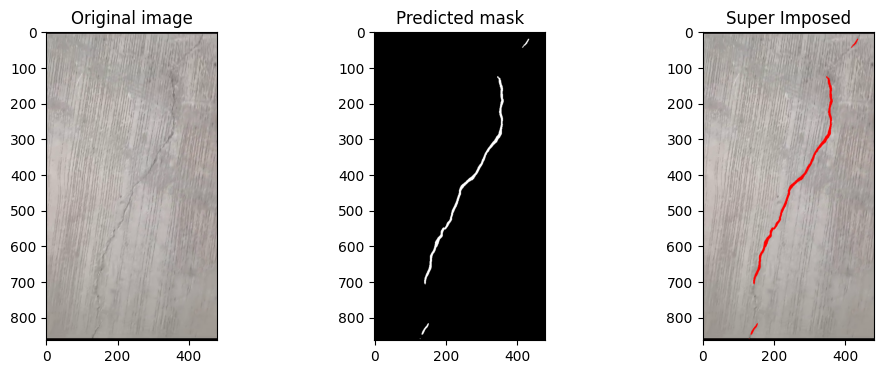

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


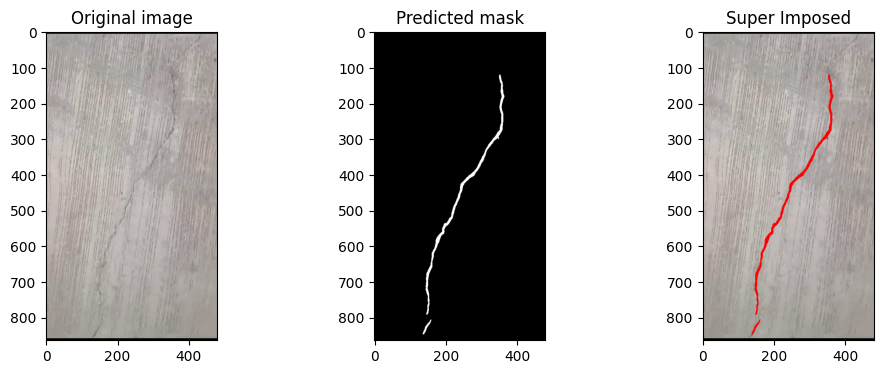

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


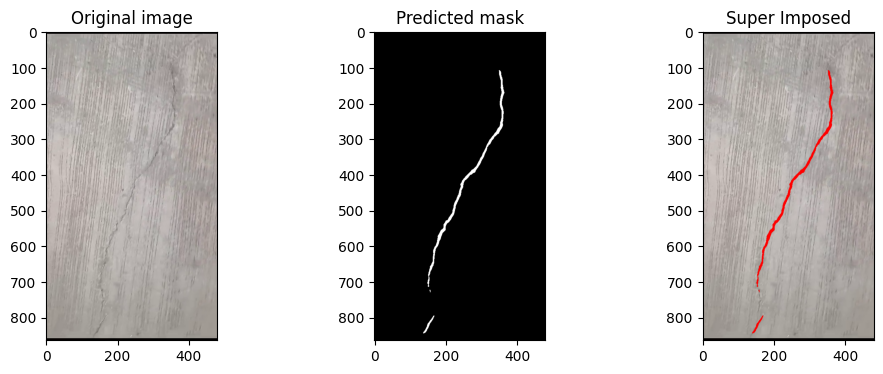

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


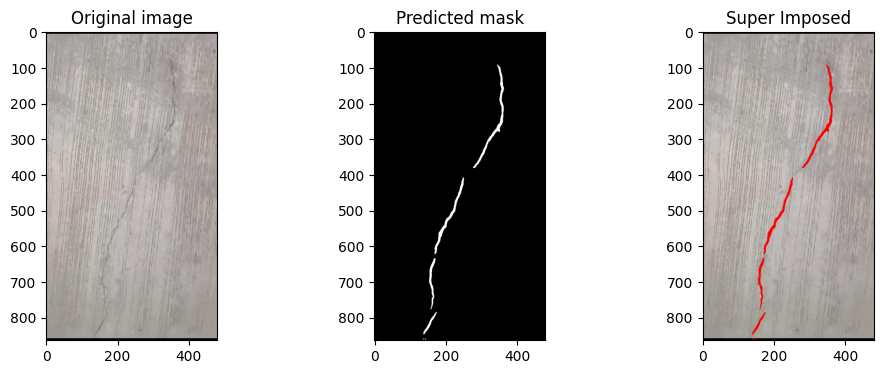

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


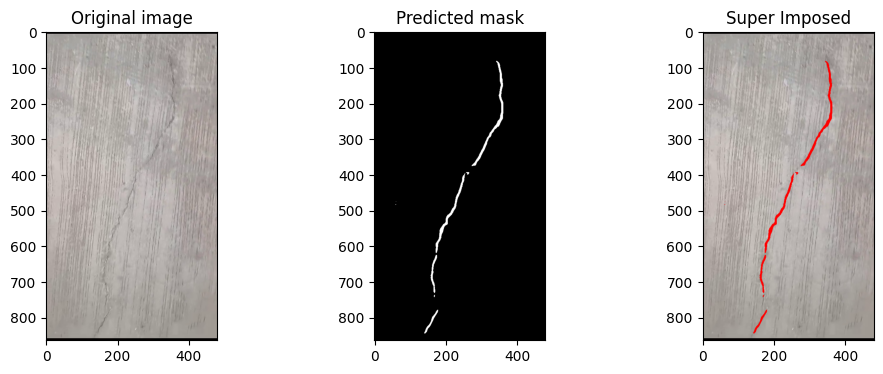

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


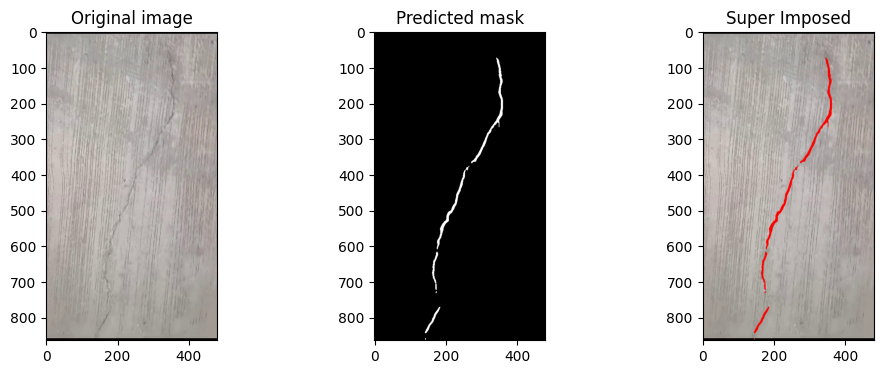

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


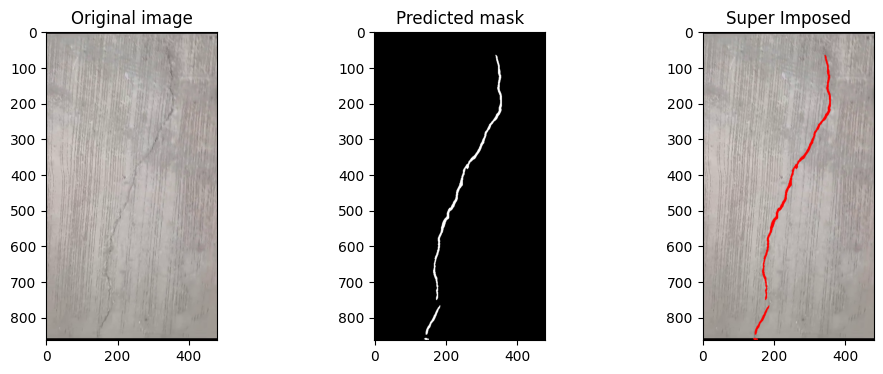

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


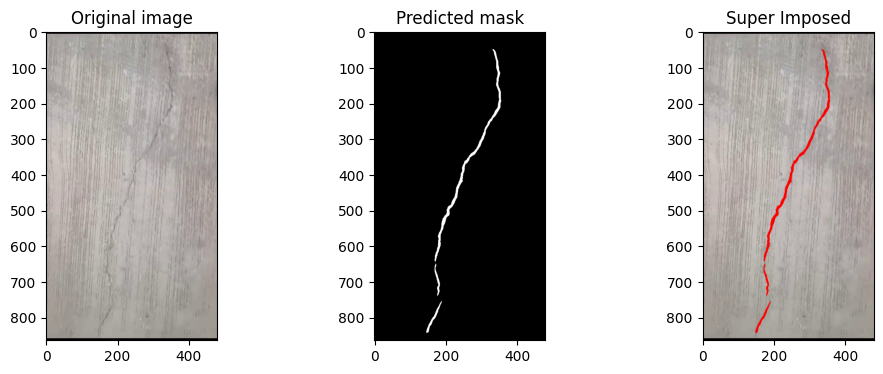

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


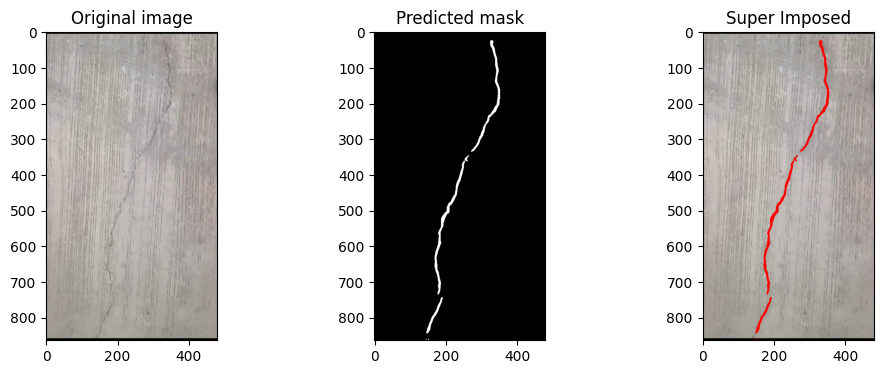

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


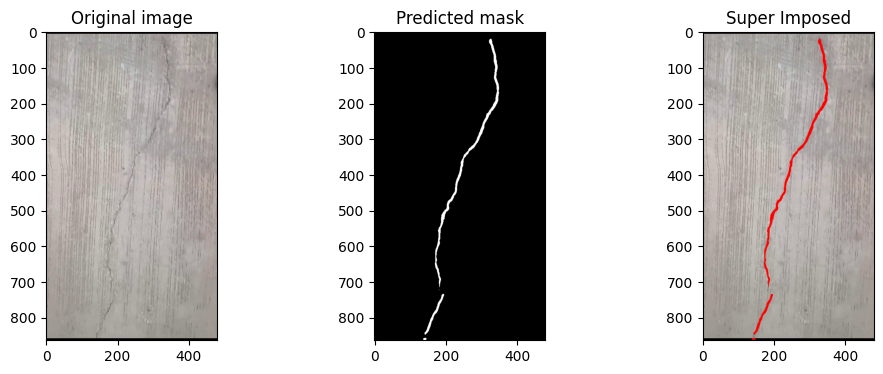

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


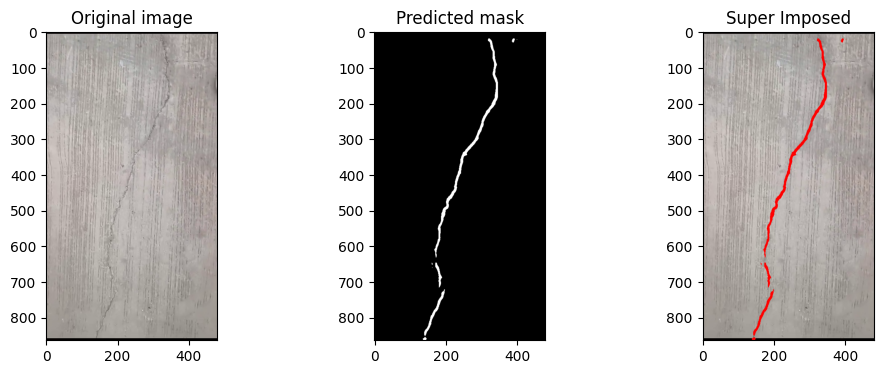

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


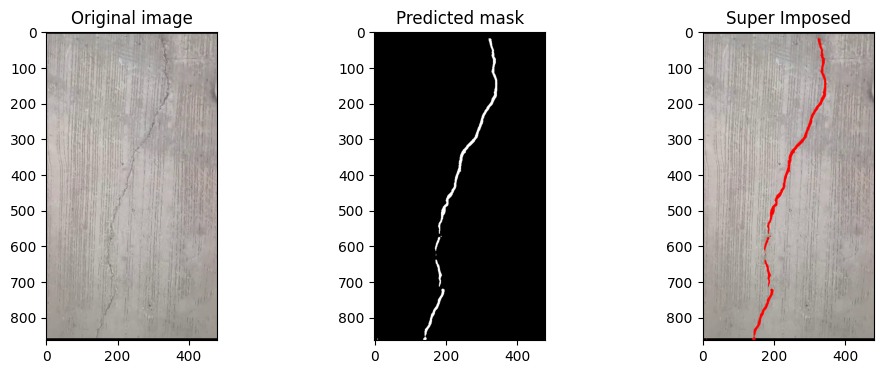

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


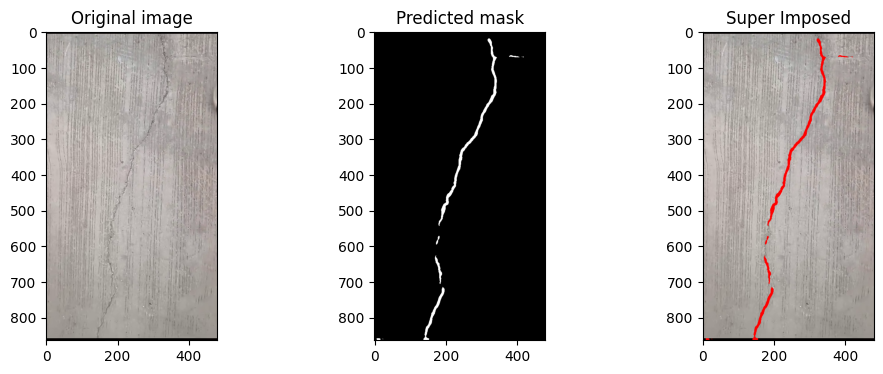

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


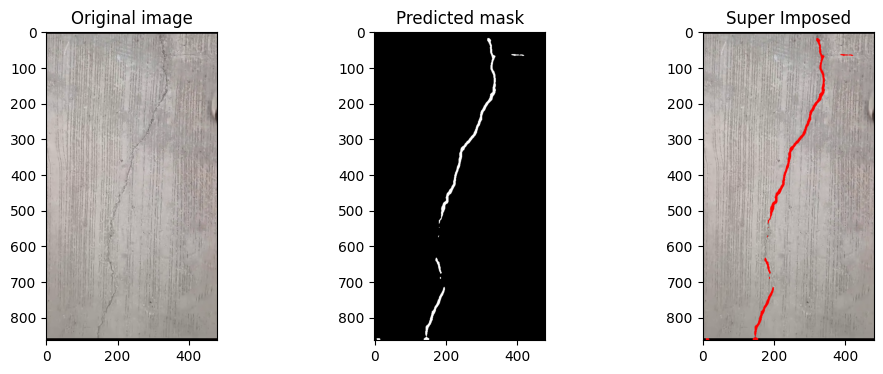

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


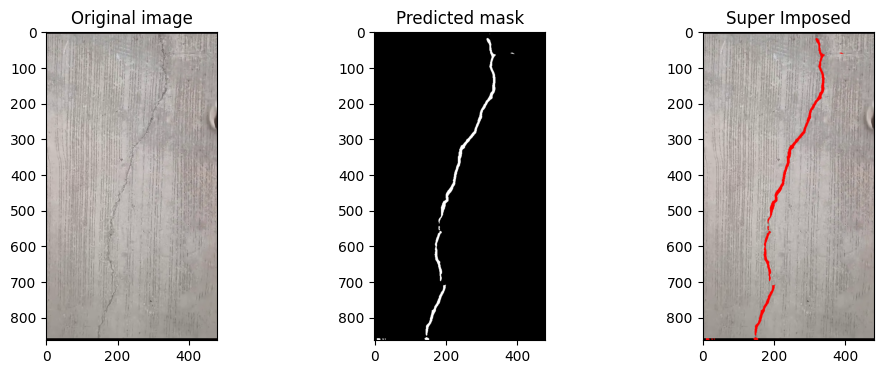

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


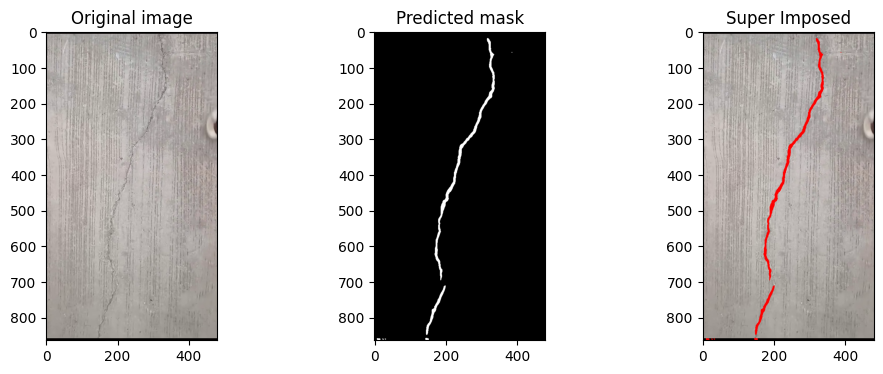

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


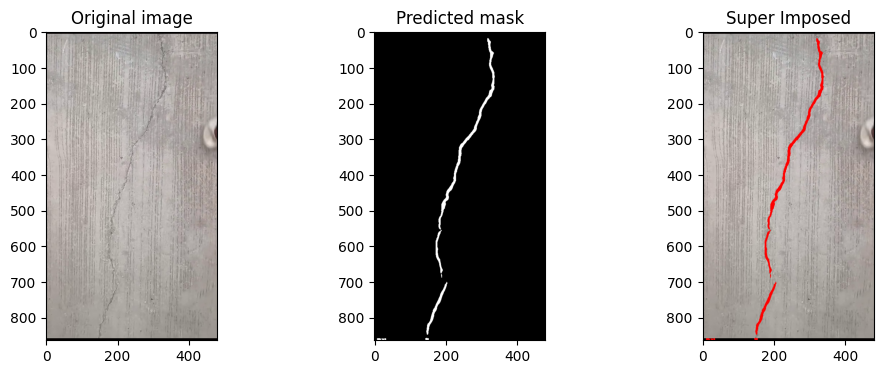

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


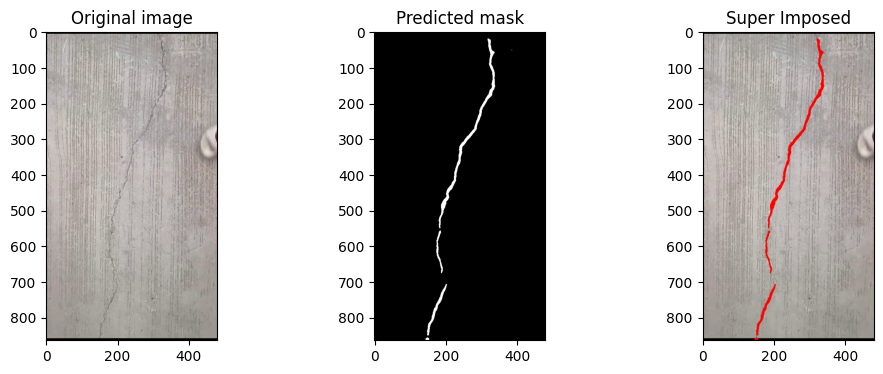

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


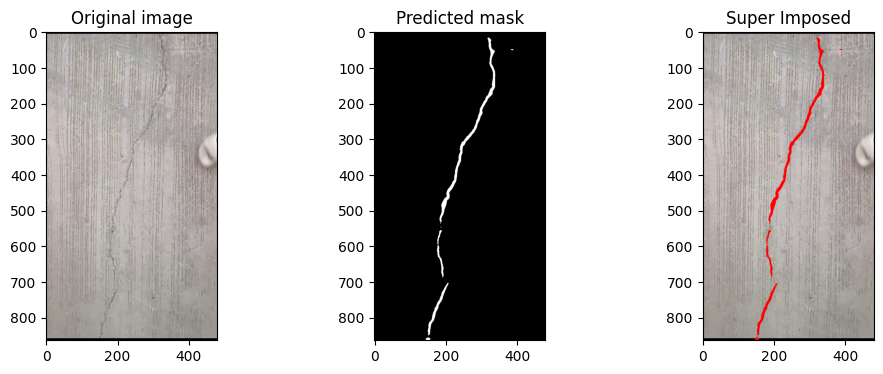

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


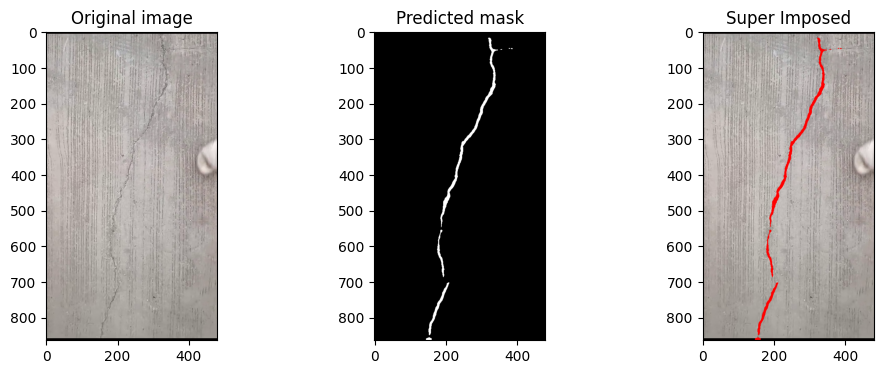

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


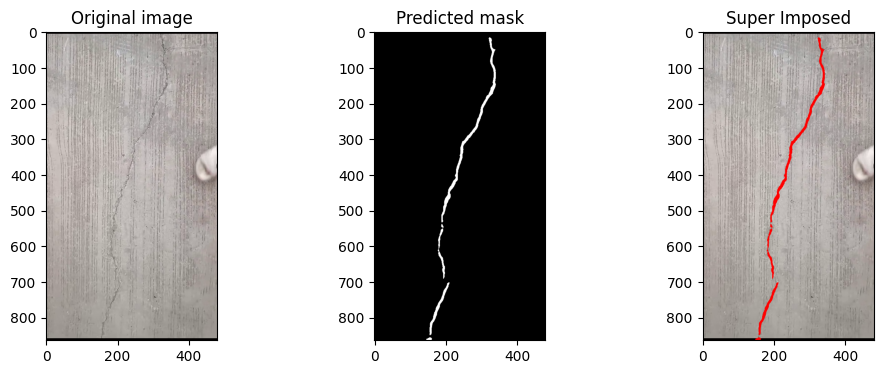

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


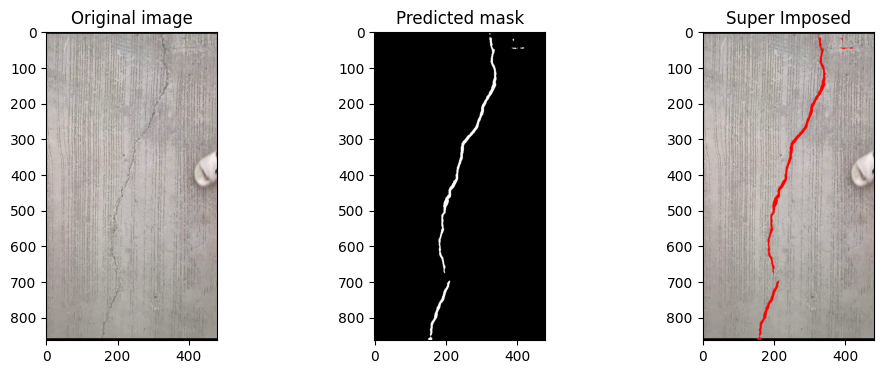

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


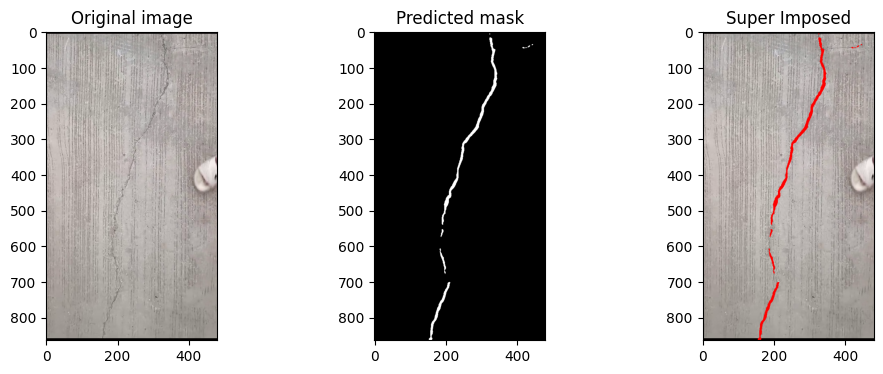

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


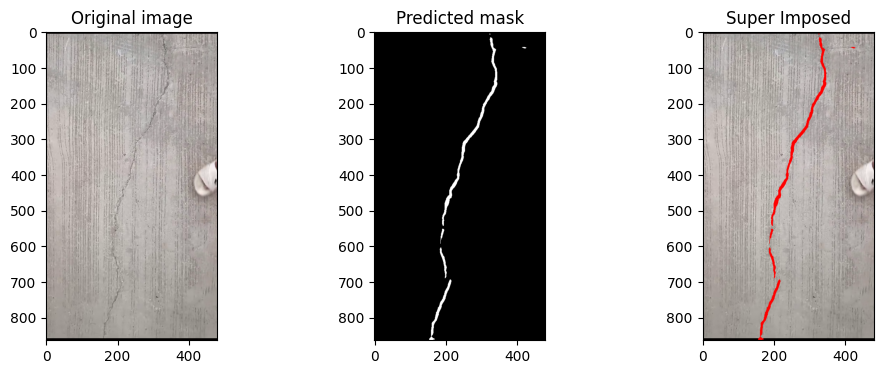

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


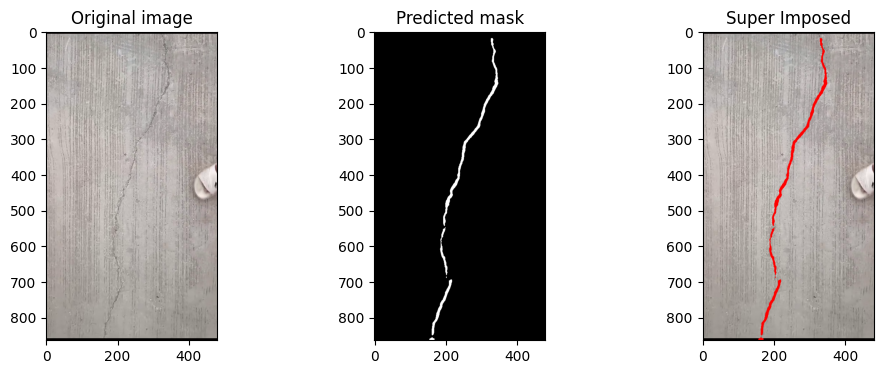

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


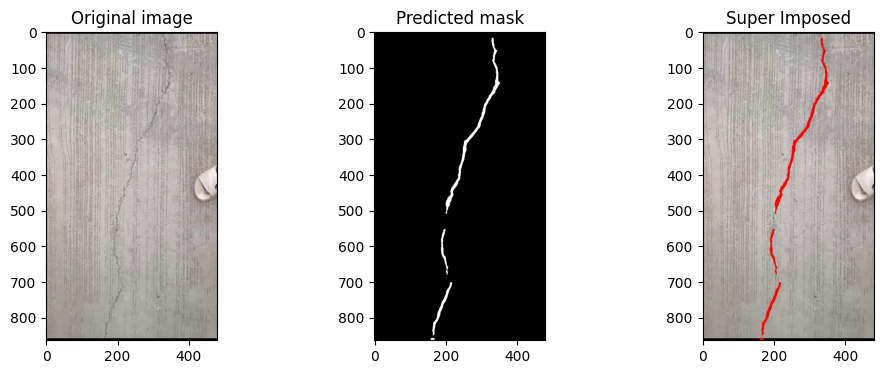

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


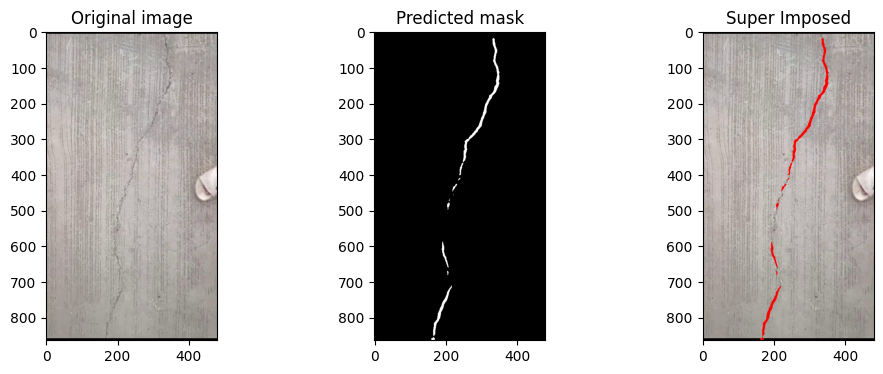

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


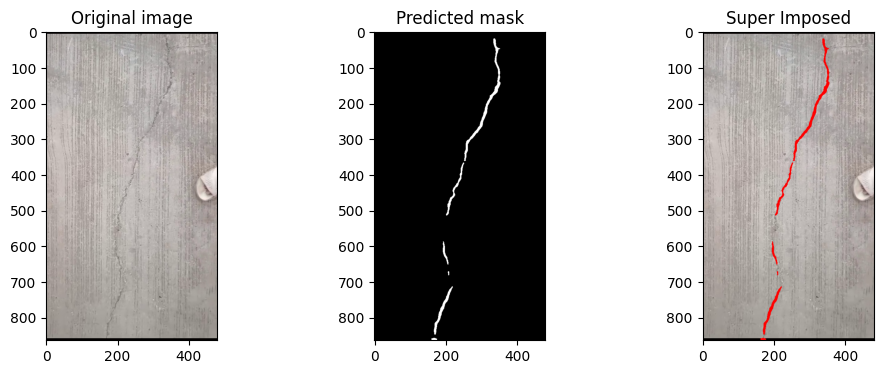

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


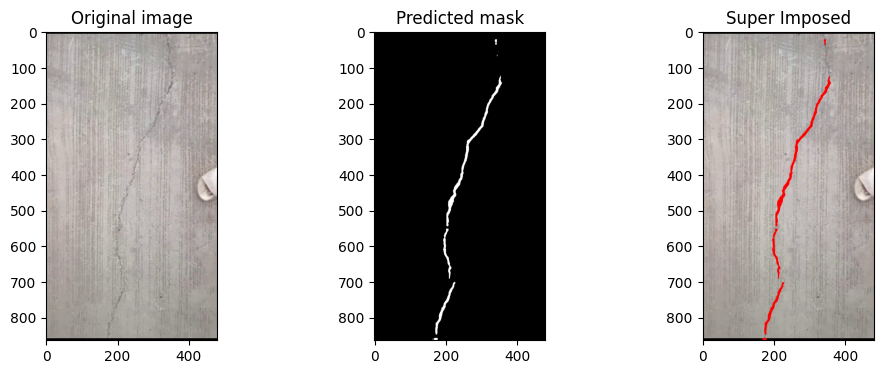

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


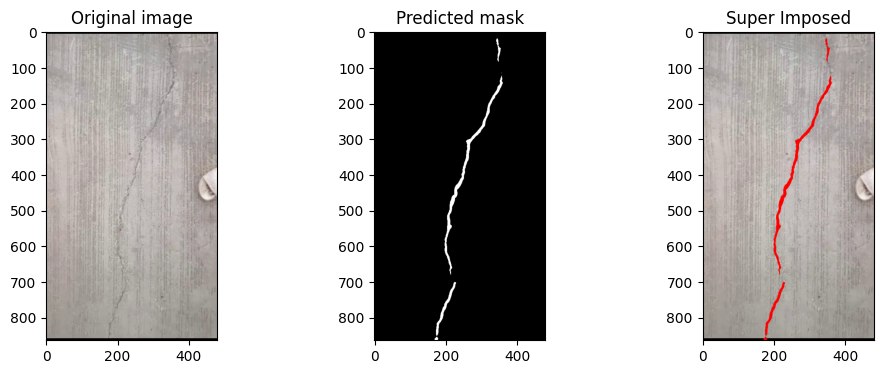

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


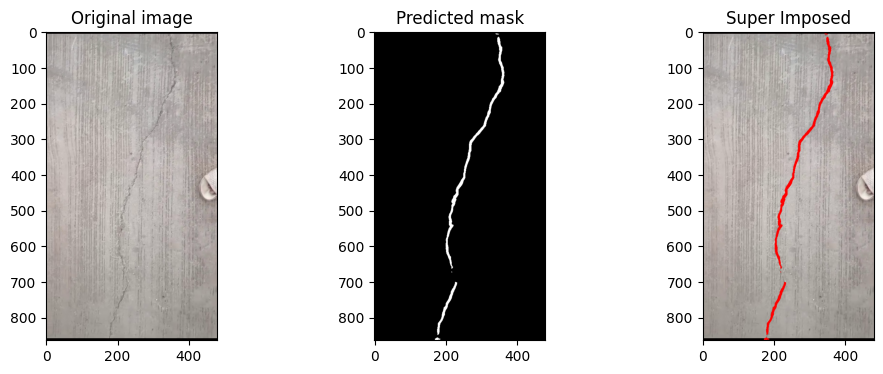

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


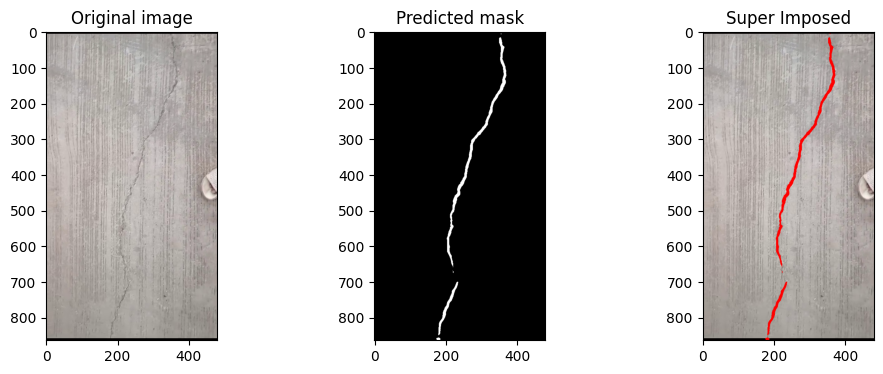

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


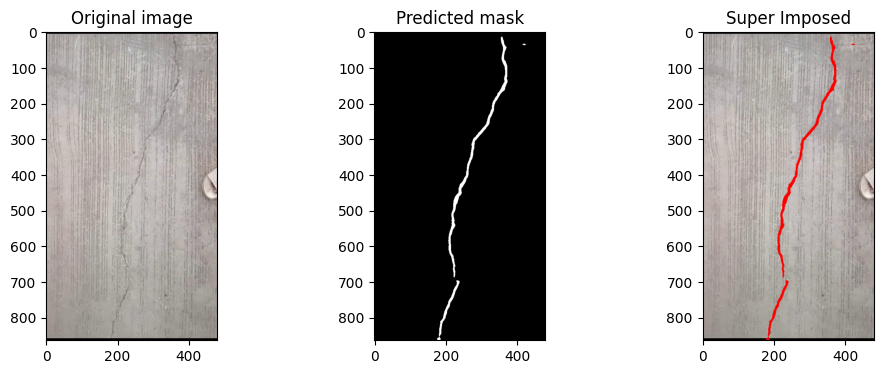

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


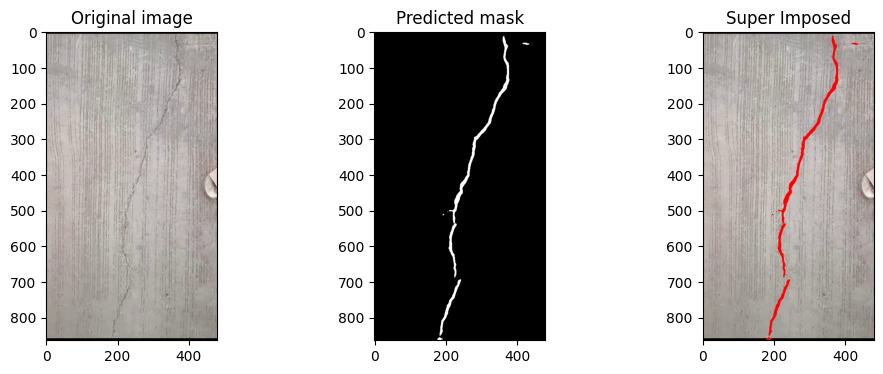

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


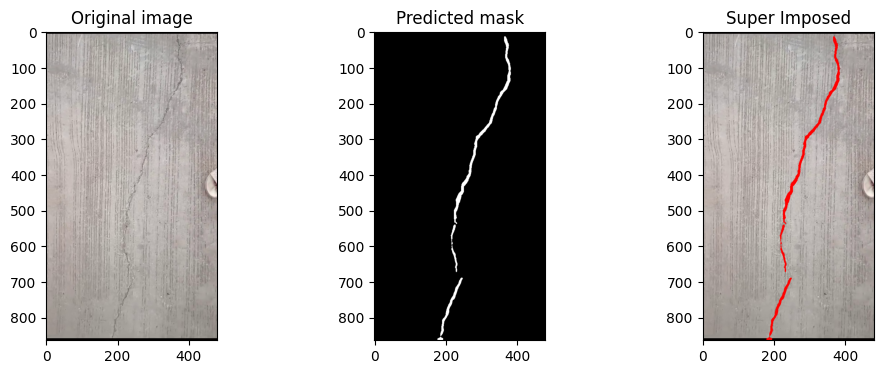

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


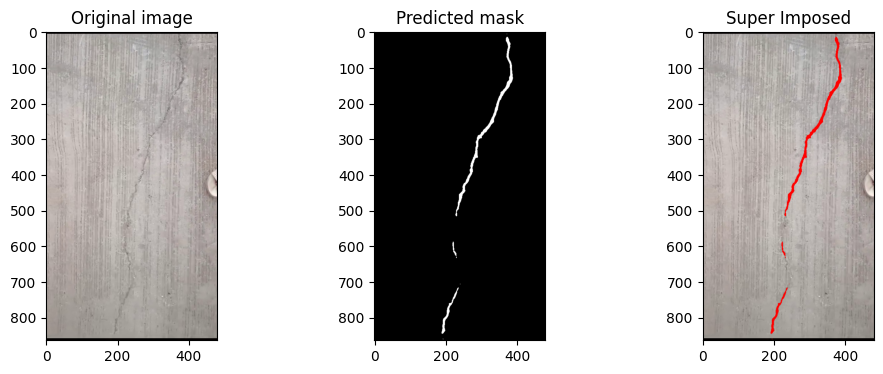

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


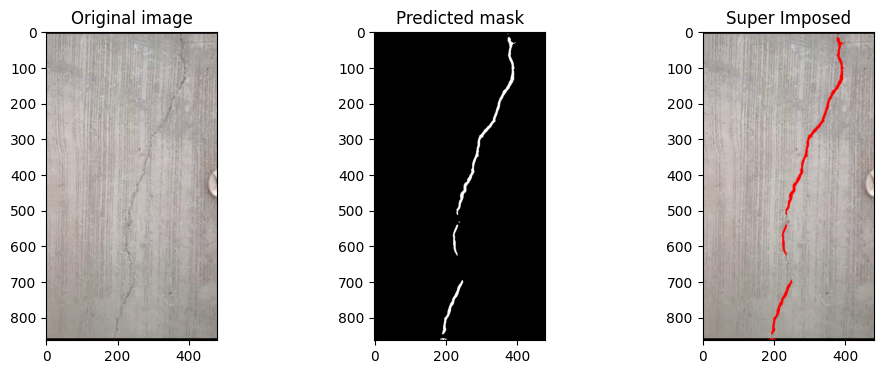

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


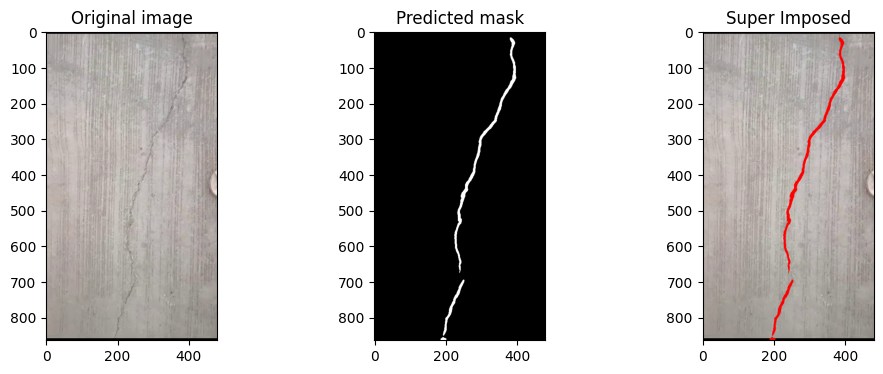

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


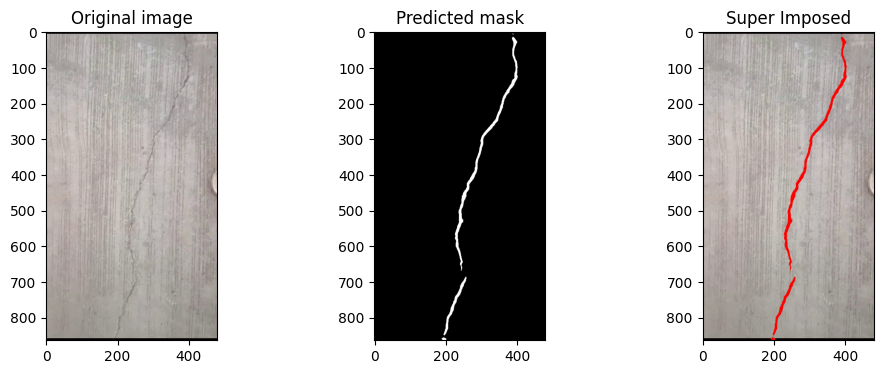

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


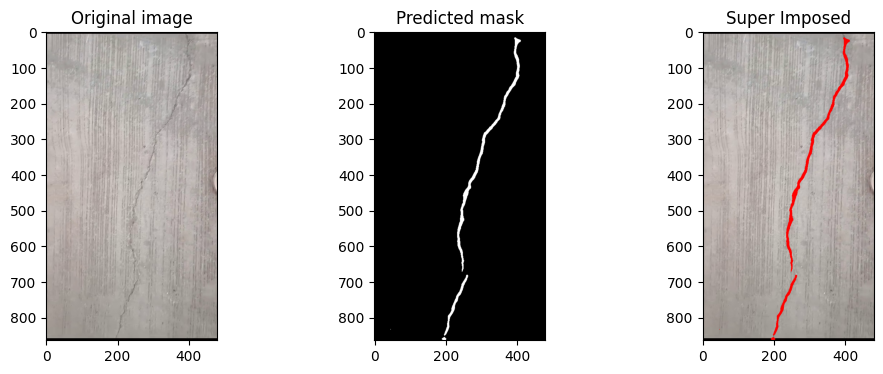

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


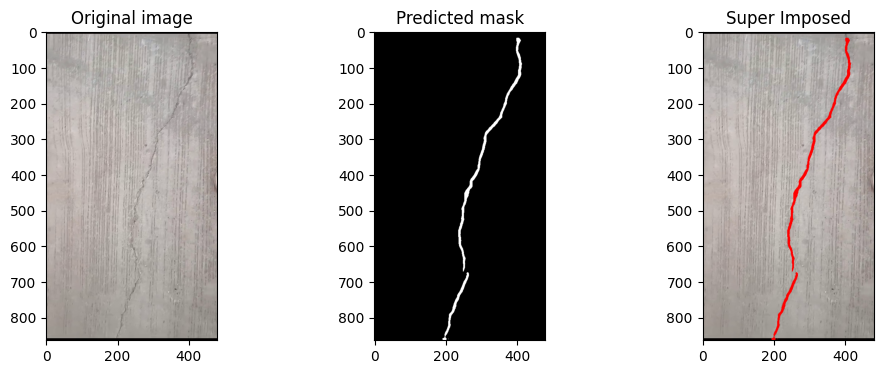

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


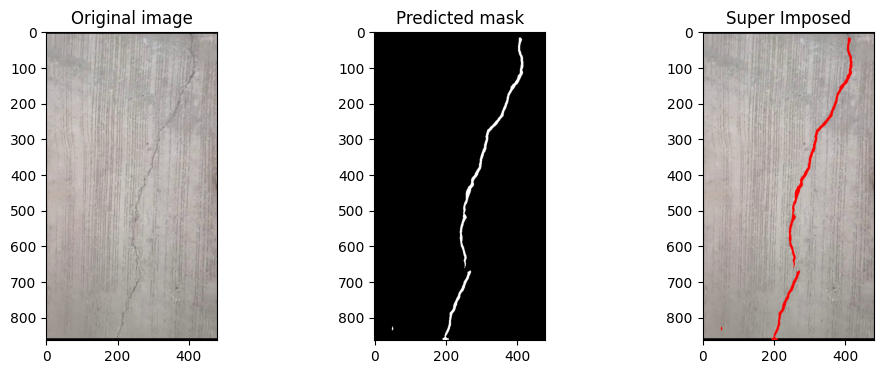

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


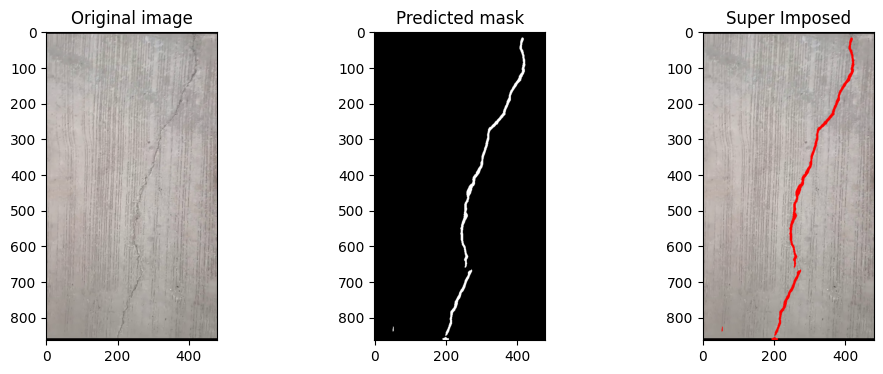

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


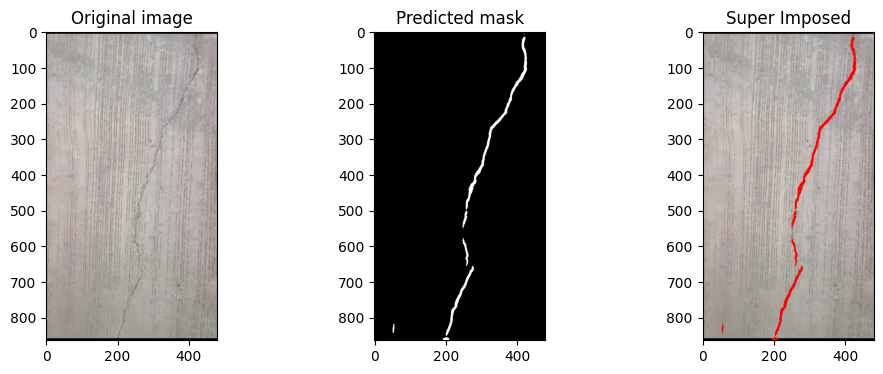

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


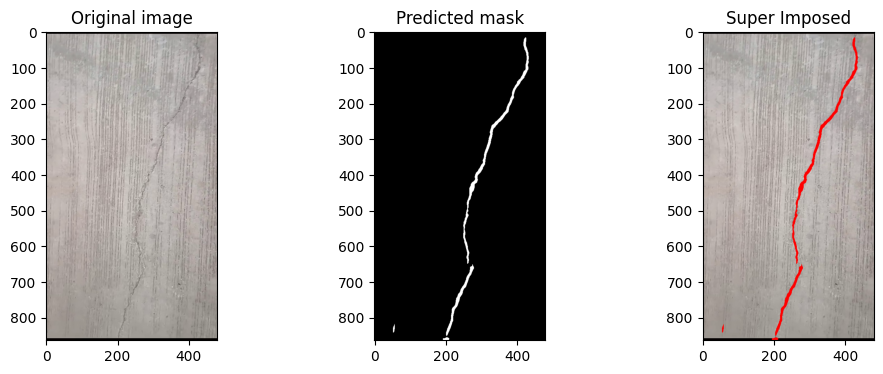

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


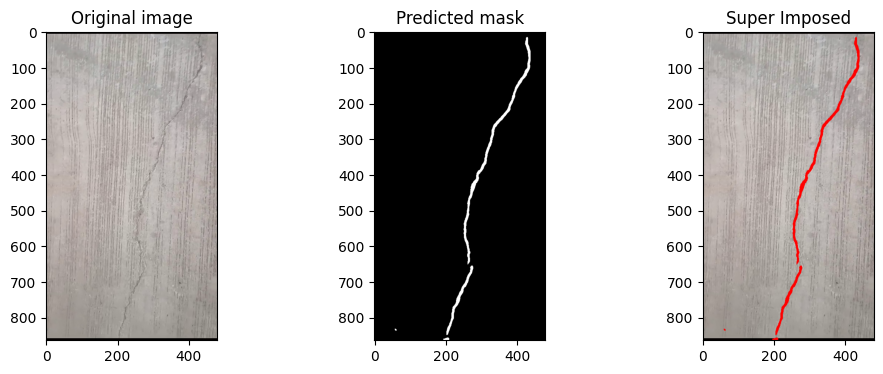

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


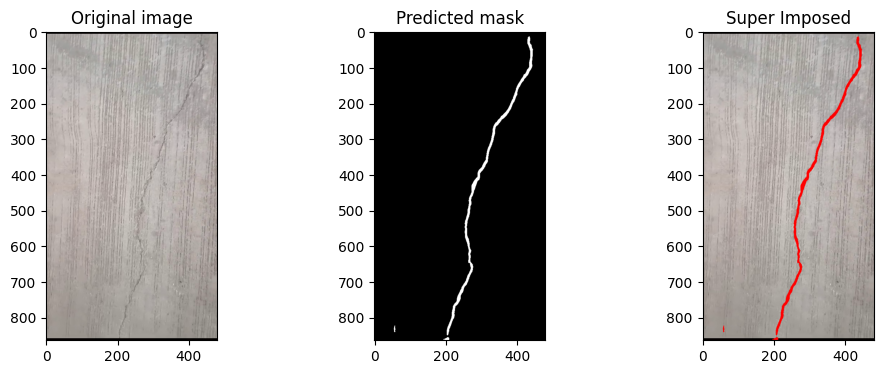

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


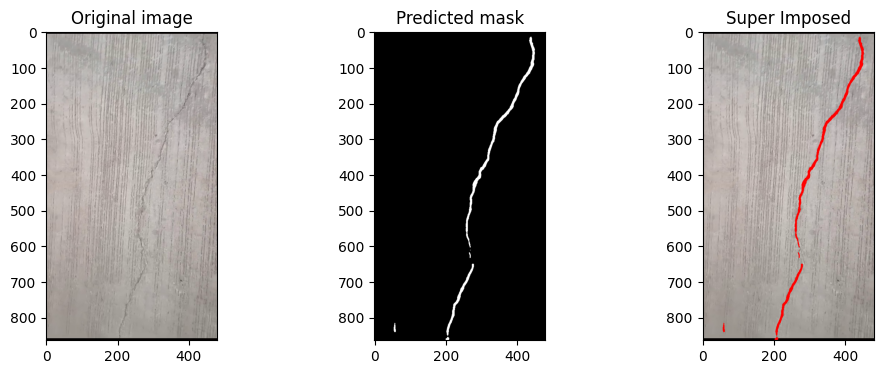

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


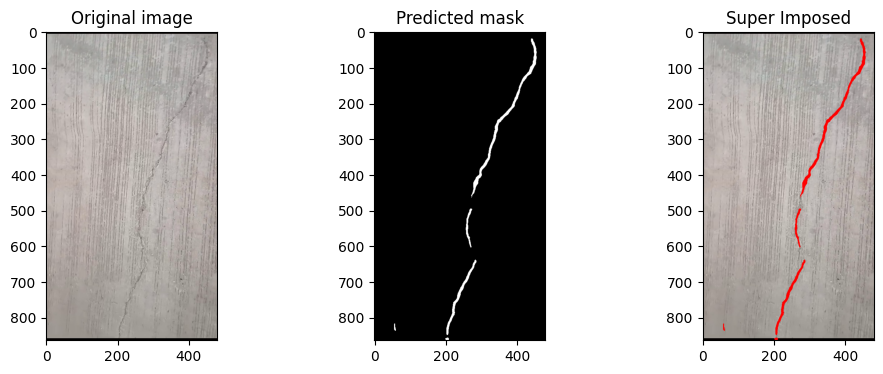

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


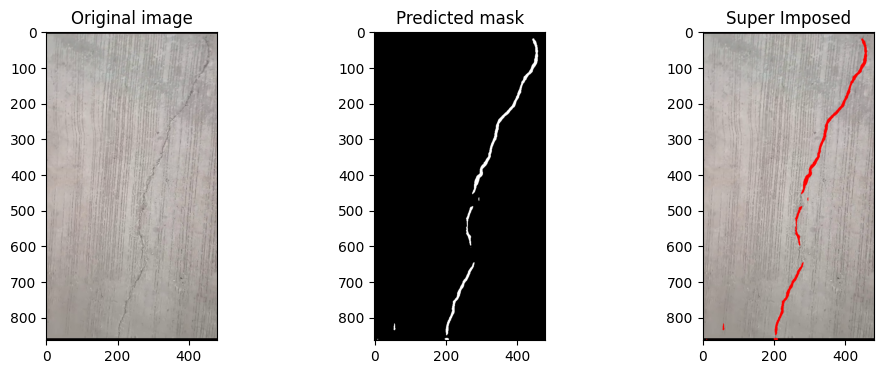

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


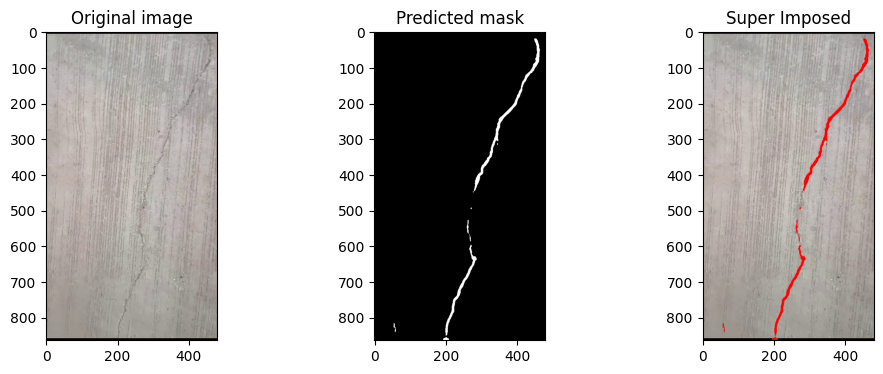

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


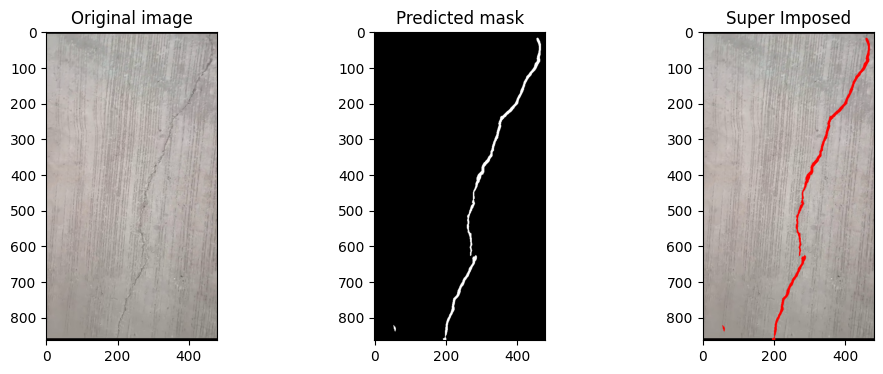

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


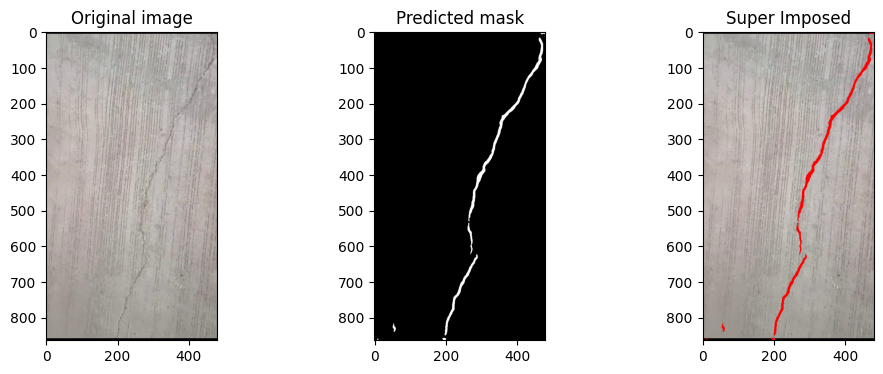

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


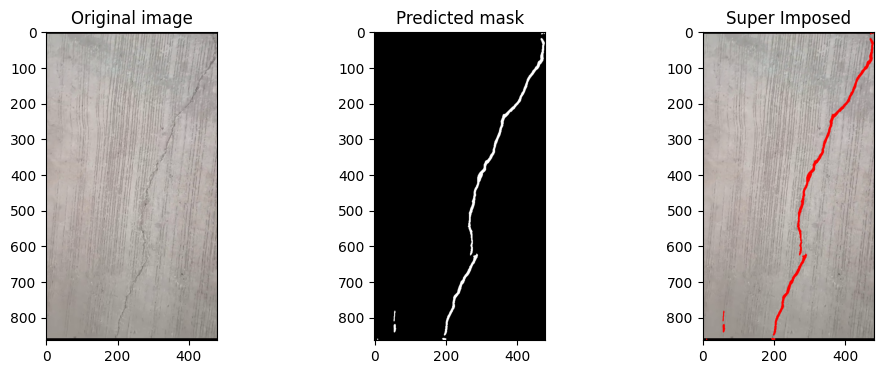

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


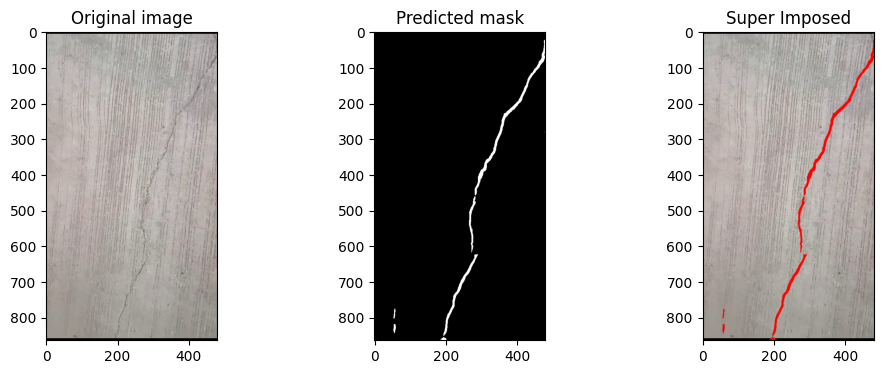

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


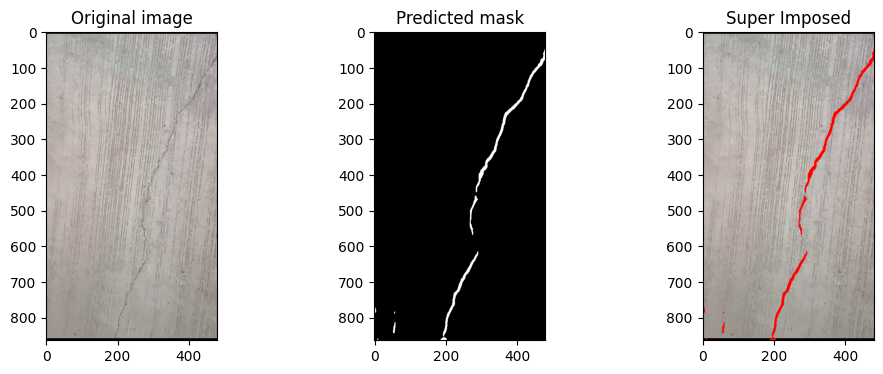

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


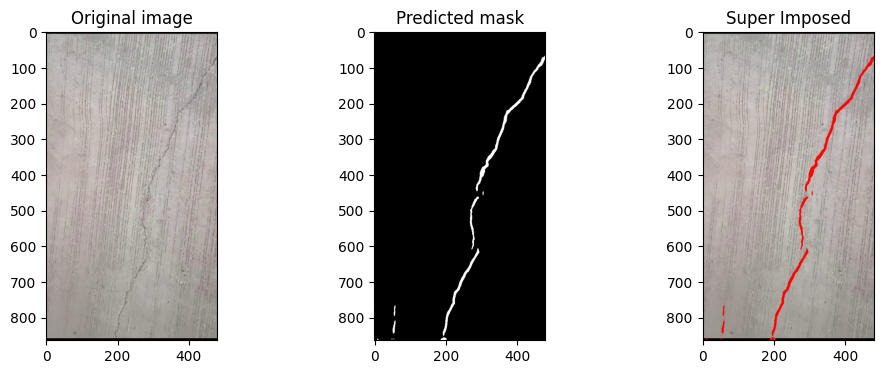

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


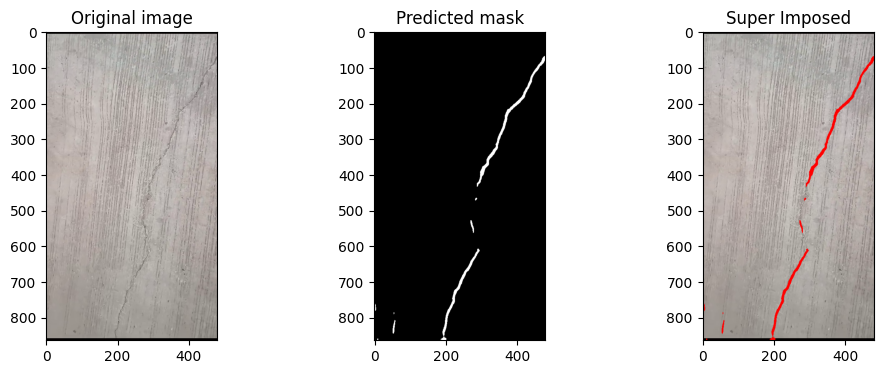

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


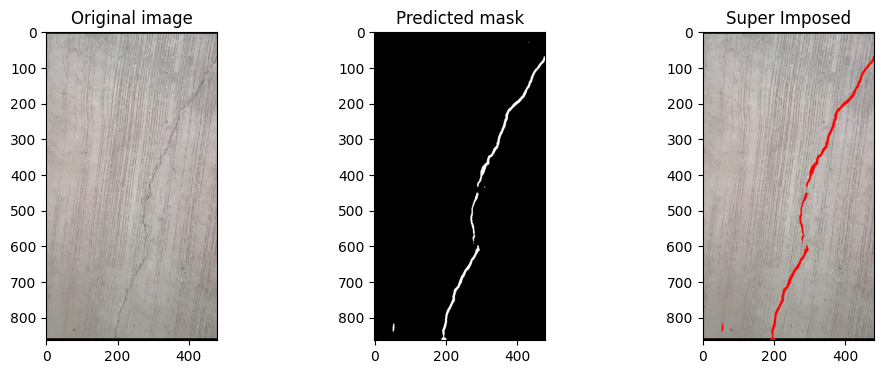

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


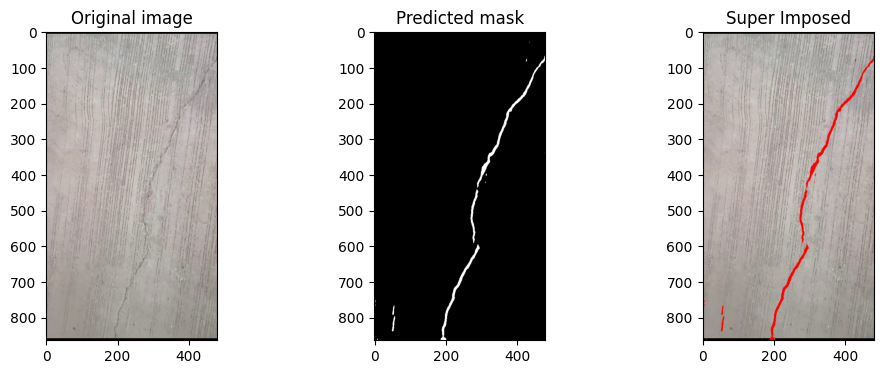

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


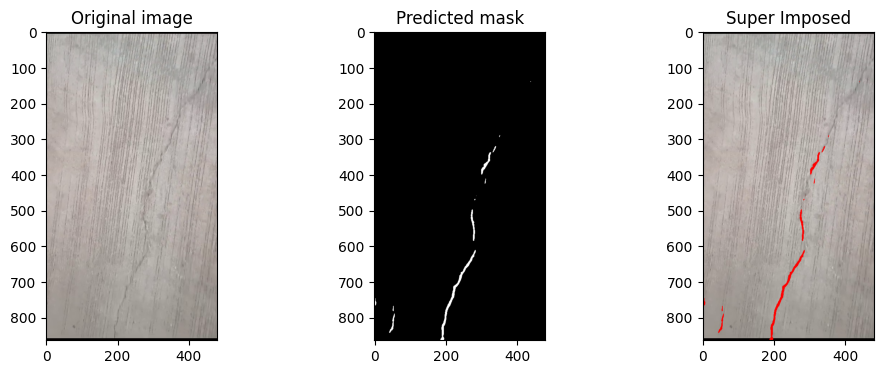

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


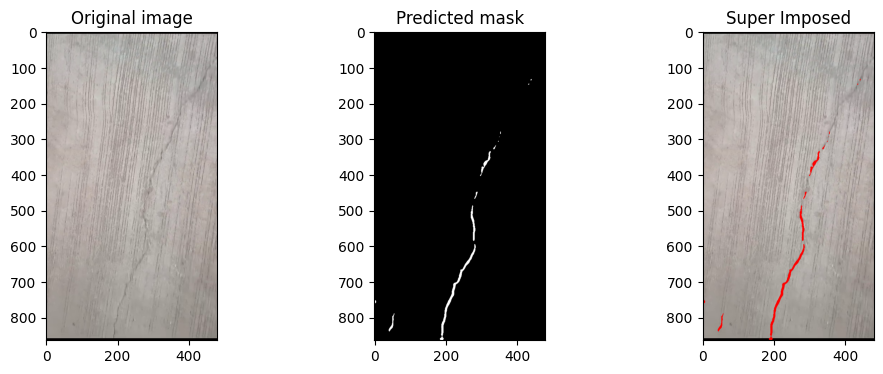

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


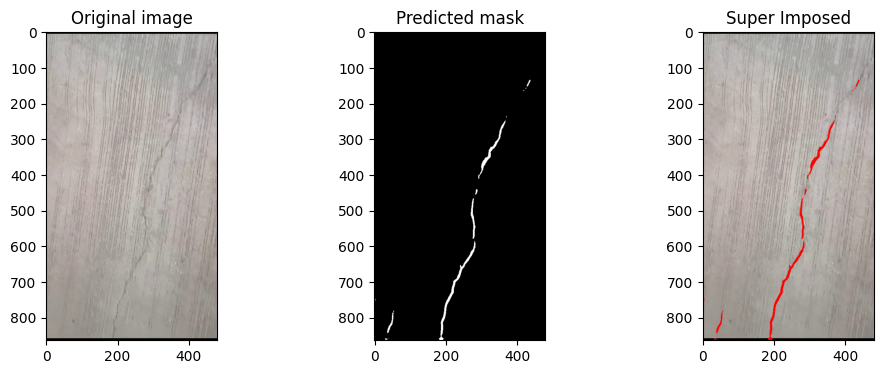

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


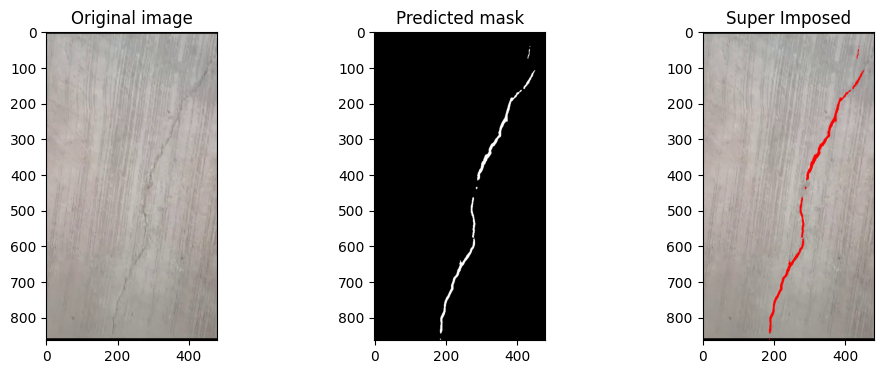

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


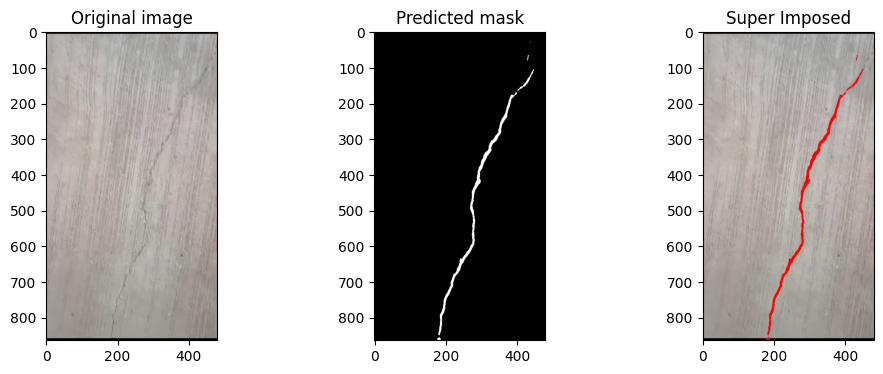

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


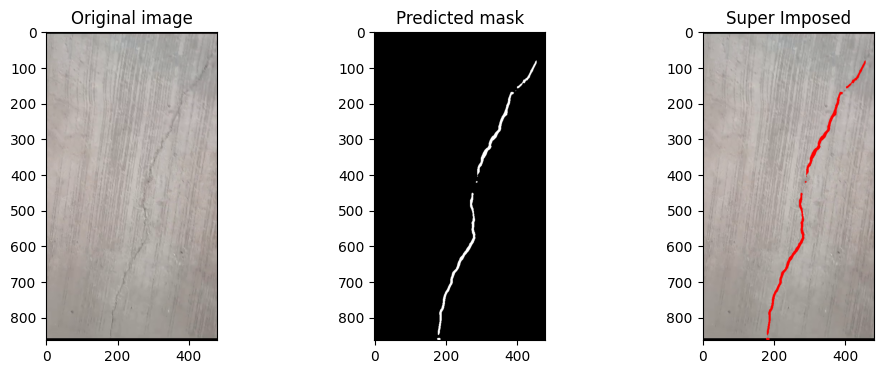

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


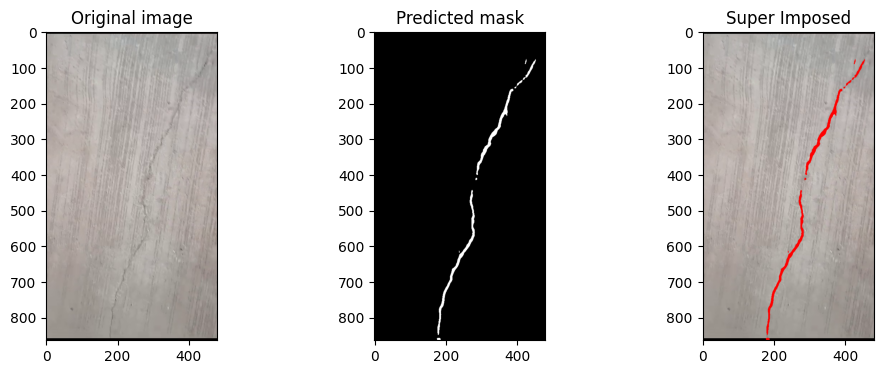

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


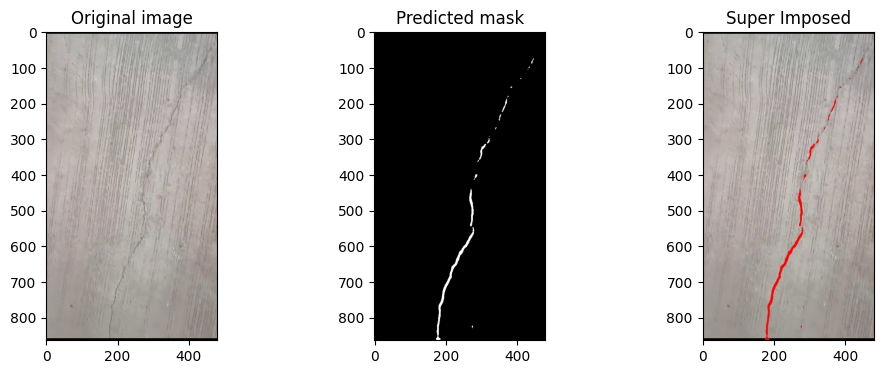

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


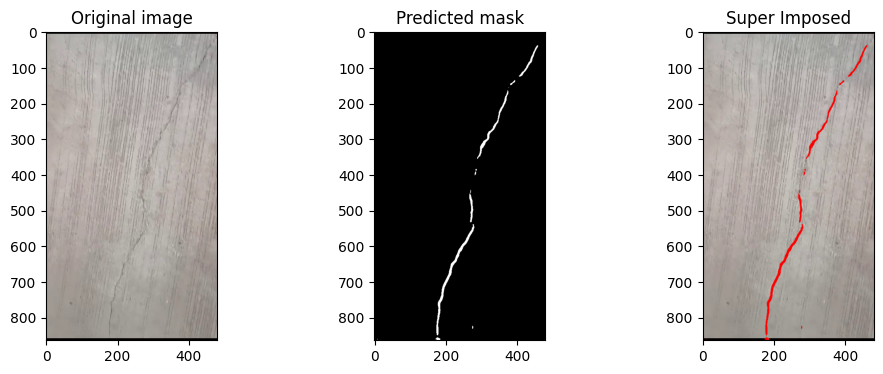

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


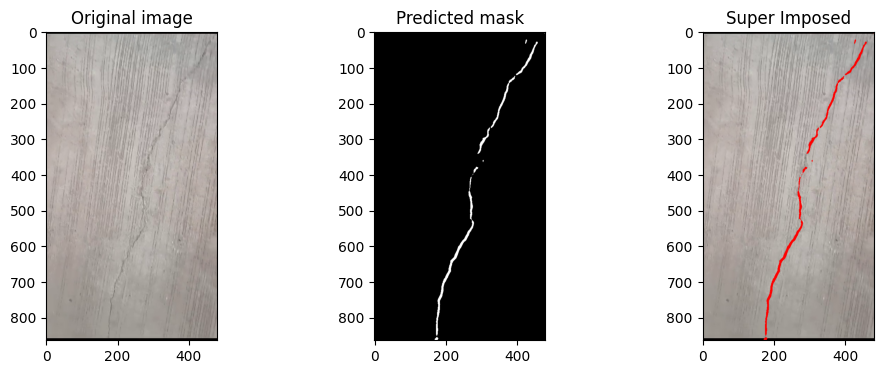

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


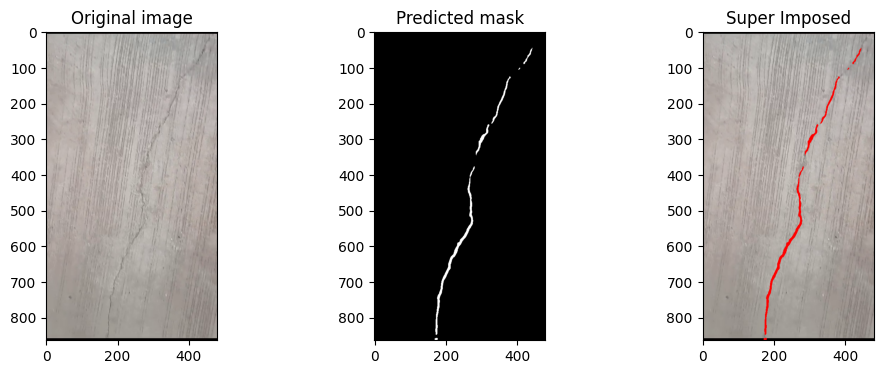

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


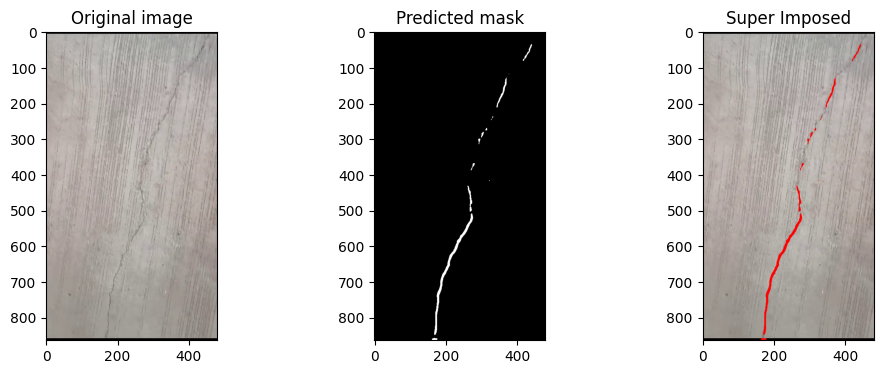

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


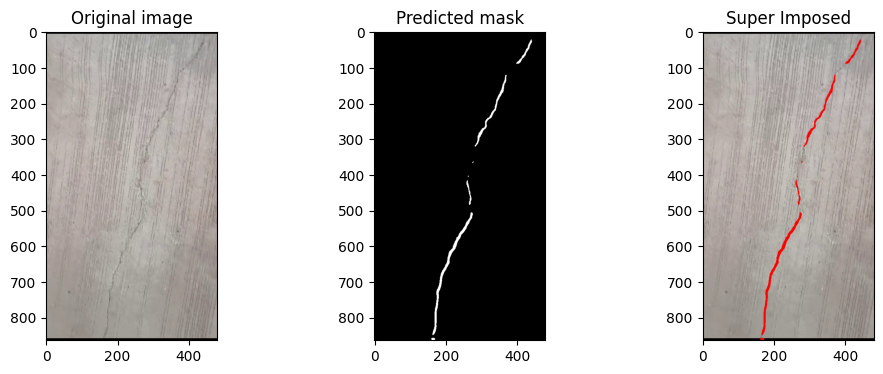

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


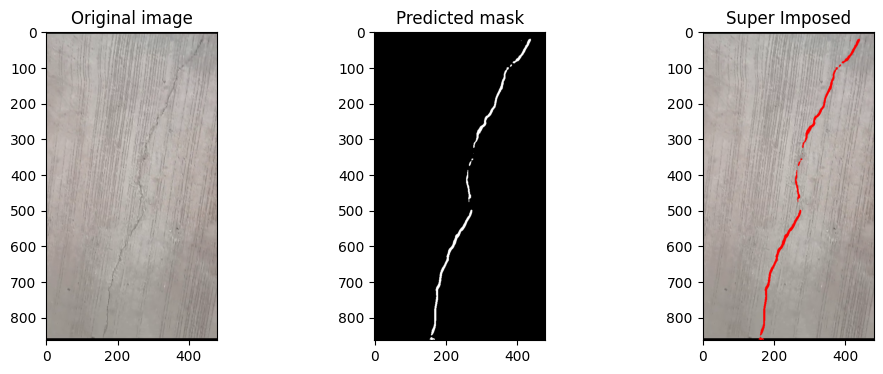

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


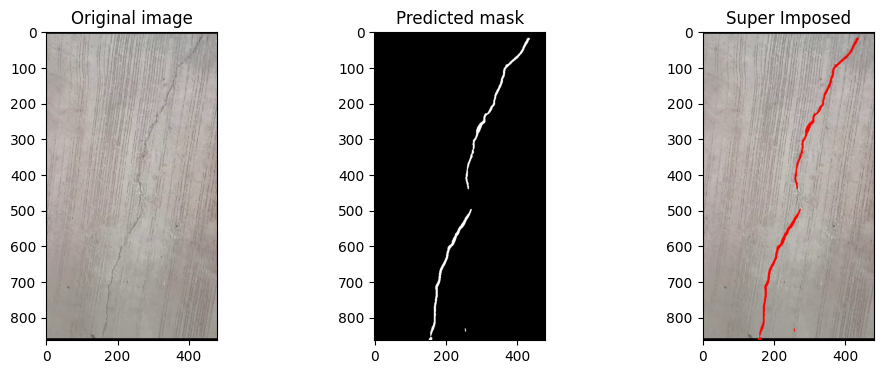

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


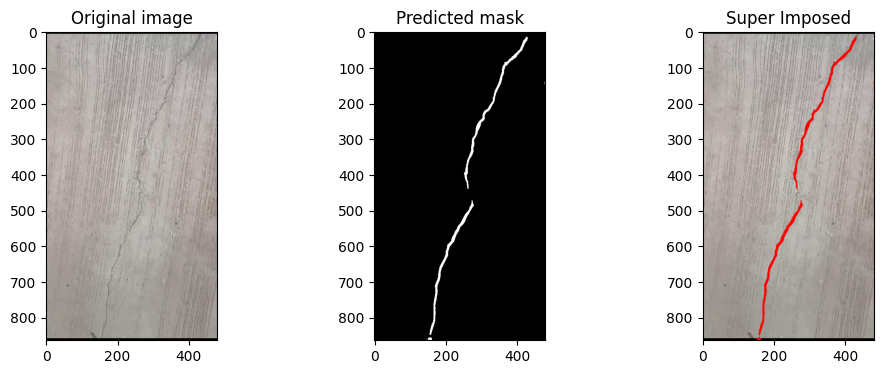

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


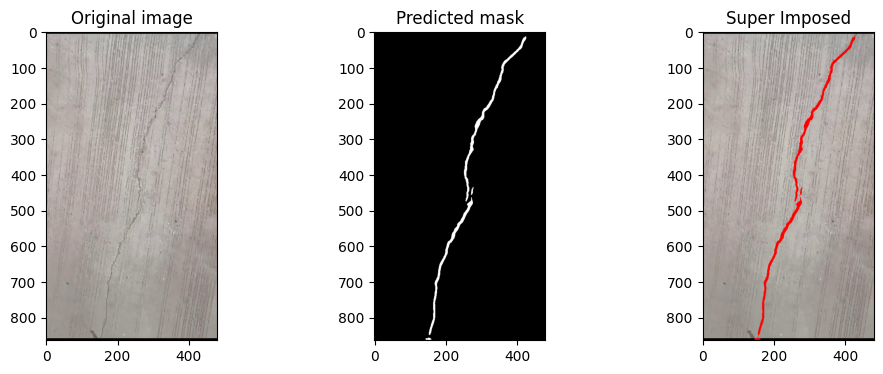

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


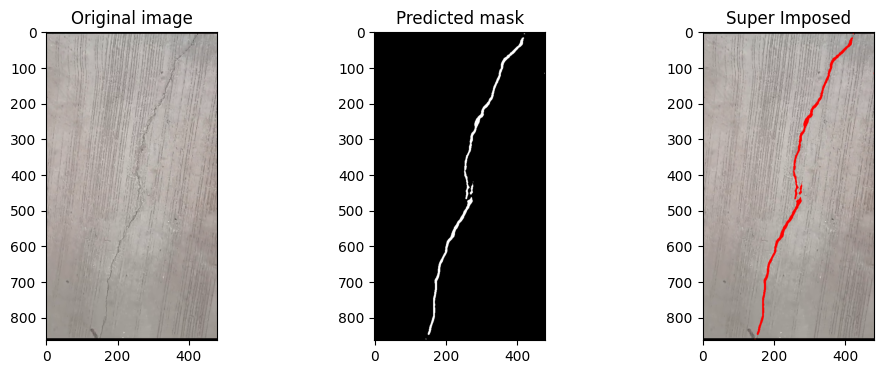

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


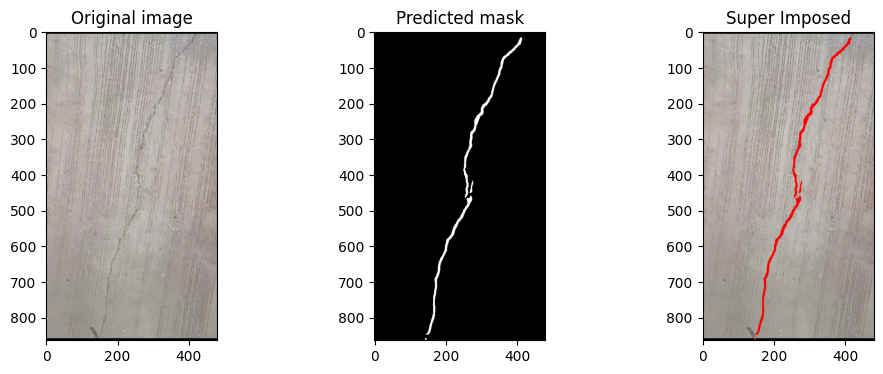

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


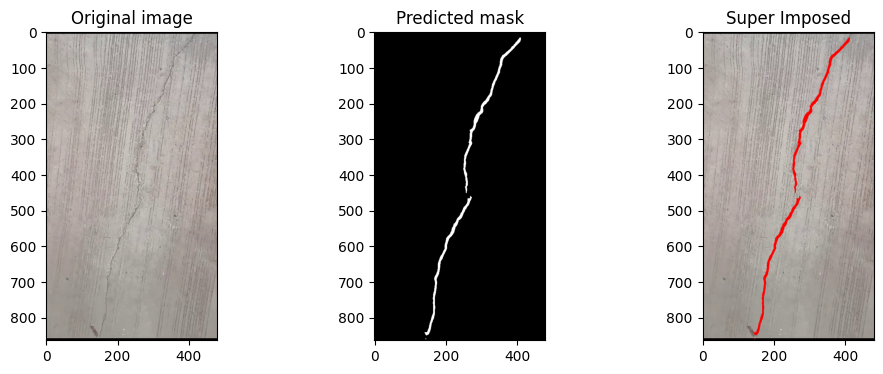

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


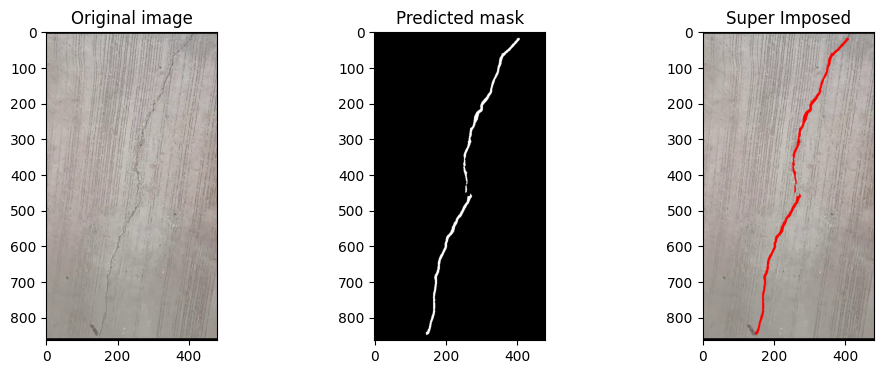

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


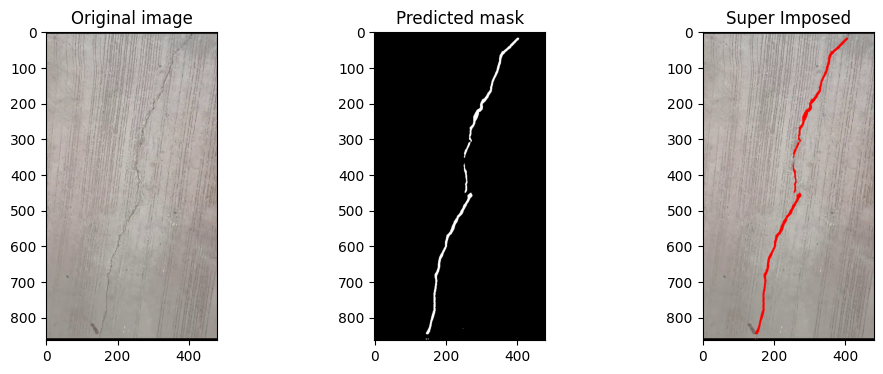

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


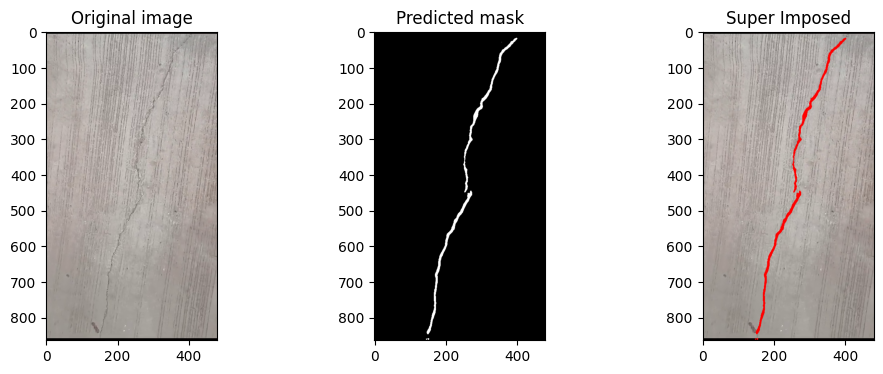

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


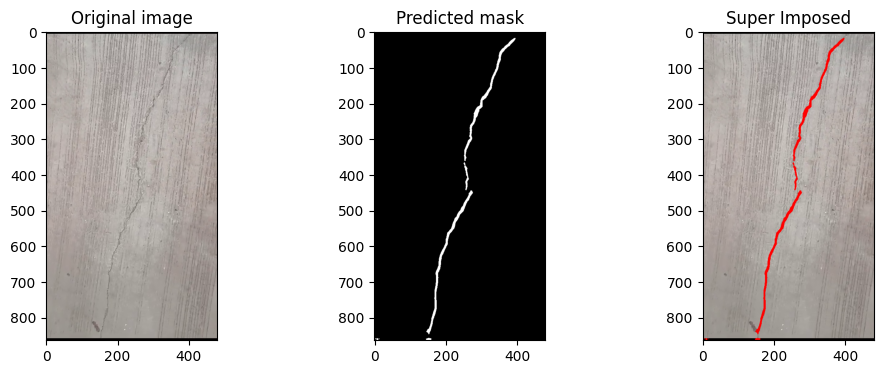

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


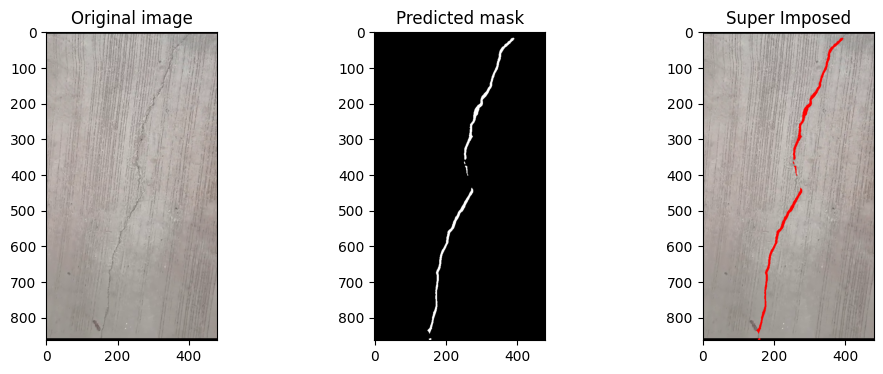

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


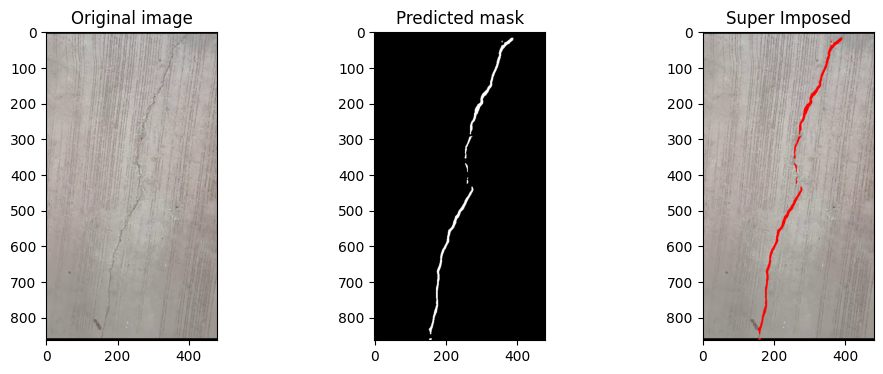

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


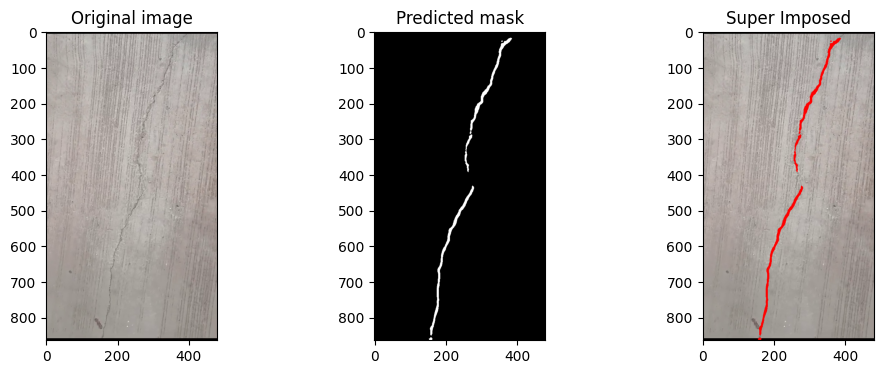

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


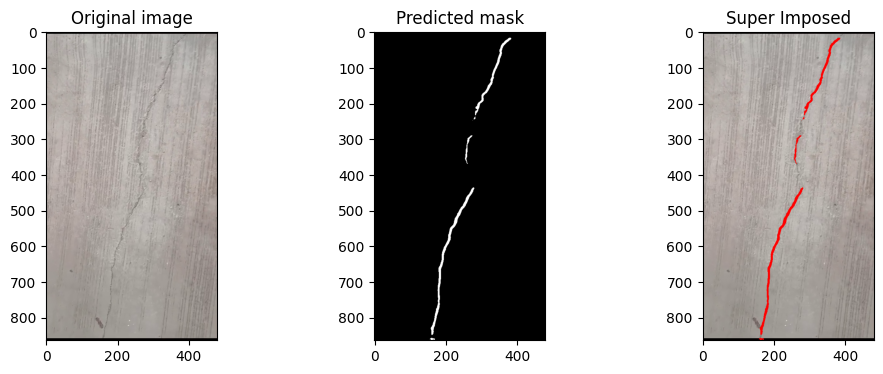

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


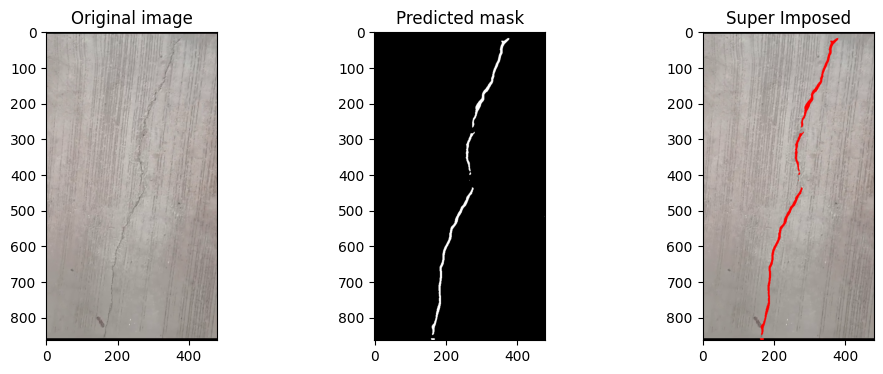

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


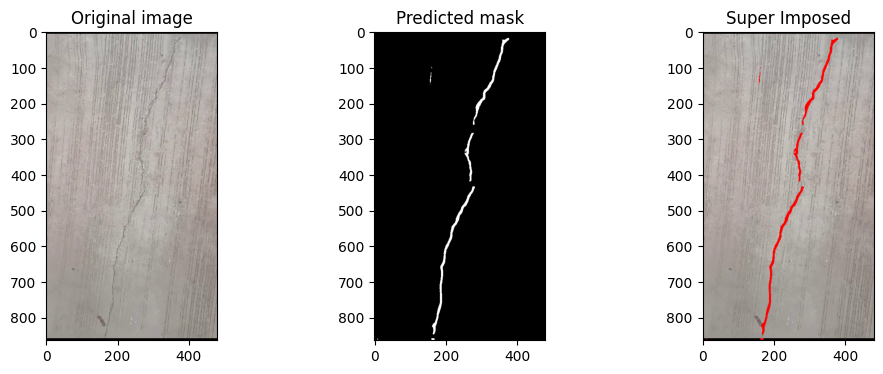

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


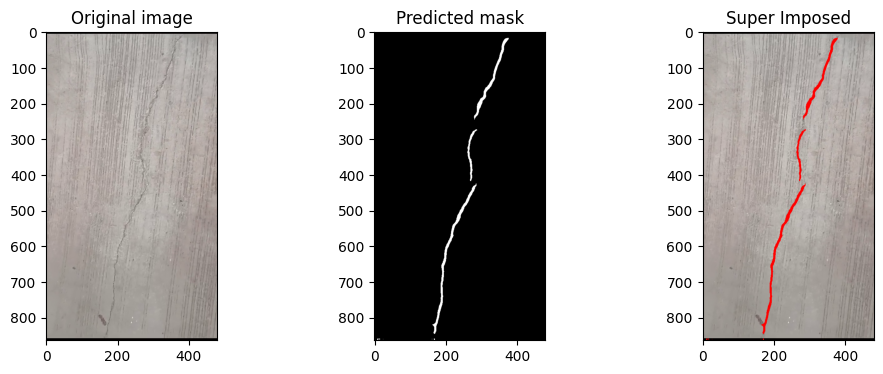

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


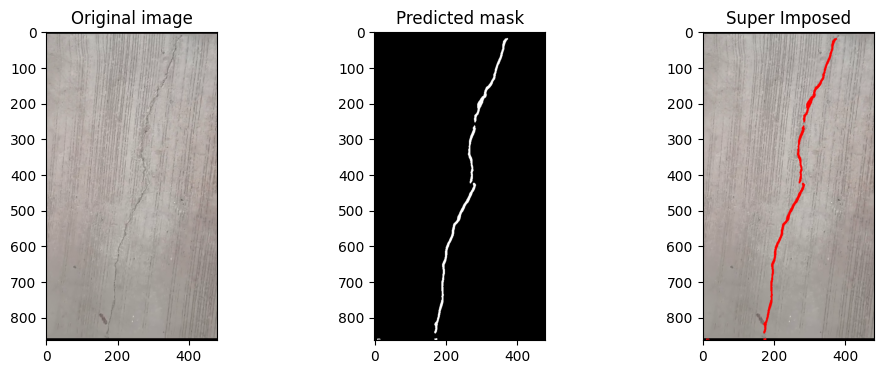

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


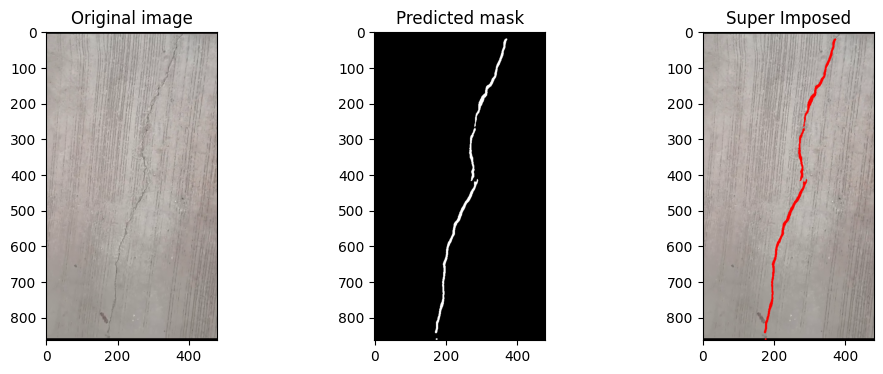

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


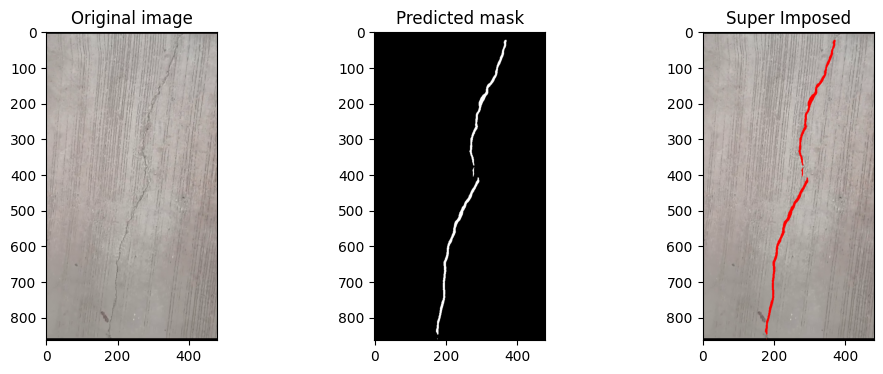

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


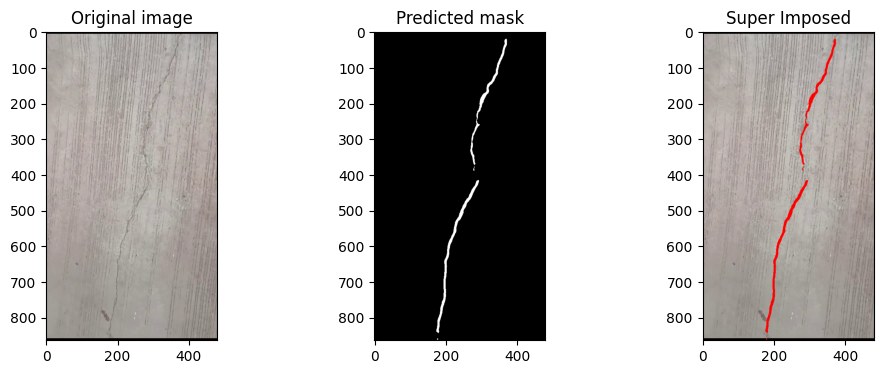

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


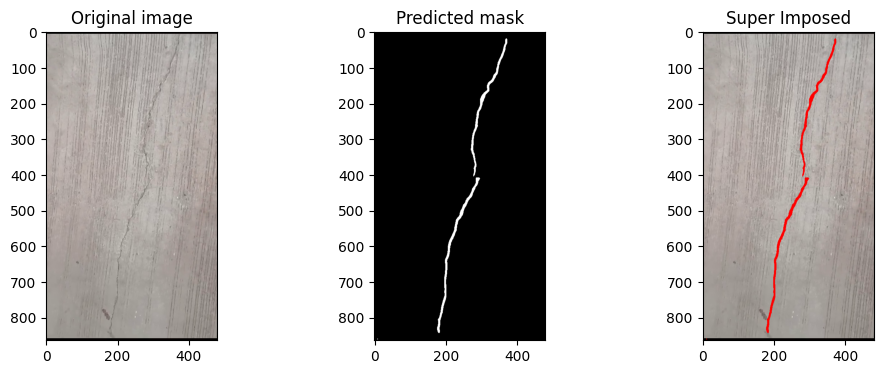

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


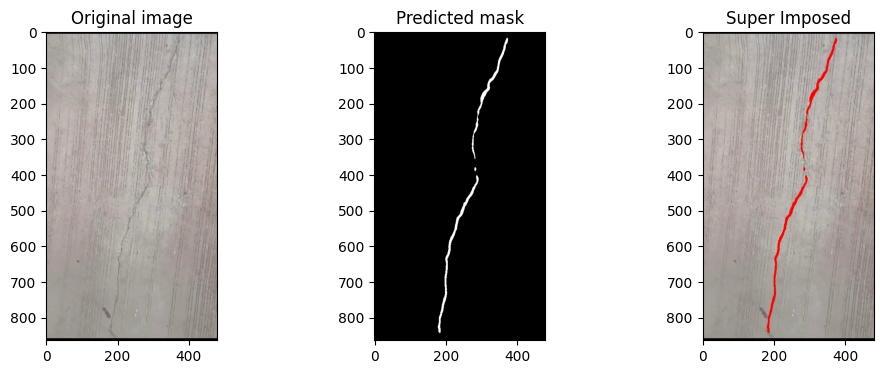

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


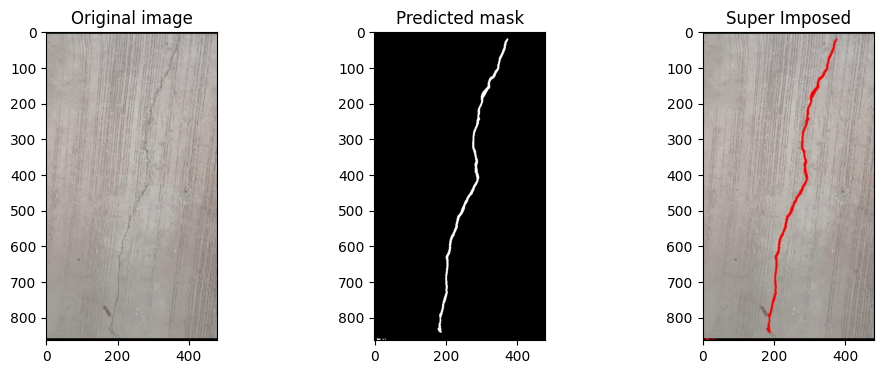

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


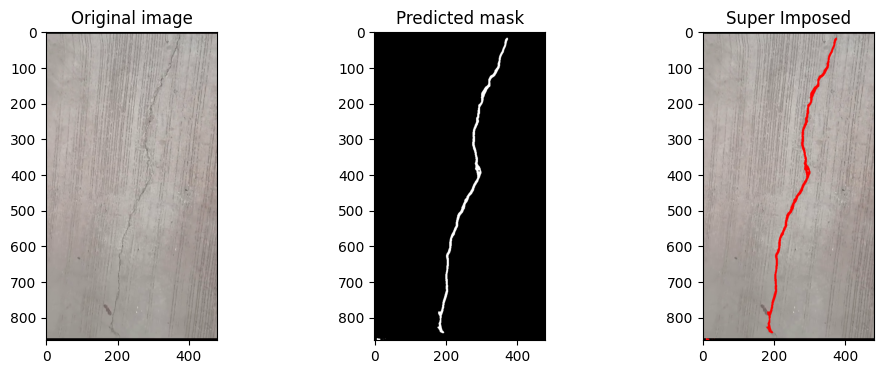

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


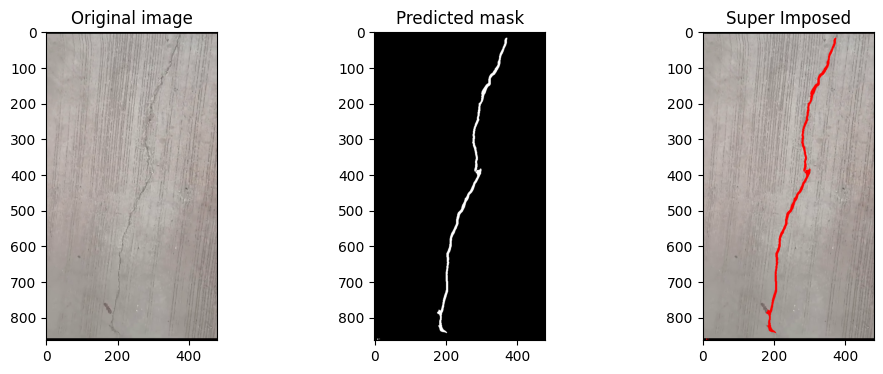

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


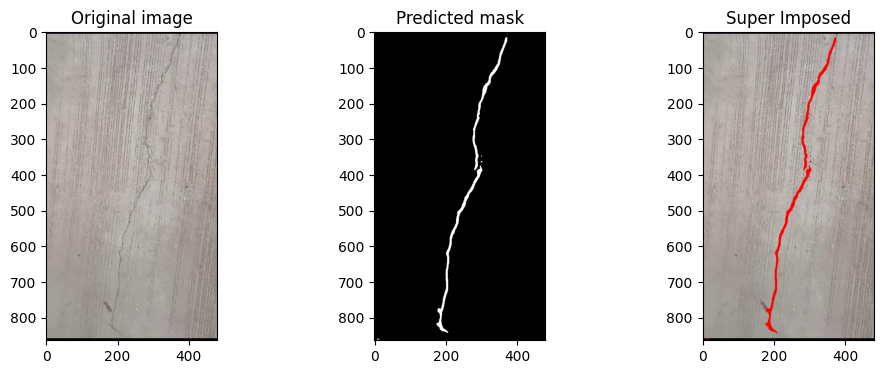

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


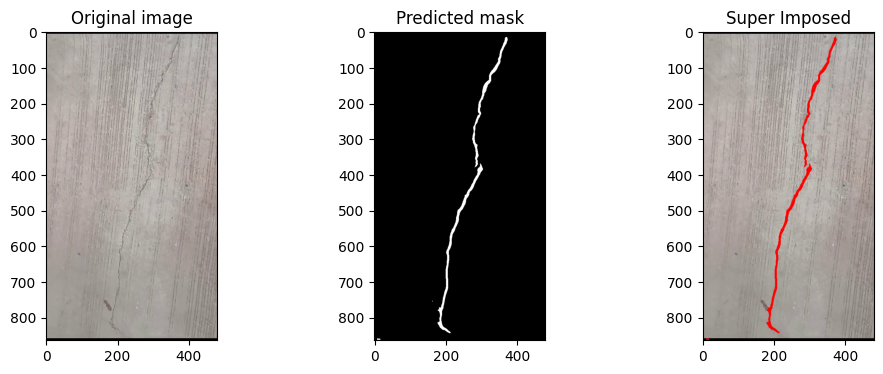

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


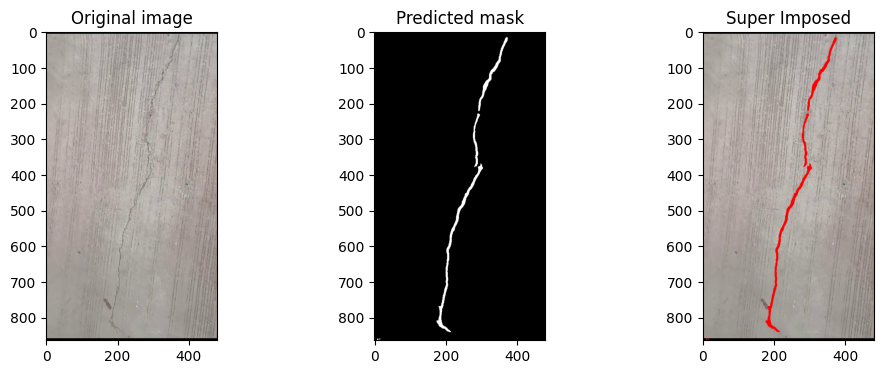

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


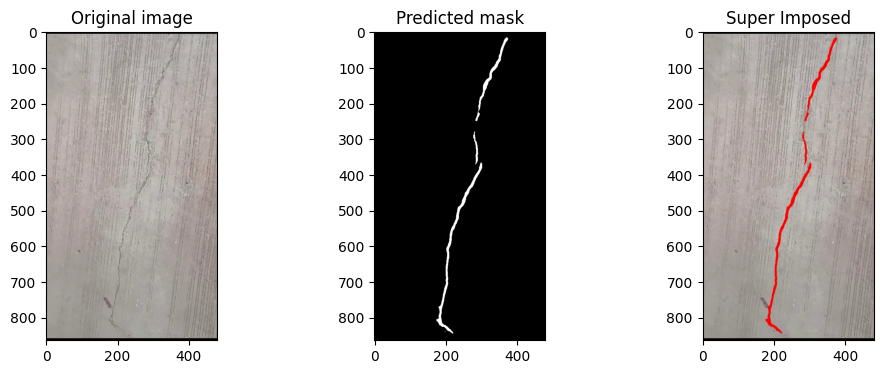

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


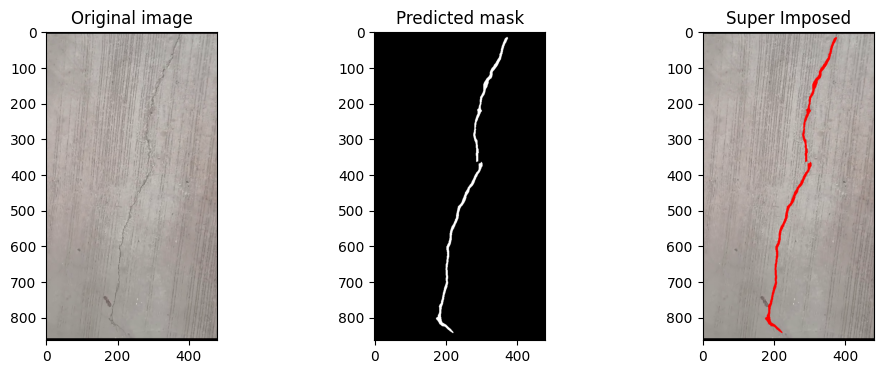

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


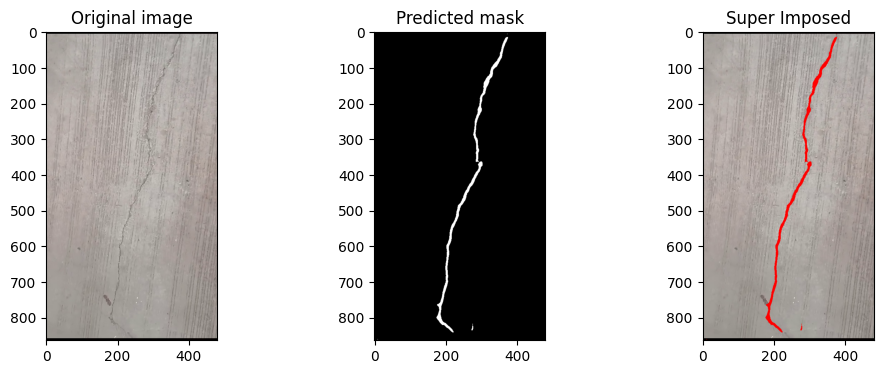

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


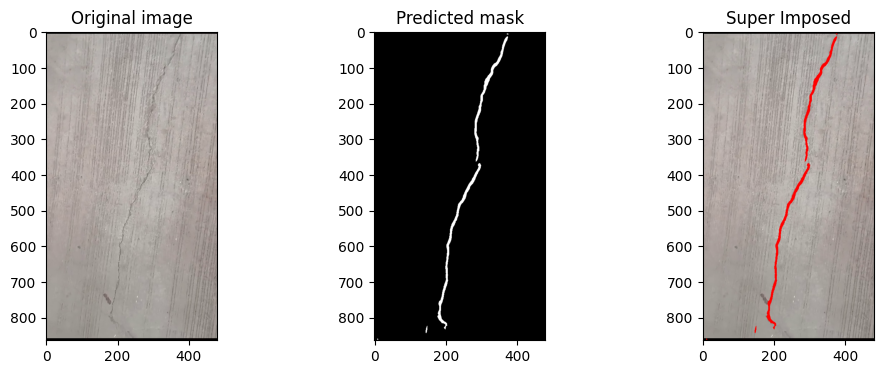

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


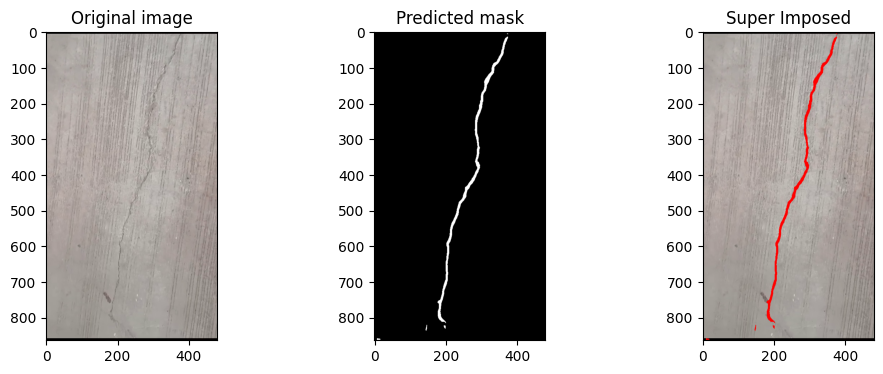

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


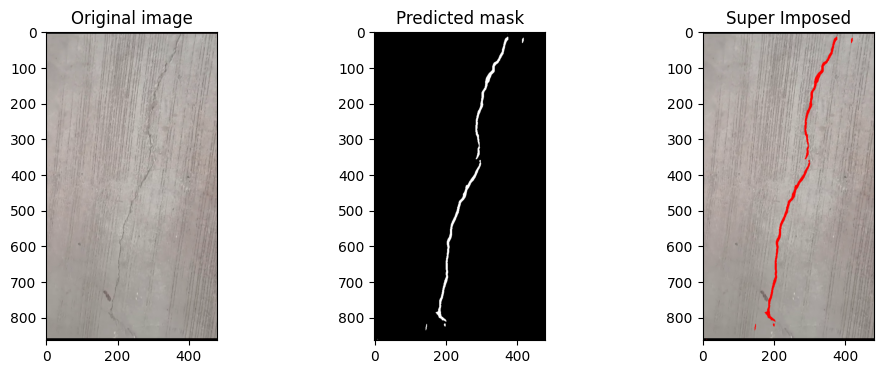

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


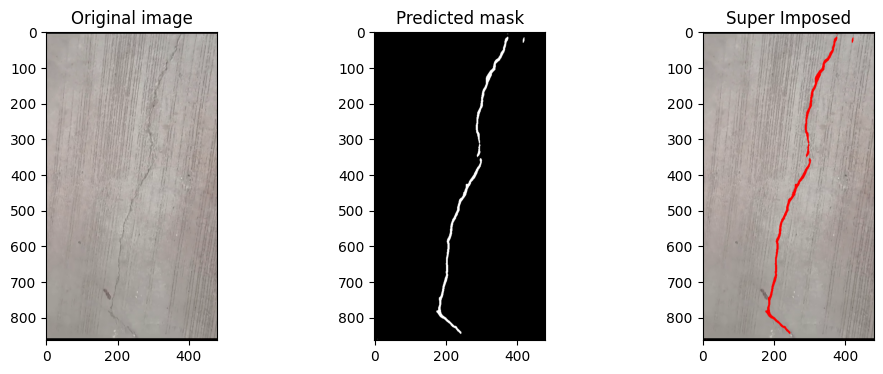

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


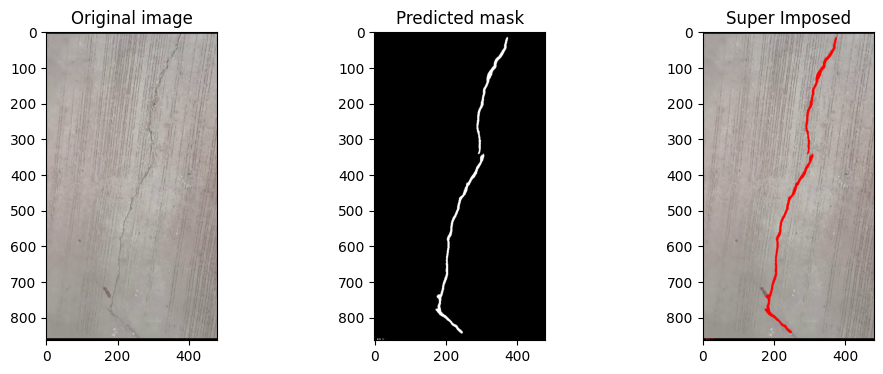

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


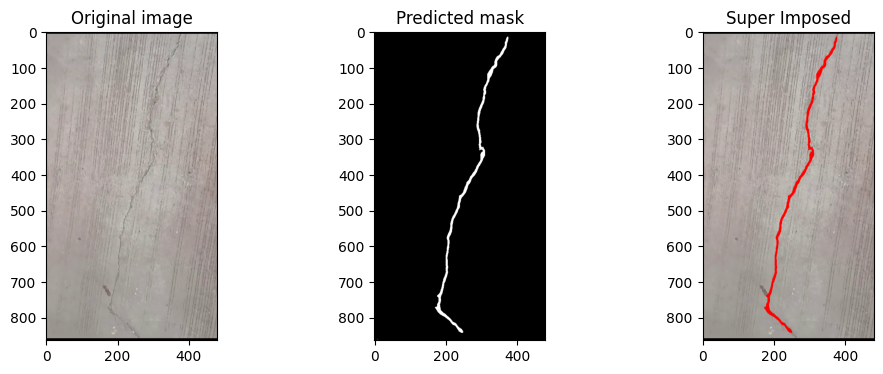

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


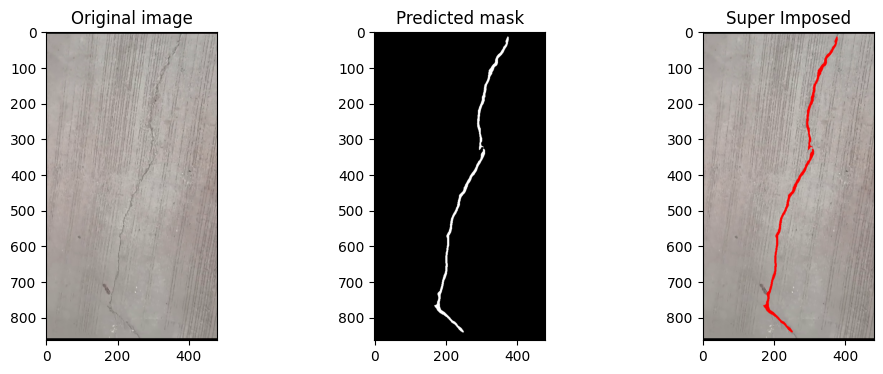

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


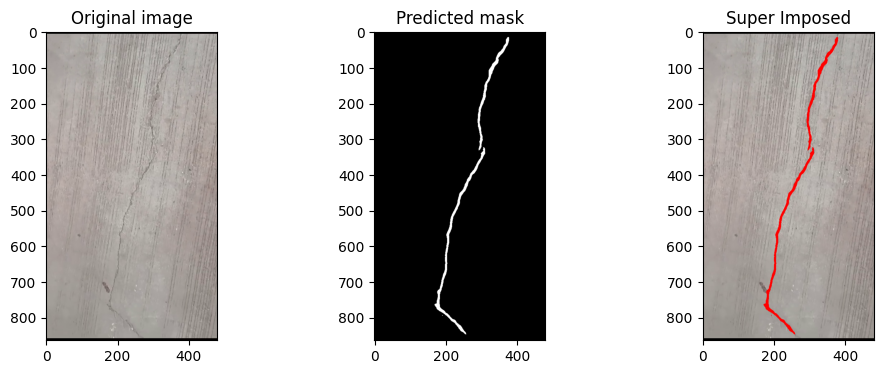

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


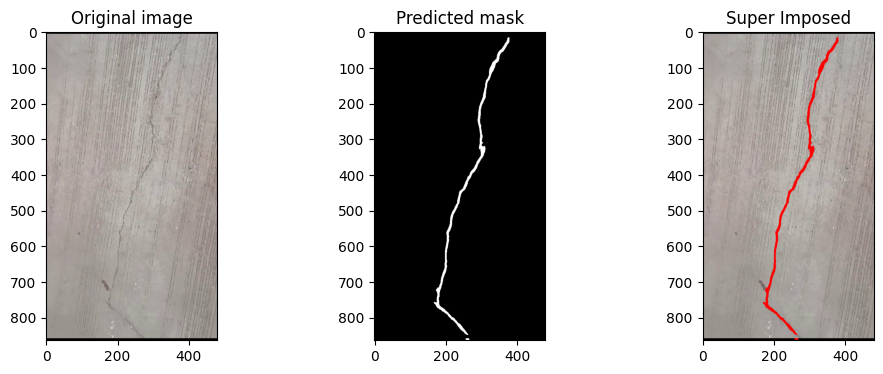

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


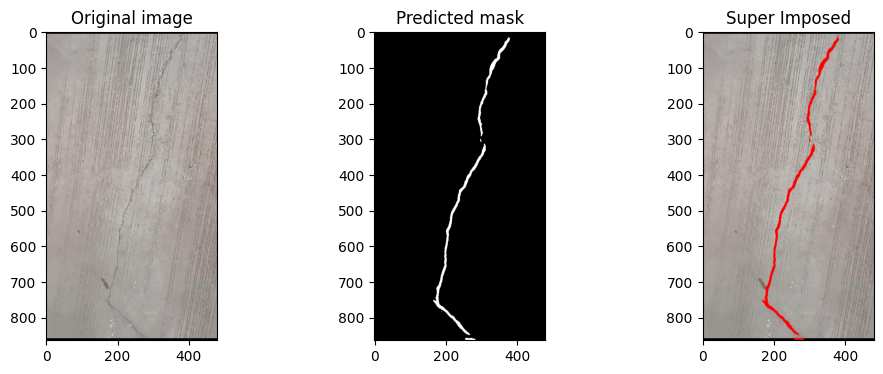

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


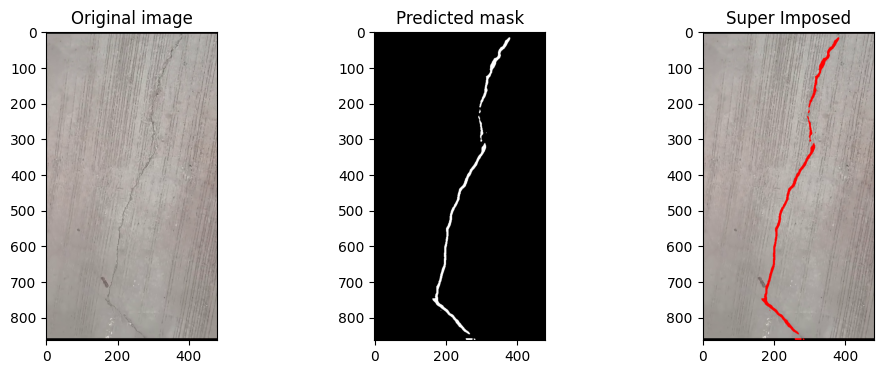

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


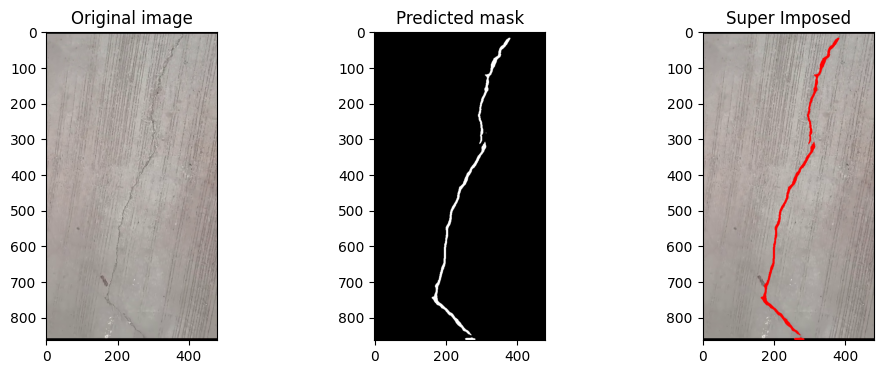

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


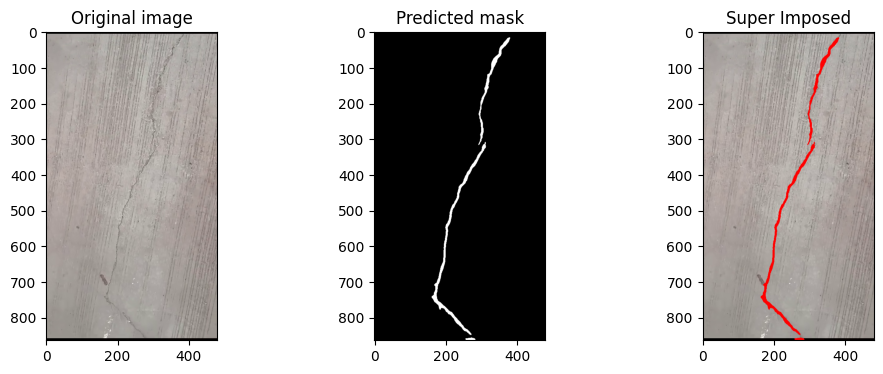

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


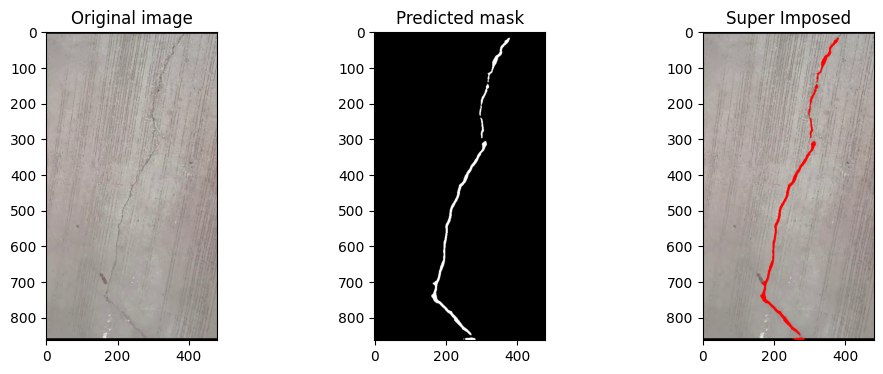

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


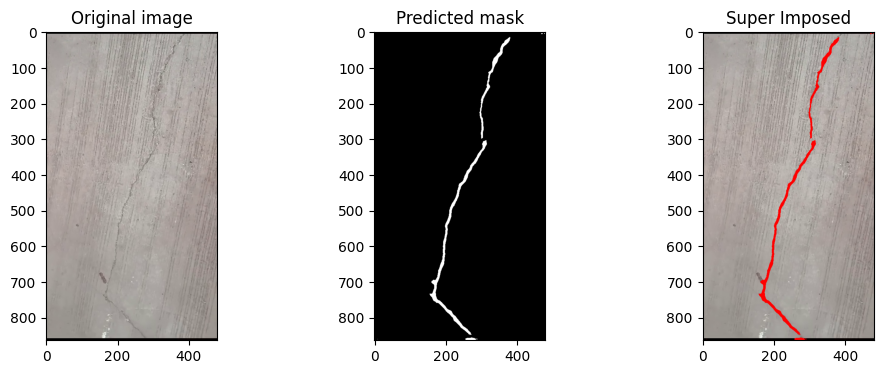

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


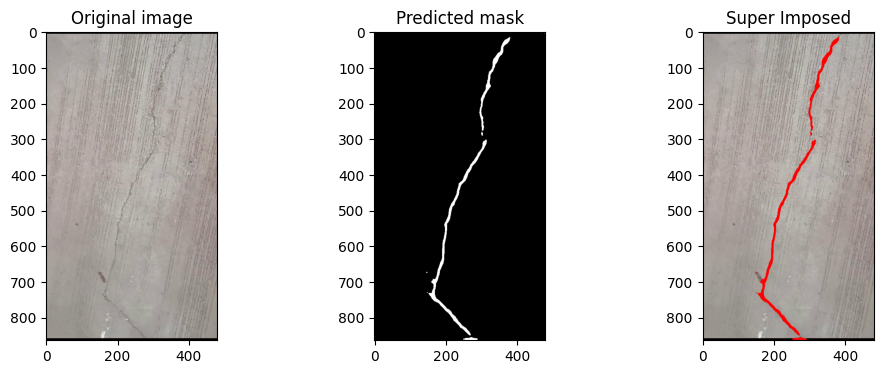

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


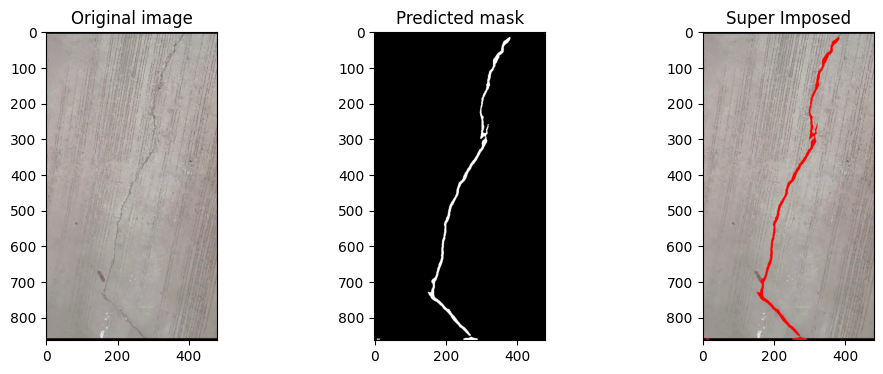

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


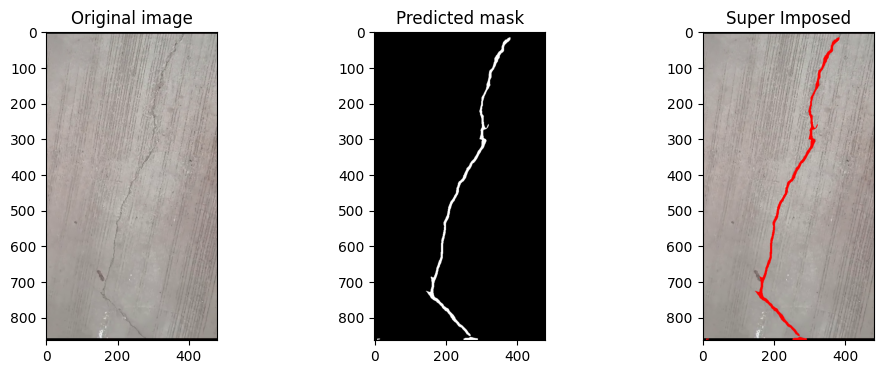

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


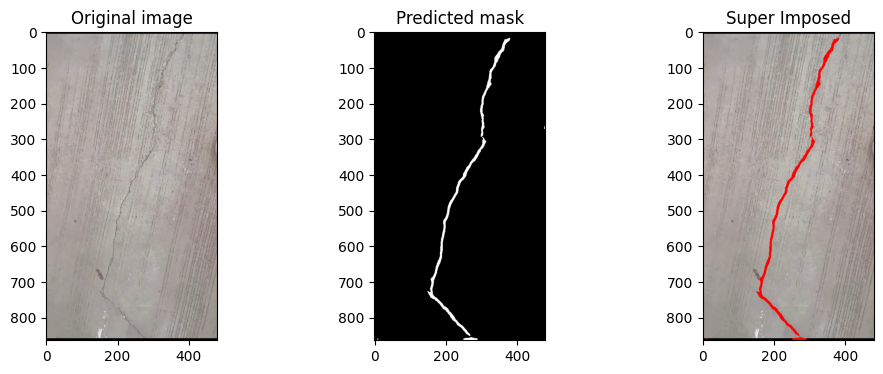

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


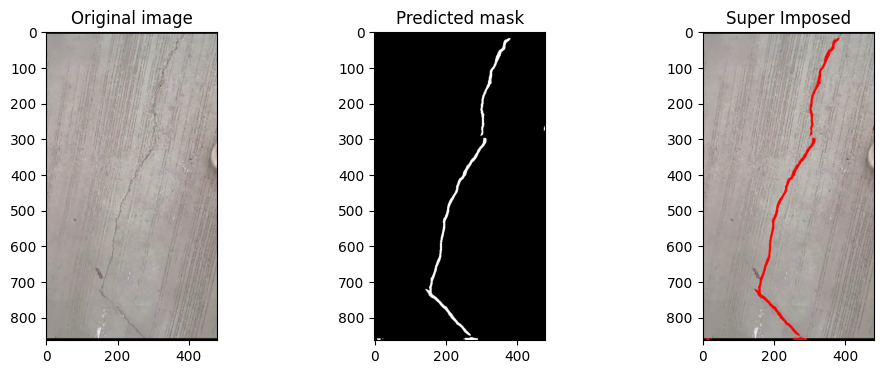

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


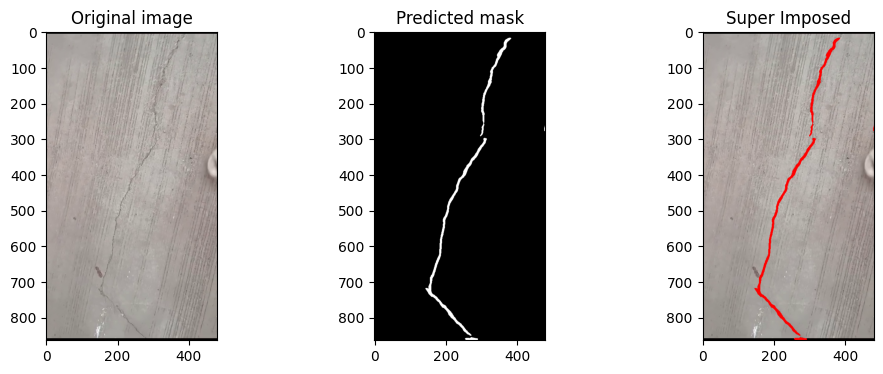

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


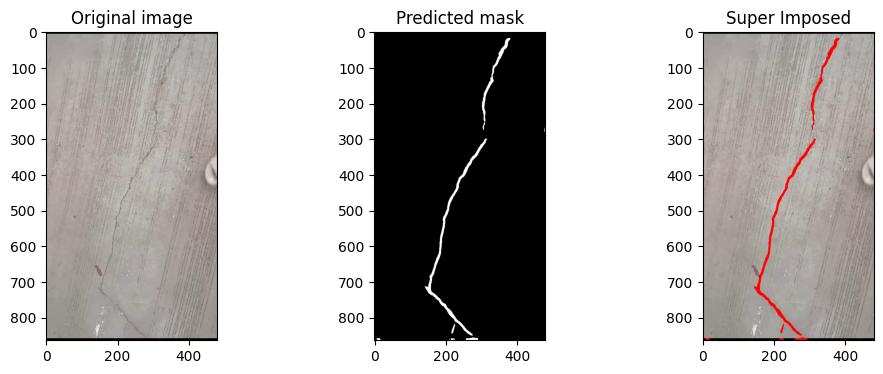

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


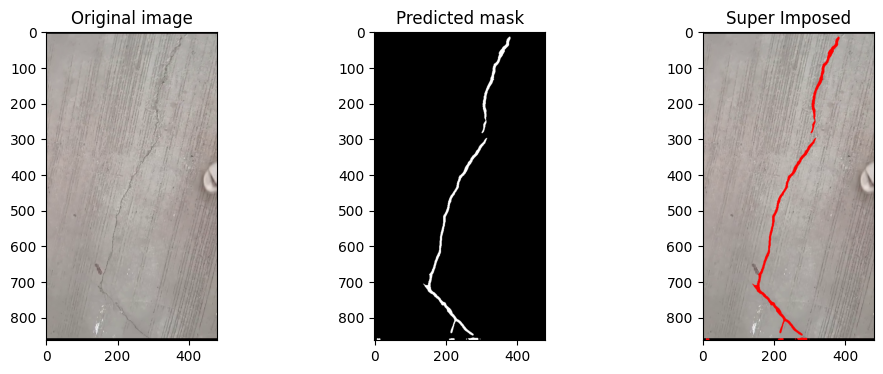

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


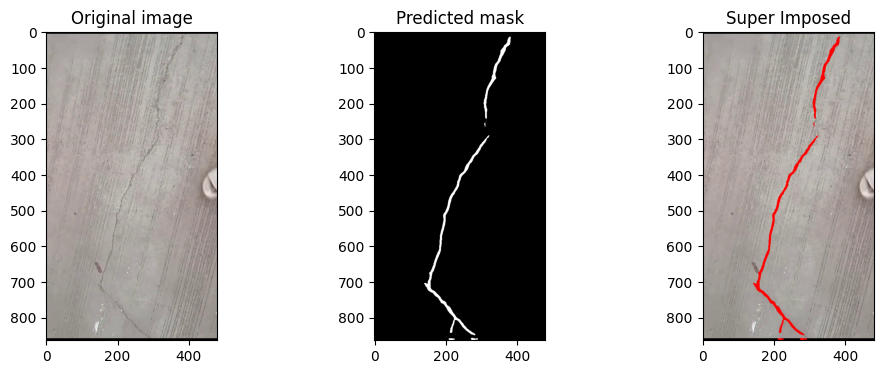

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


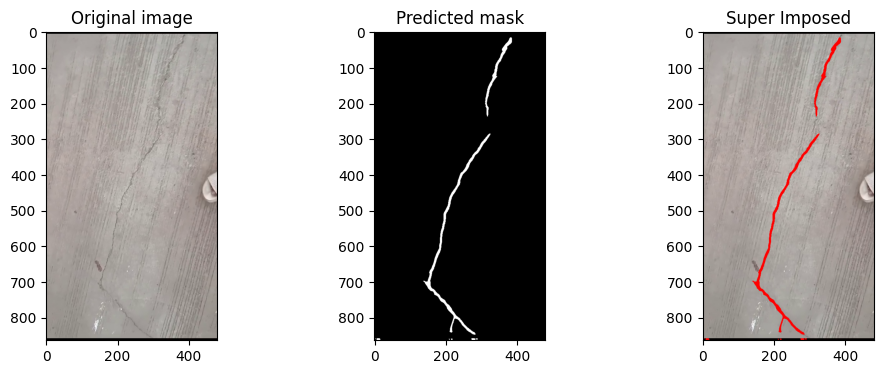

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


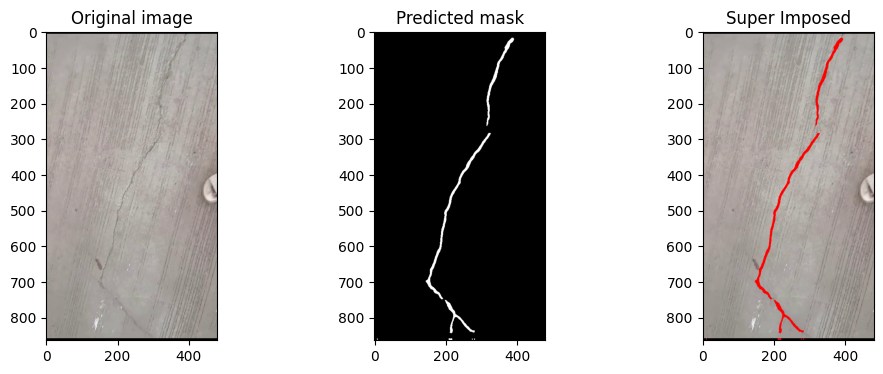

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


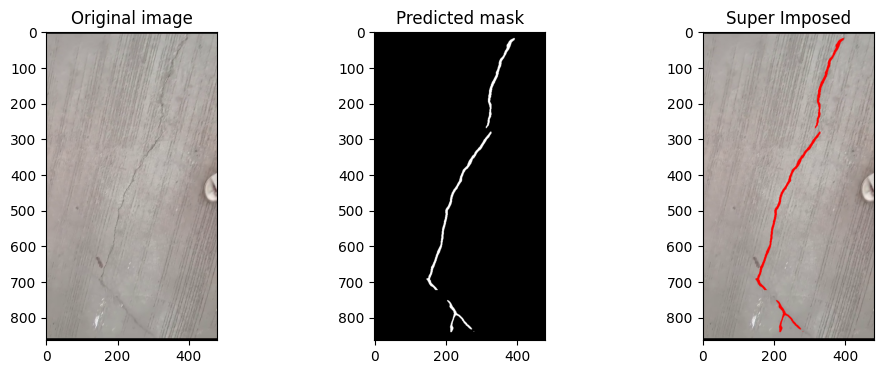

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


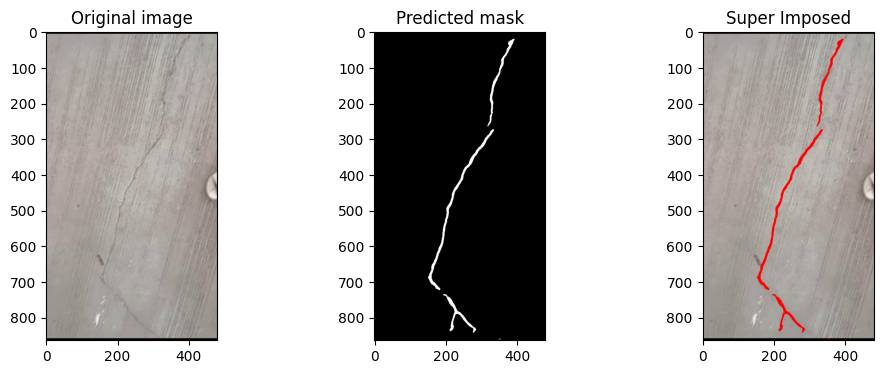

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


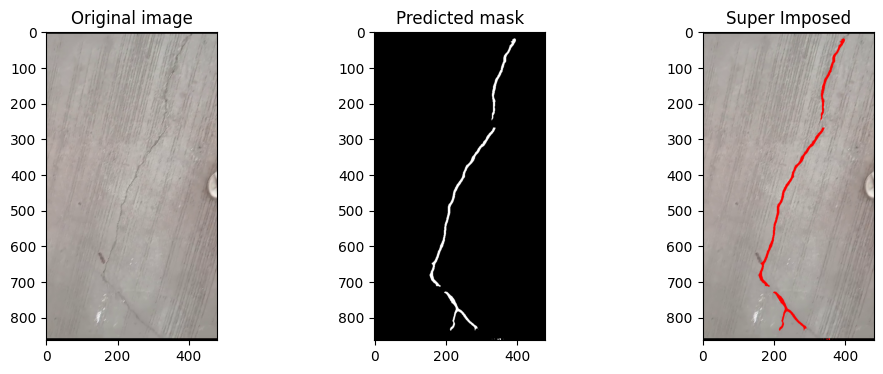

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


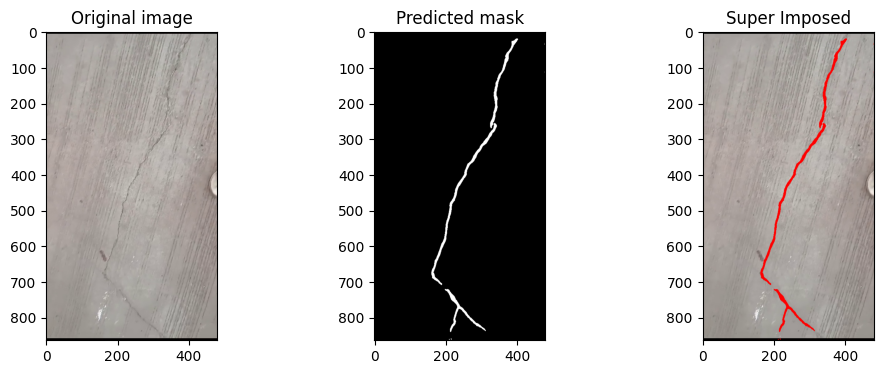

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


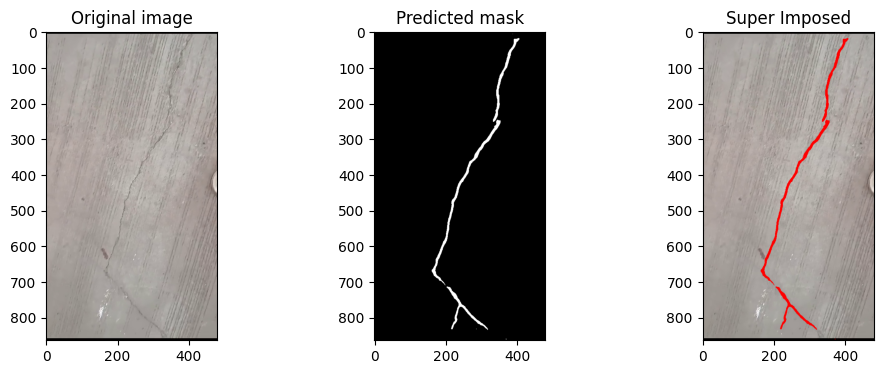

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


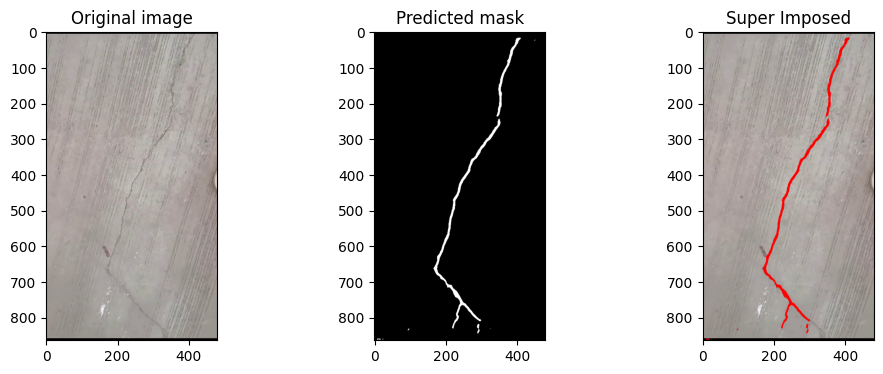

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


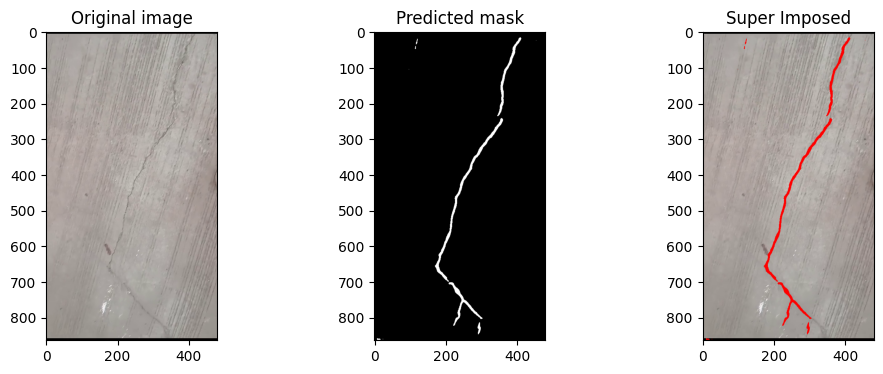

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


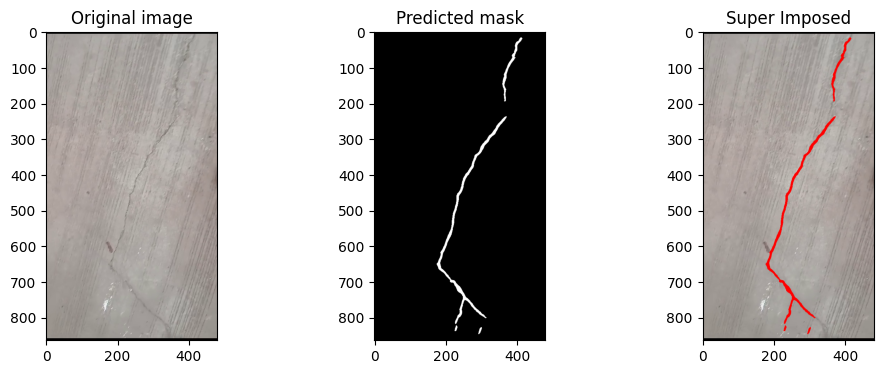

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


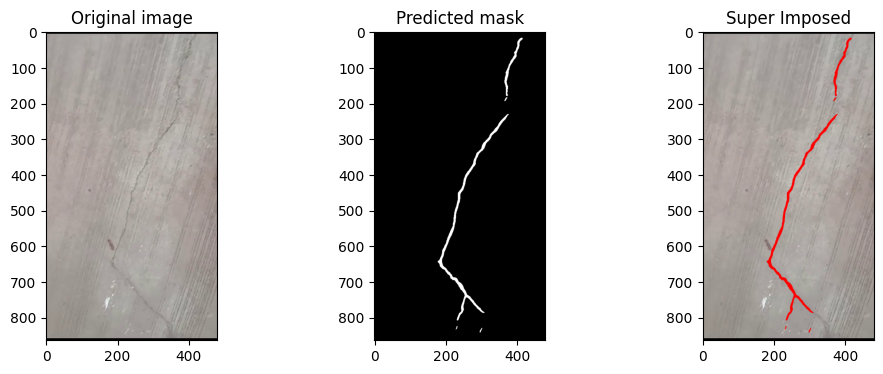

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


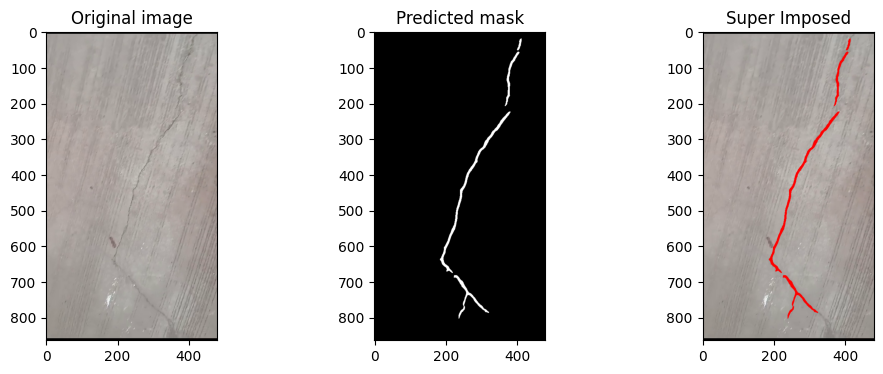

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


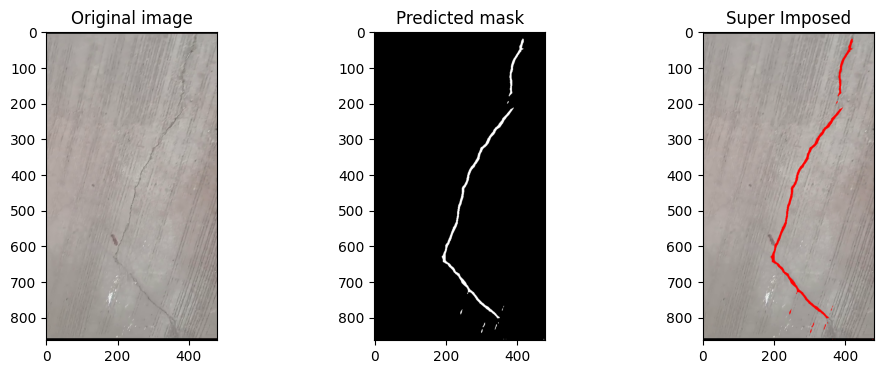

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


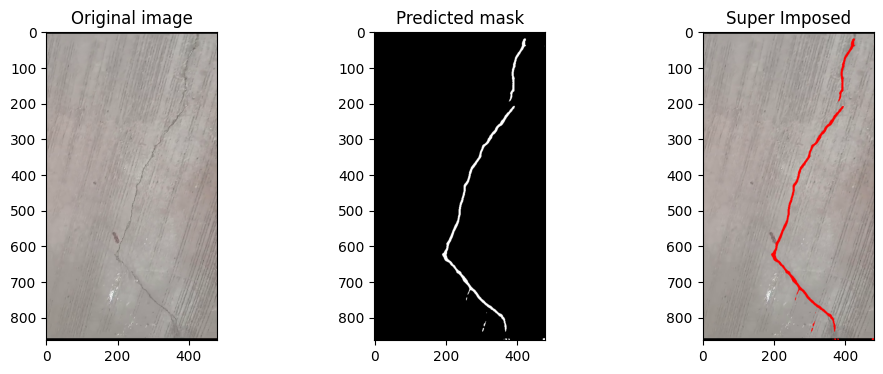

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


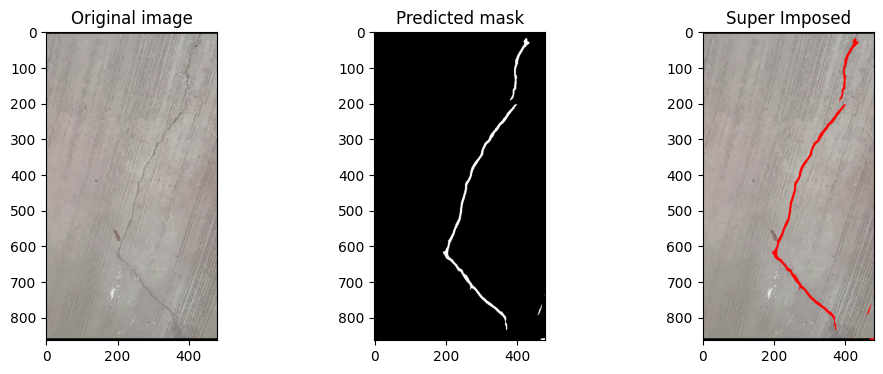

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


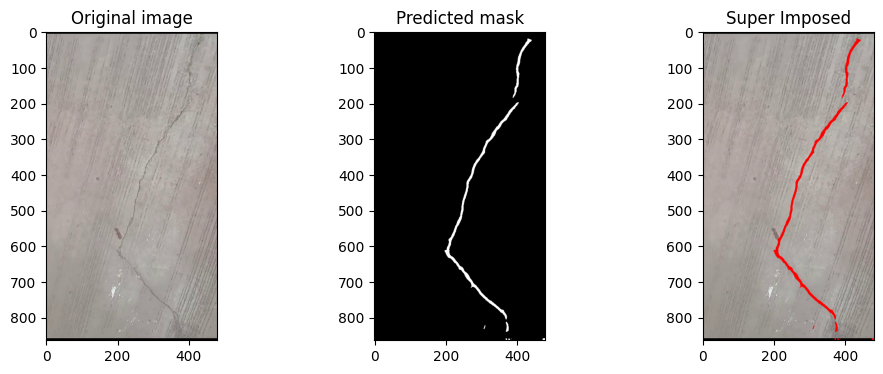

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


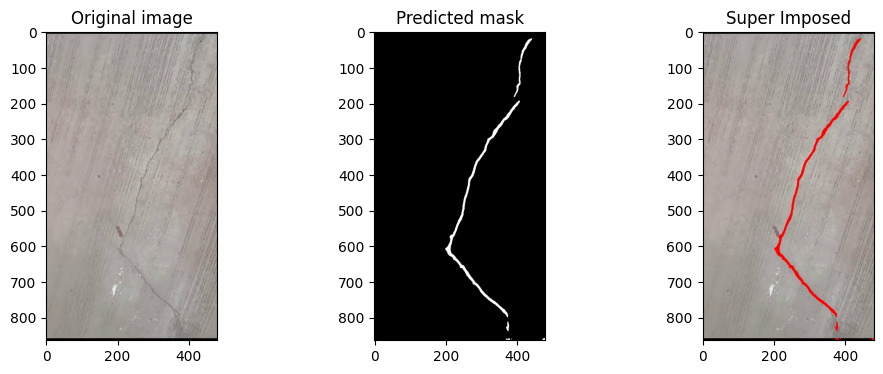

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


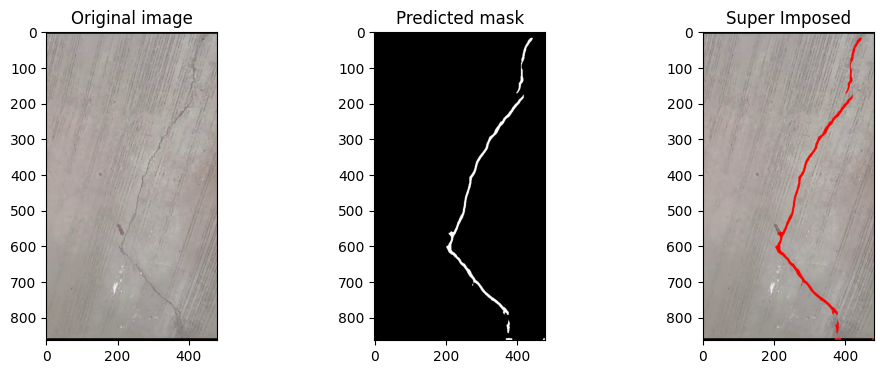

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


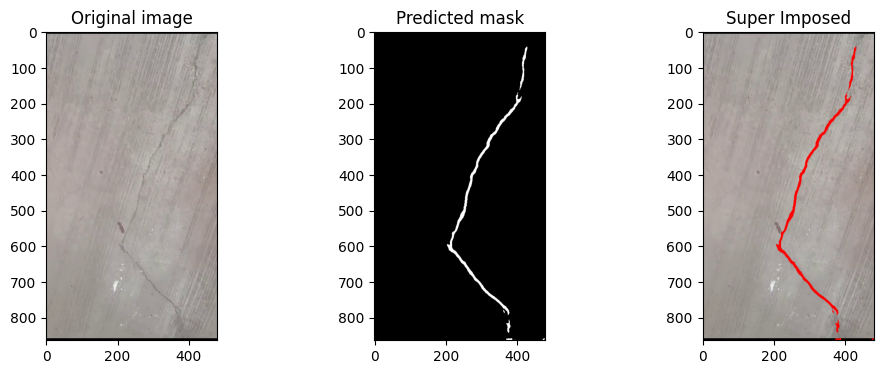

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


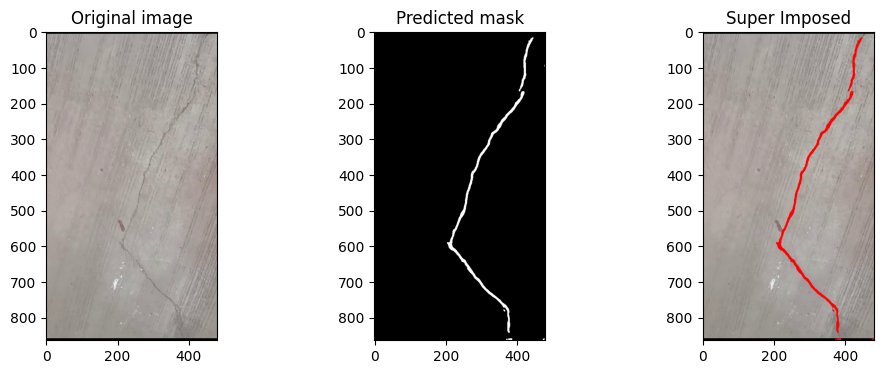

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


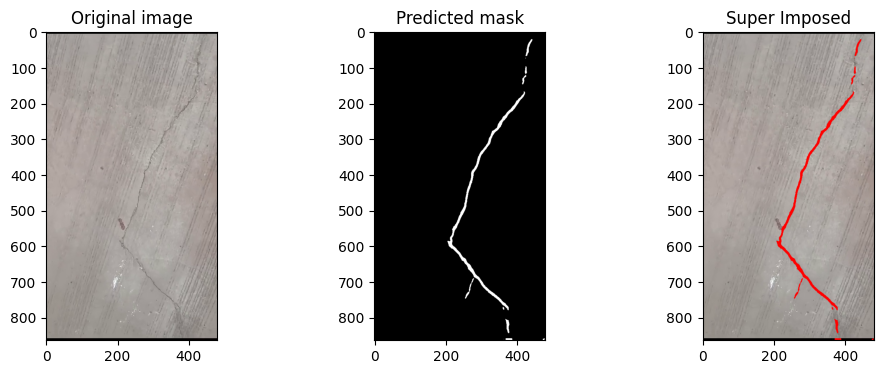

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


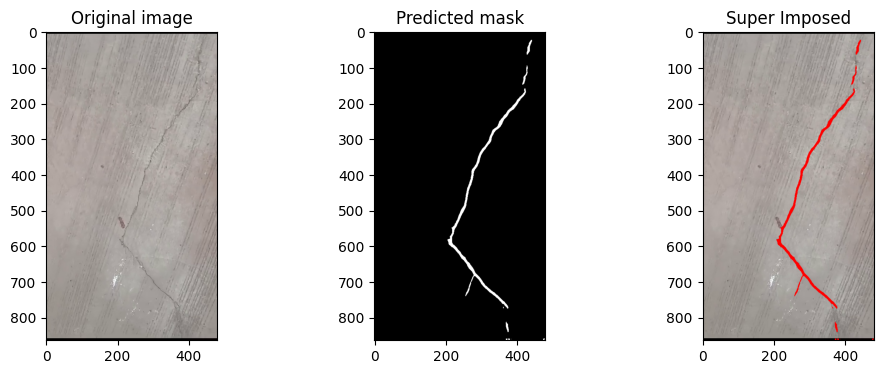

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


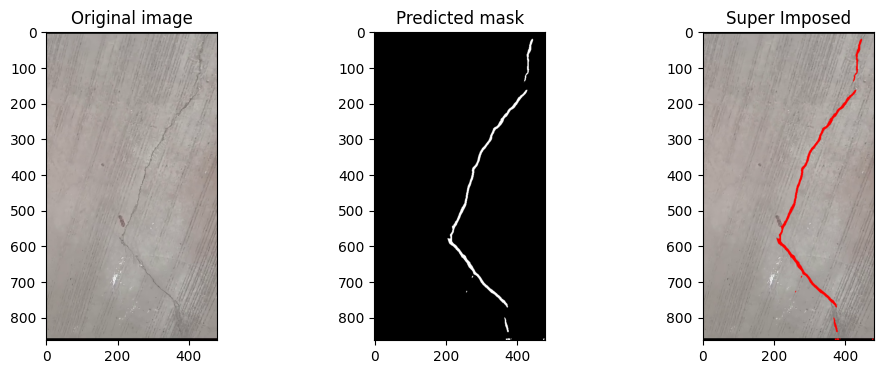

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


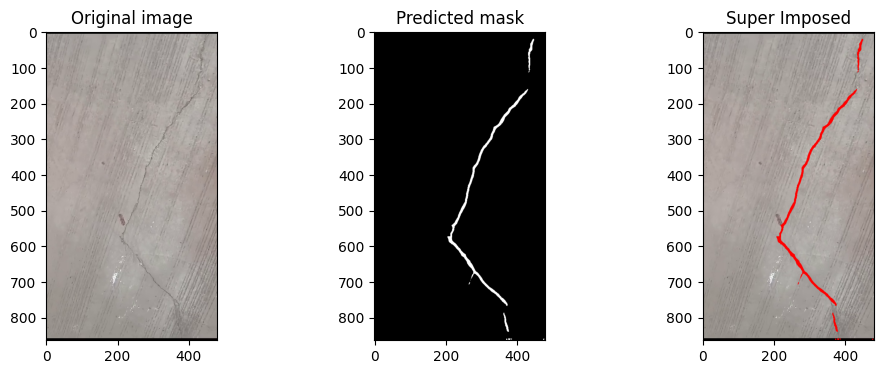

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


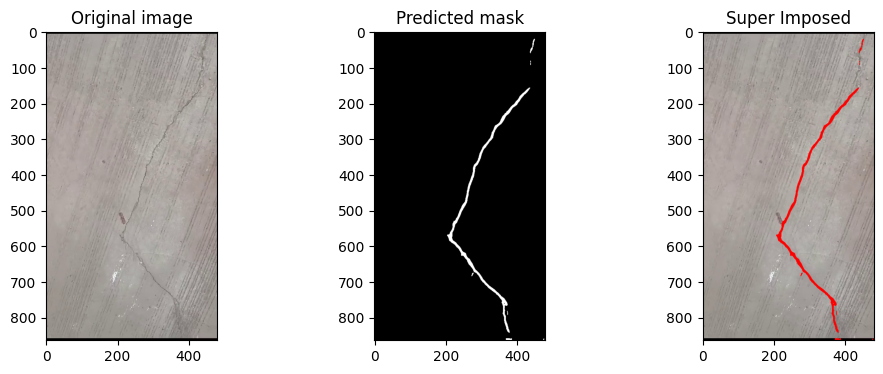

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


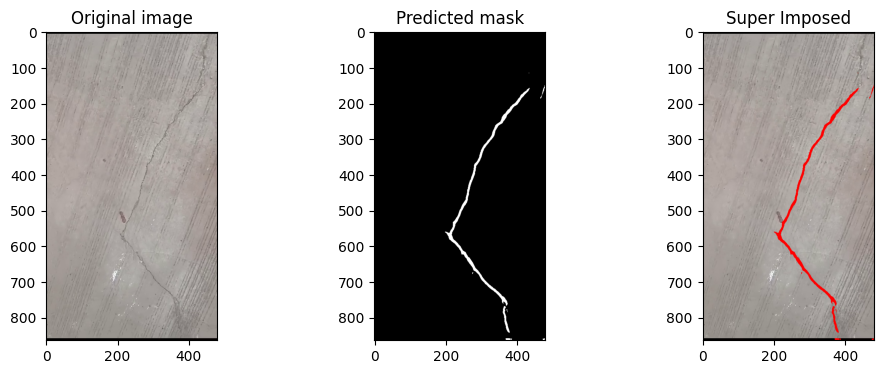

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


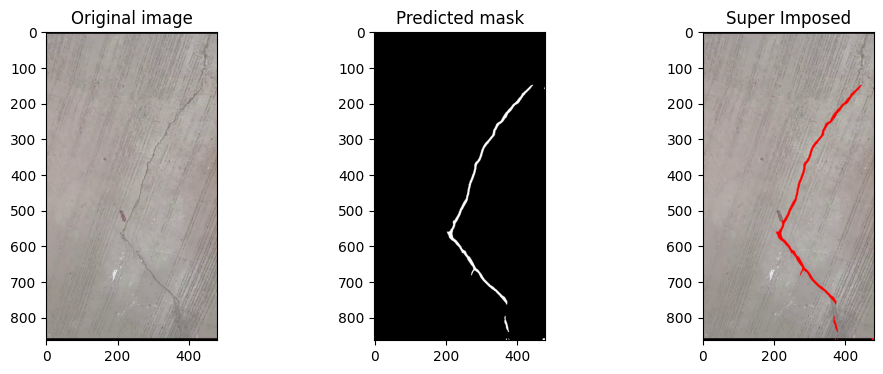

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


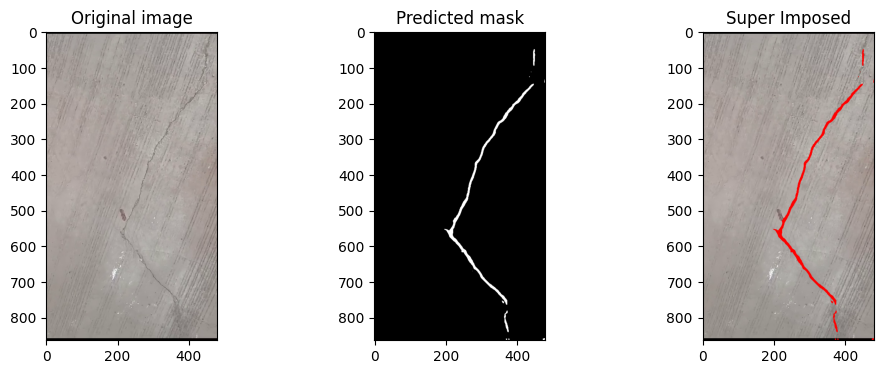

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


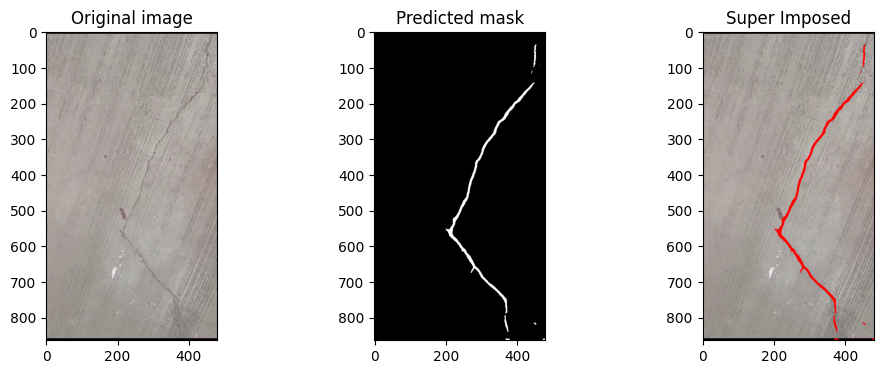

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


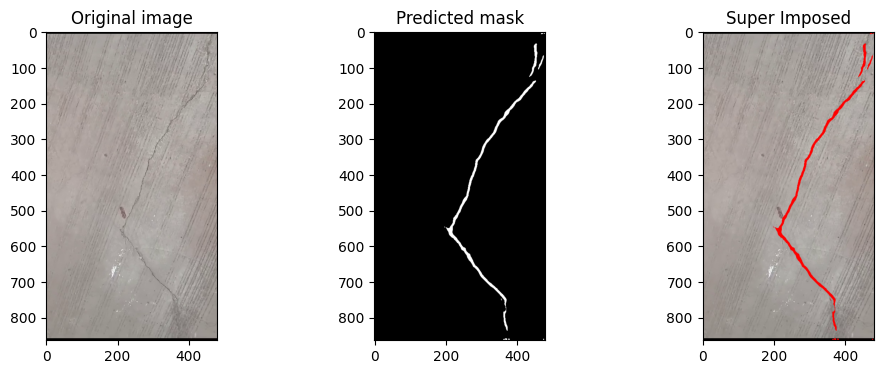

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


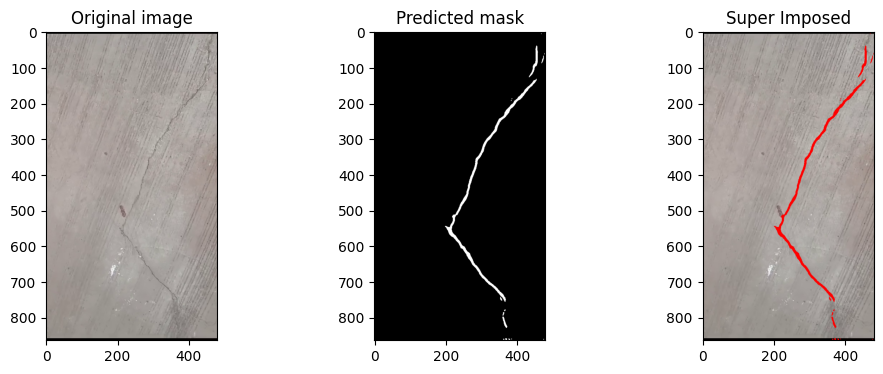

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


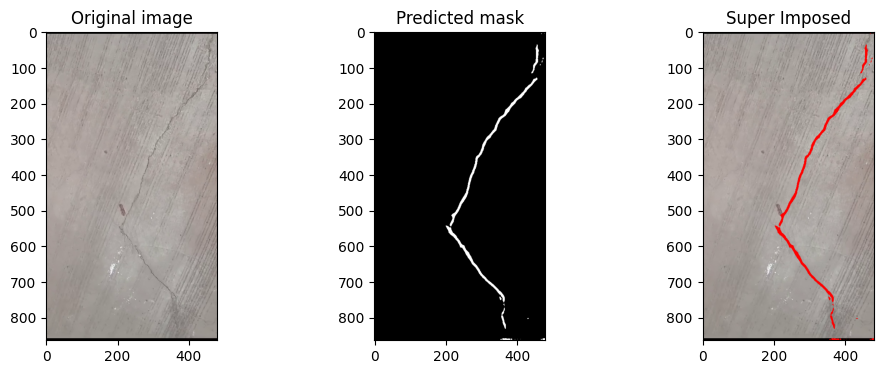

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


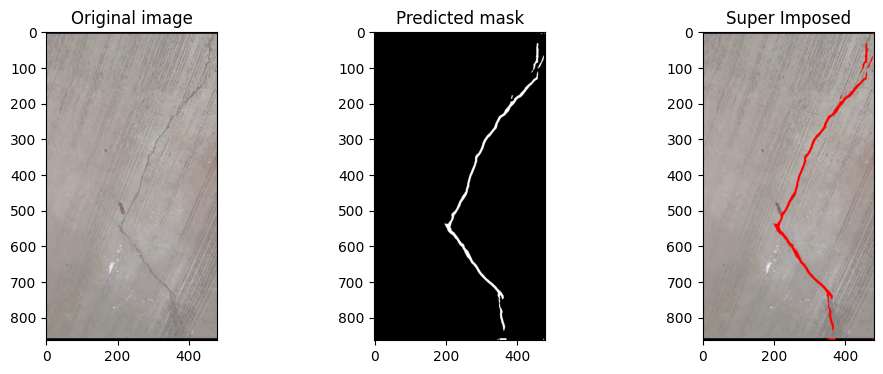

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


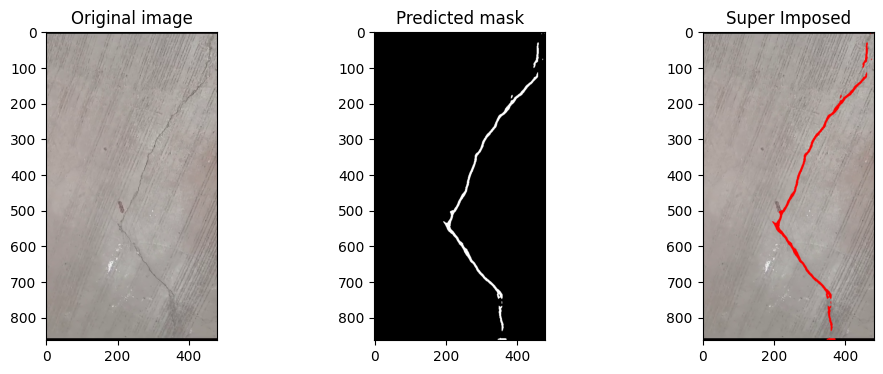

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


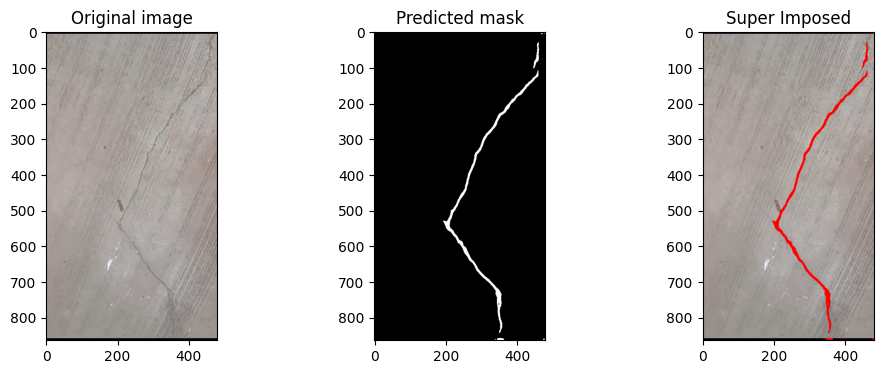

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


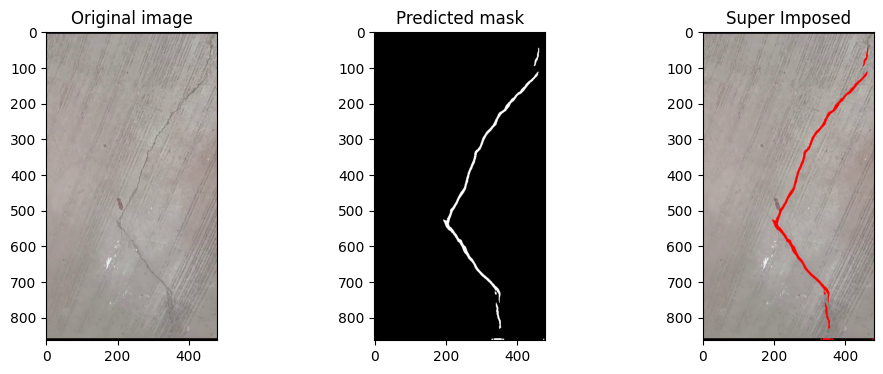

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


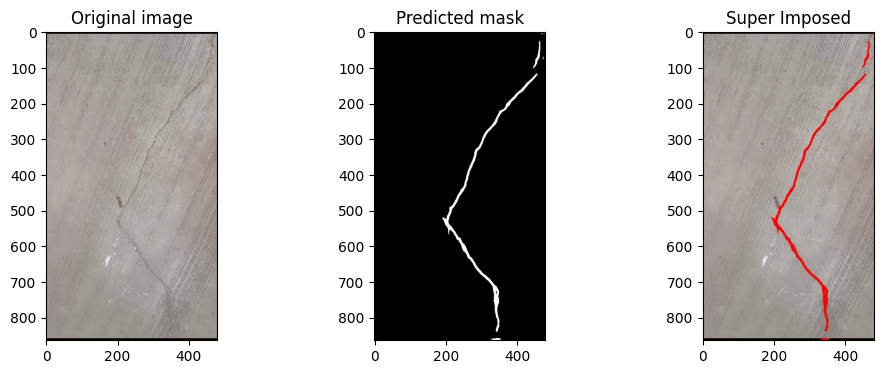

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


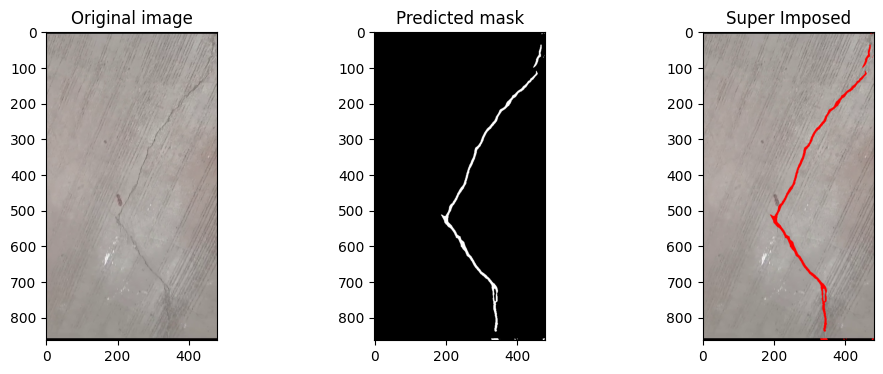

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


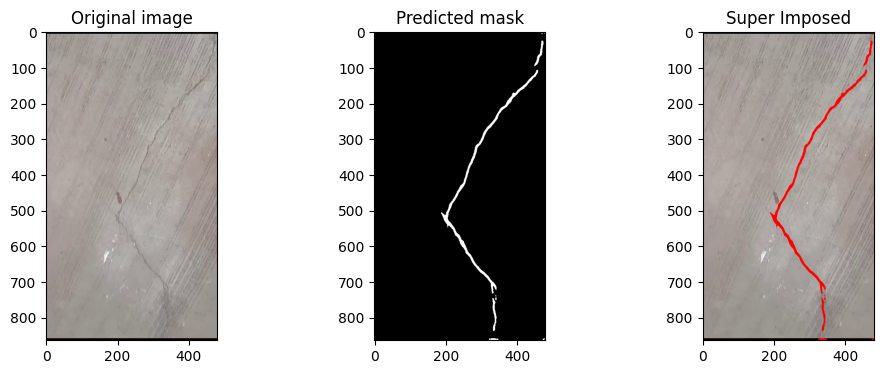

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


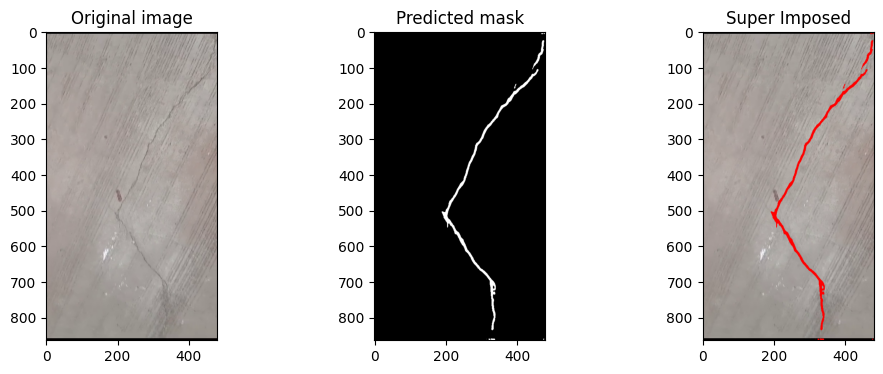

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


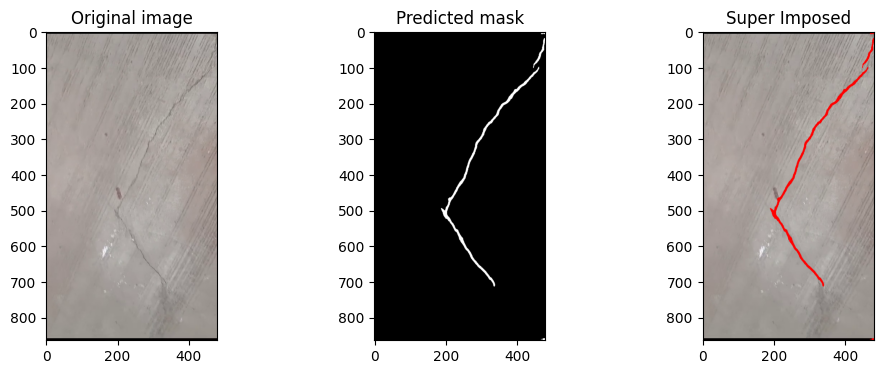

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


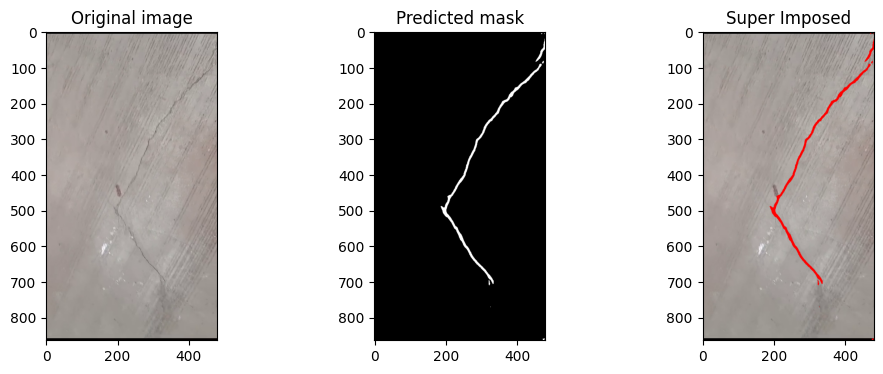

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


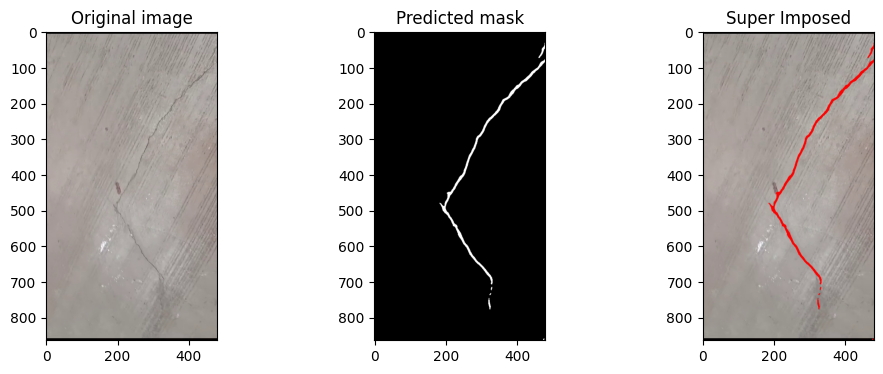

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


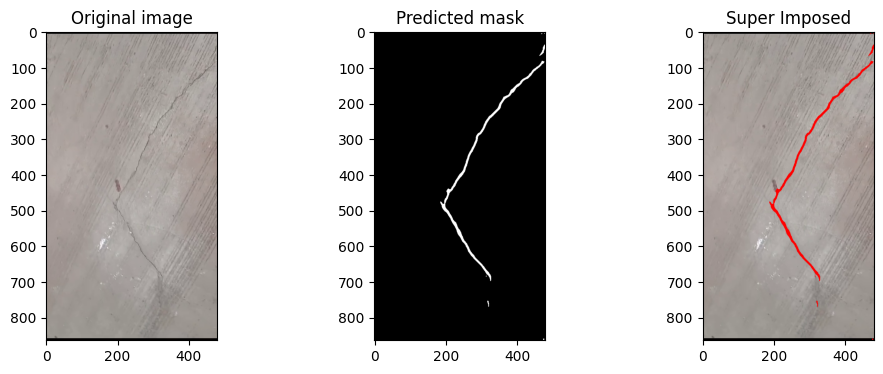

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


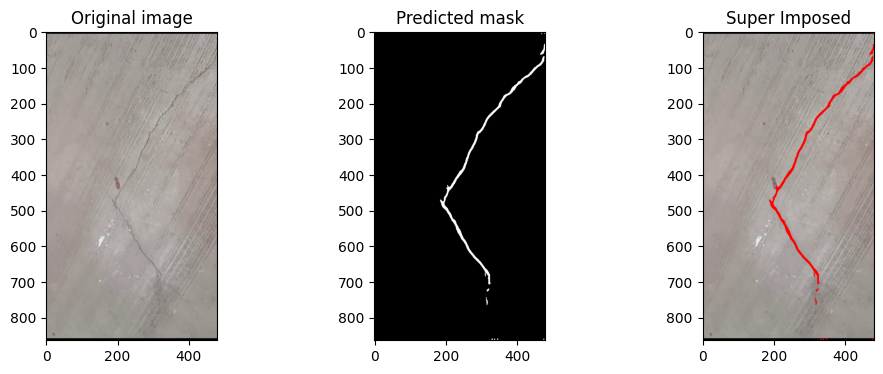

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


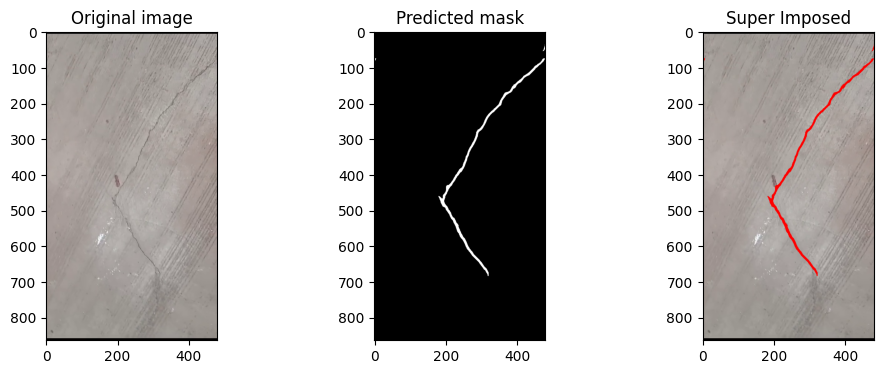

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


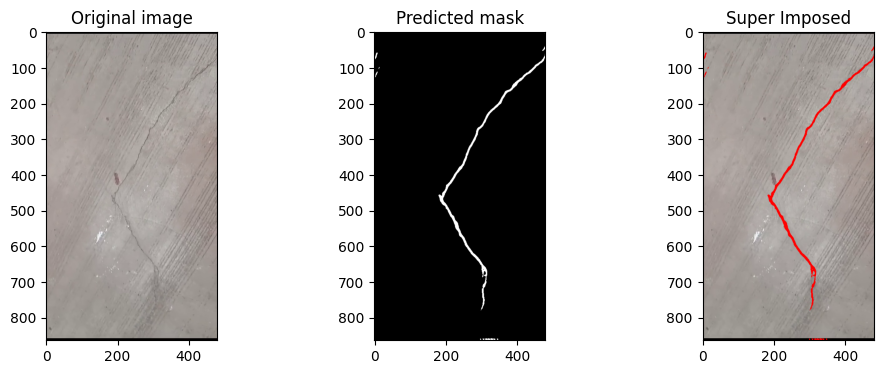

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


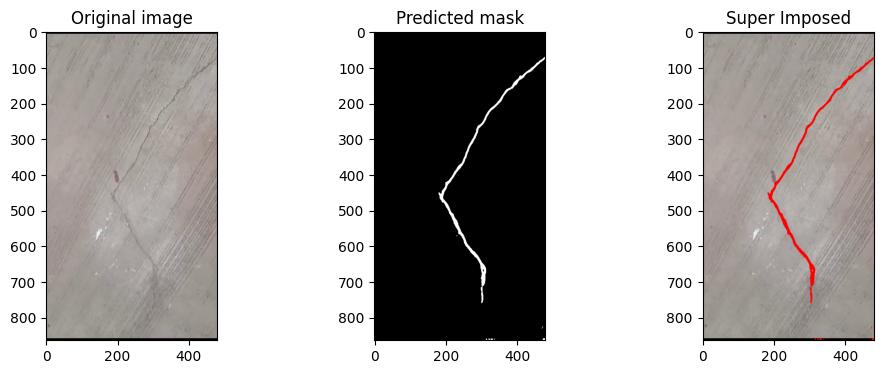

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


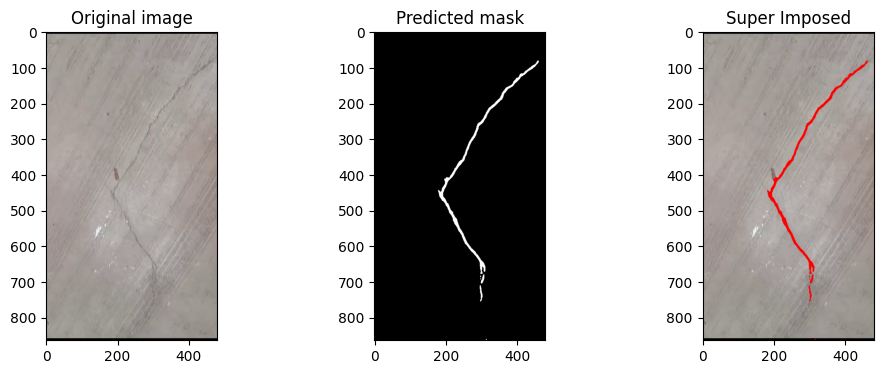

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


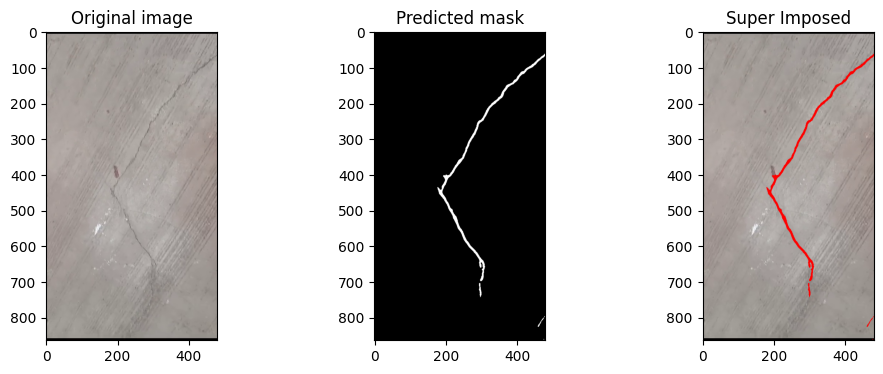

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


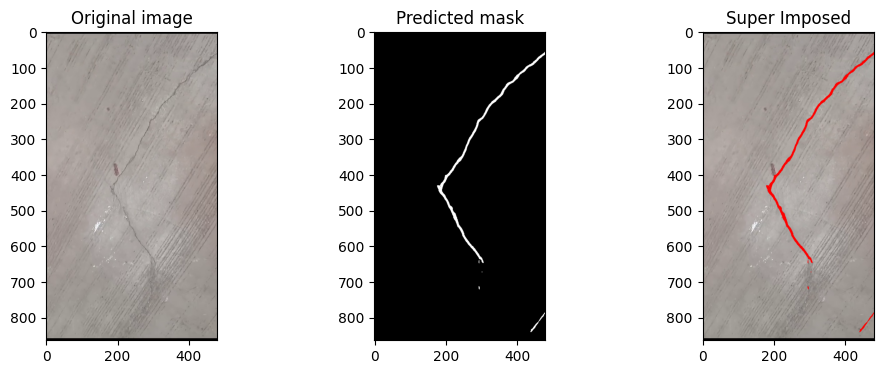

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


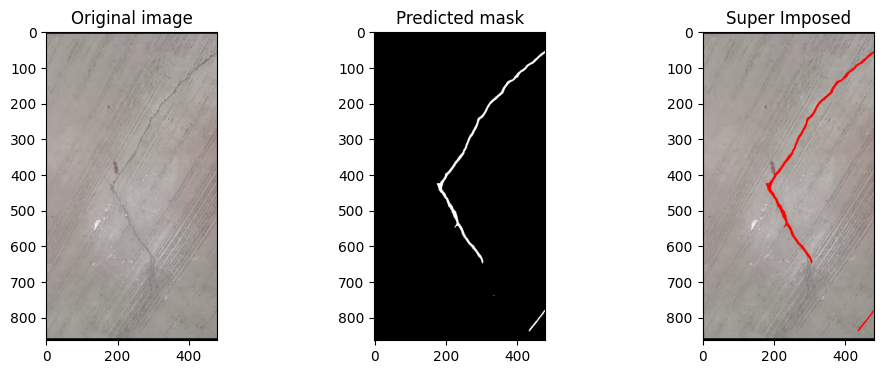

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


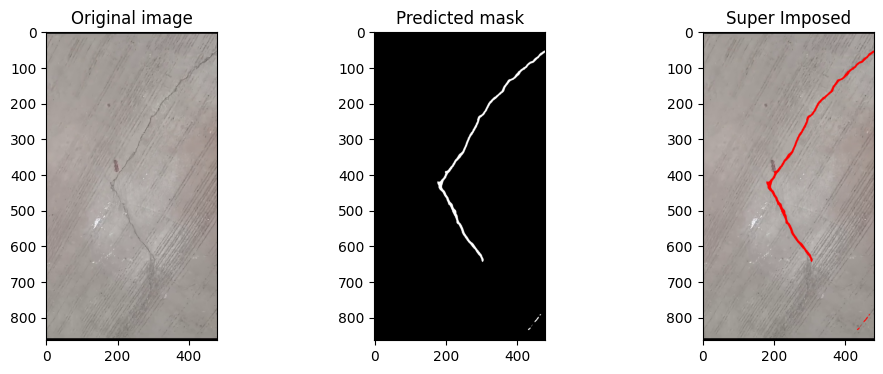

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


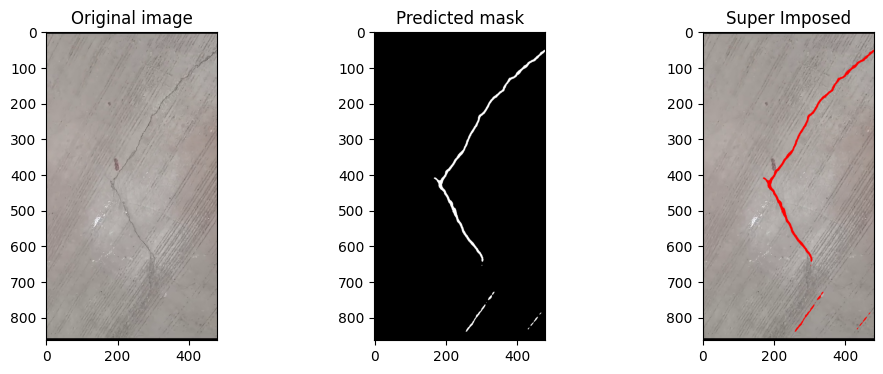

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


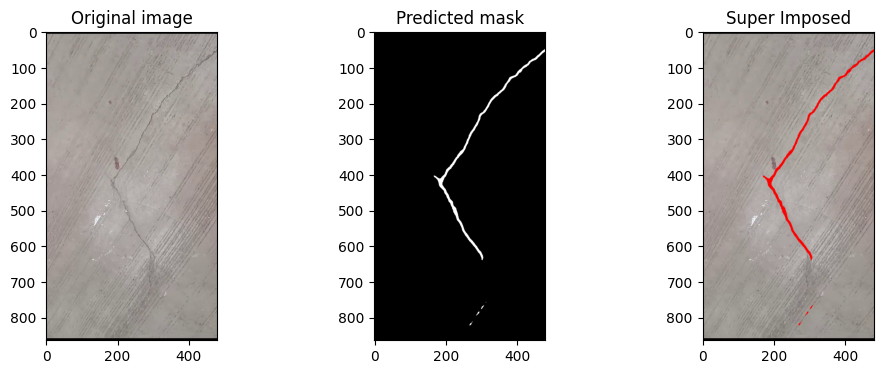

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


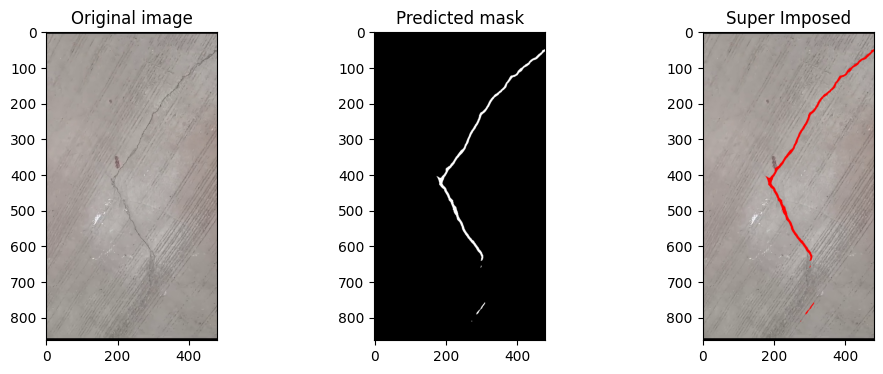

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


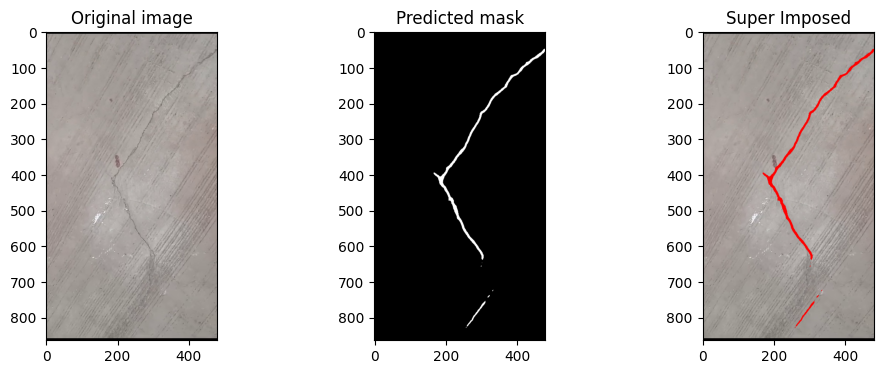

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


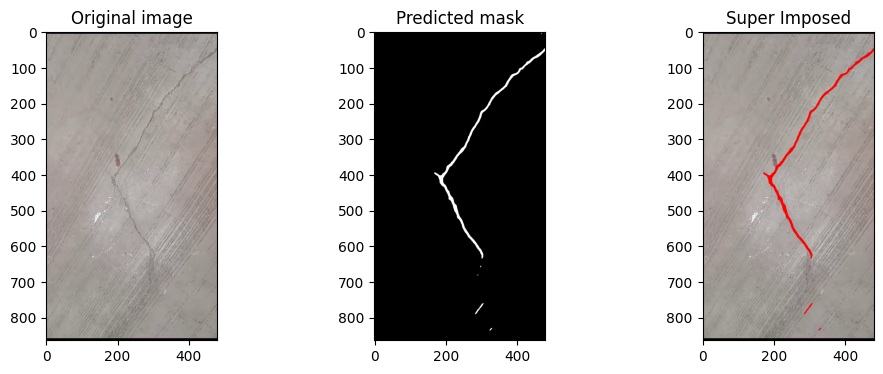

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


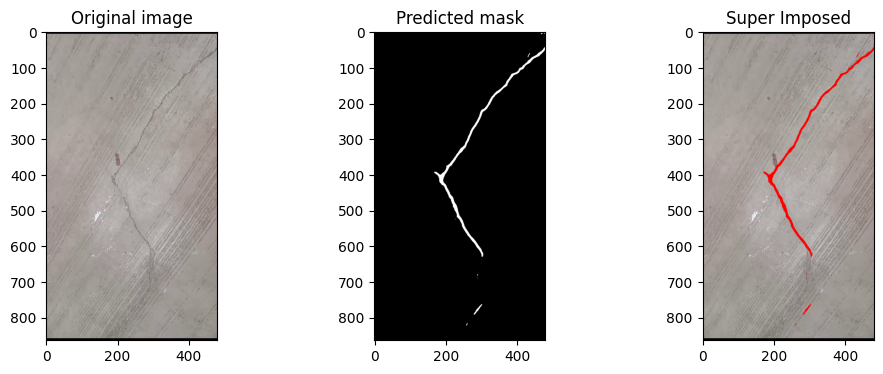

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


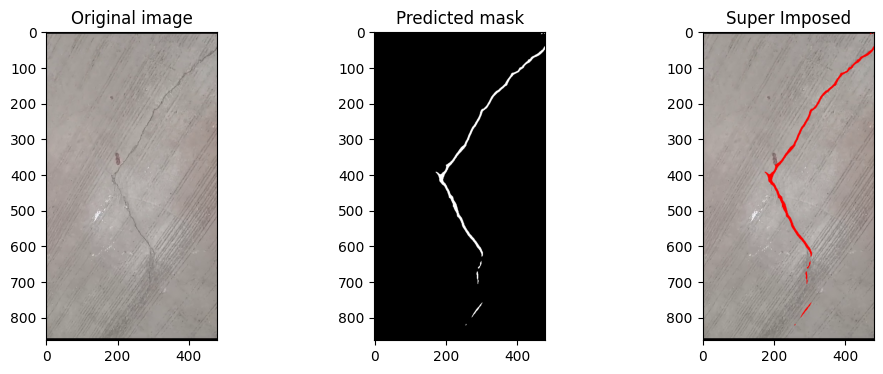

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


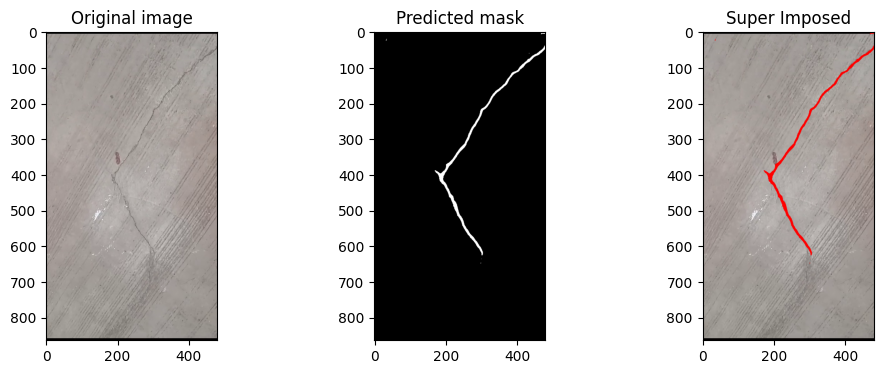

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


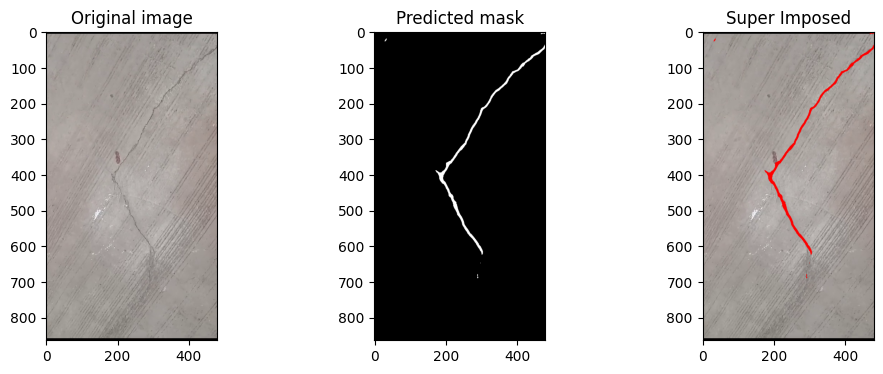

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


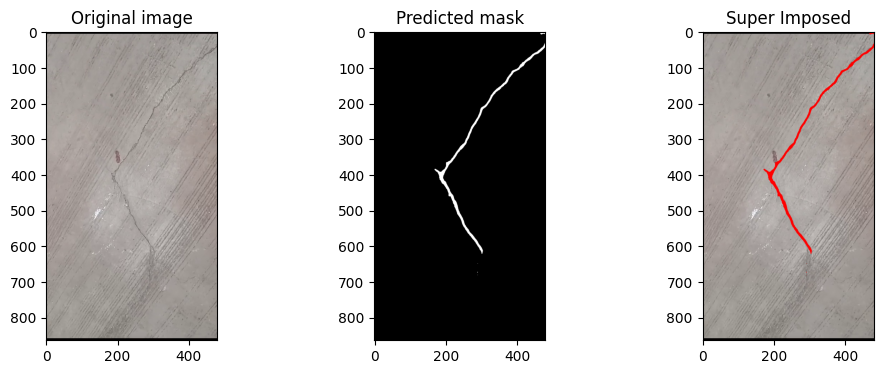

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


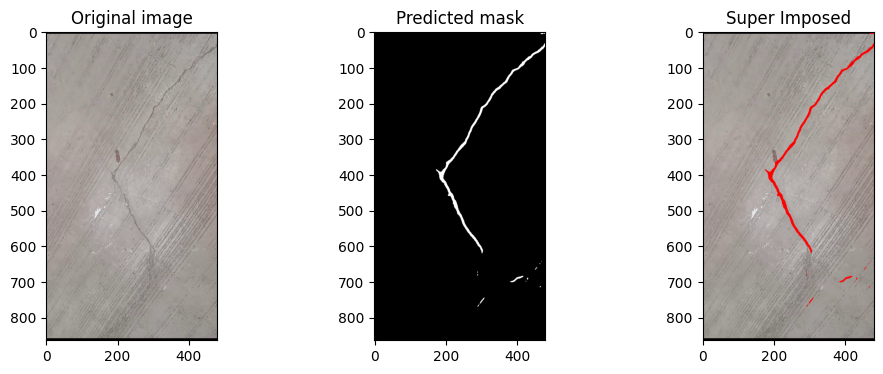

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


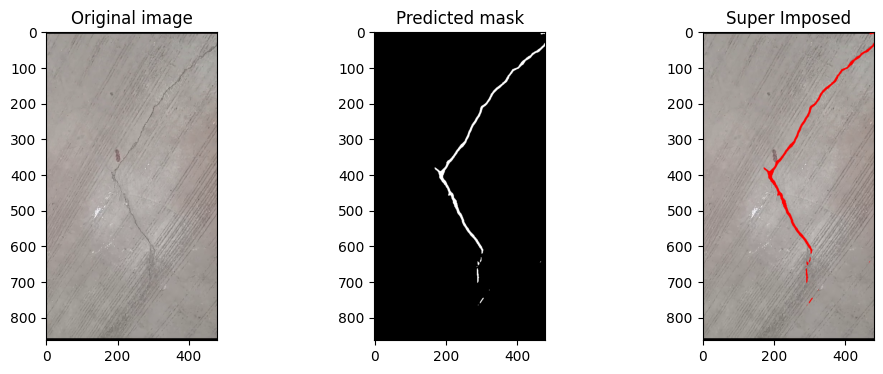

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


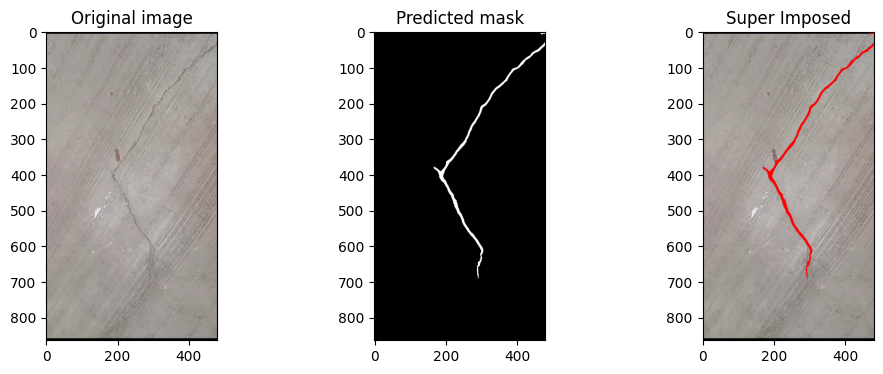

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


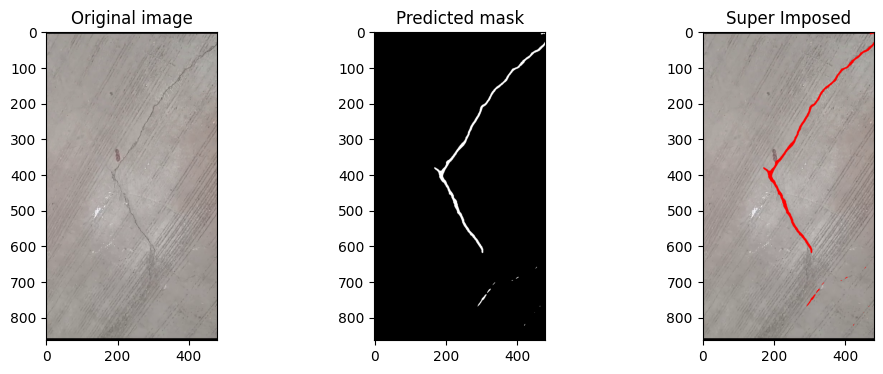

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


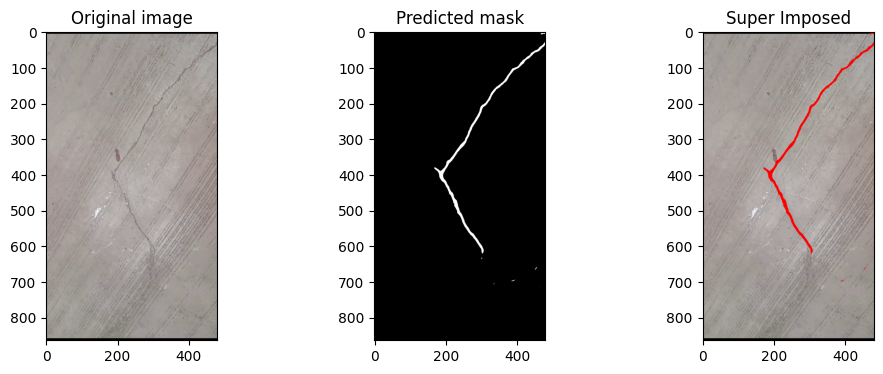

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


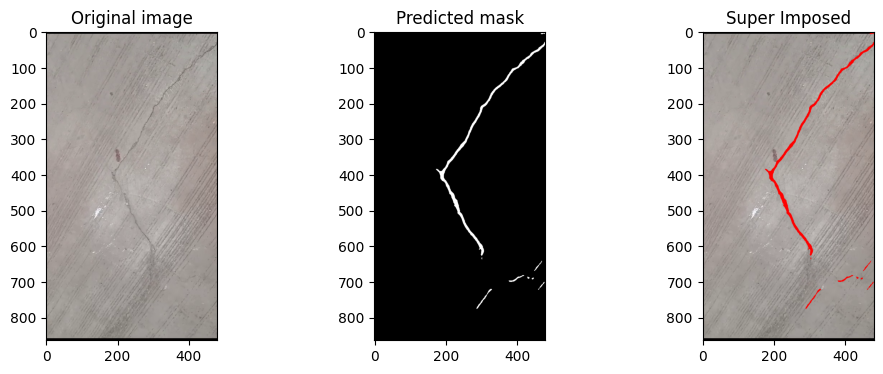

torch.Size([1, 3, 864, 480])
Result_frame (864, 480, 3)


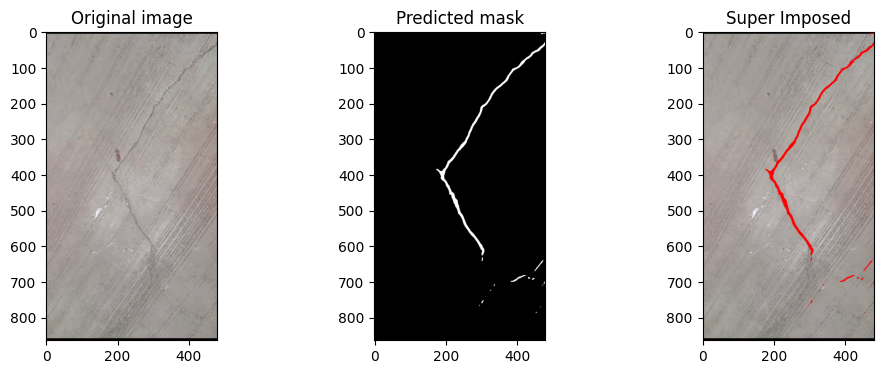

frames execution completed


In [12]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import copy
# Load the video file
device=get_device()
video_path = 'test_crack.mp4'
cap = cv2.VideoCapture(video_path)

#  threshold used for the detection

threshold=0.6

# Get video properties
fps = int(cap.get(cv2.CAP_PROP_FPS))
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

# Create VideoWriter to save the output video
out = cv2.VideoWriter('output_video.mp4', cv2.VideoWriter_fourcc(*'mp4v'), fps, (width, height))

# Check if VideoWriter is initialized successfully
if not out.isOpened():
    print("Error: Could not open the VideoWriter.")
    exit()

# Process each frame
print("Frames Executing:")
while True:

    ret, frame = cap.read()

    if not ret:
        break
    # Make prediction using the model
    to_tensor=ImgToTensor()


    frame_copy=to_tensor(frame)
    frame_copy=frame_copy.unsqueeze(0).to(device,dtype=torch.float32)
    print(frame_copy.shape)
    mask = torch.sigmoid(model_dplinknet(frame_copy))

    mask= (mask>threshold).float()
    mask=mask.cpu().detach().numpy()[0,0]
    mask=mask.astype(np.uint8)

    # Highlight the mask on the original frame
    result_frame = frame.copy()
    print("Result_frame",result_frame.shape)
    result_frame[mask > 0] = [0, 0, 255]  # Highlight in red

    # Display the result using matplotlib
    plt.figure(figsize=(12, 4))

    plt.subplot(131)
    plt.title('Original image')

    plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB for matplotlib

    plt.subplot(132)
    plt.title('Predicted mask')
    plt.imshow(mask,cmap='gray')

    plt.subplot(133)
    plt.title("Super Imposed")
    
    plt.imshow(cv2.cvtColor(result_frame,cv2.COLOR_BGR2RGB,))

    plt.show()


    # Write the frame to the output video
    out.write(result_frame)

    # Press 'q' to exit the video
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release resources
cap.release()
out.release()
# cv2.destroyAllWindows()

print('frames execution completed')

In [ ]:

# start=time.time()
# image_path='big_image3.jpg'
# crack_pred(image_path,'best_dp_bam.pth',model_dplinknet)
# end_time=time.time()
# elapsed_time_linknet=end_time -start